# test10 Otsu 2 classes color background

In [1]:
import keras
import tensorflow as tf
from keras import layers
from keras import ops

import os
import numpy as np
from glob import glob
import cv2
from scipy.io import loadmat
import matplotlib.pyplot as plt

# For data preprocessing
from tensorflow import image as tf_image
from tensorflow import data as tf_data
from tensorflow import io as tf_io

# Creating Dataset

In [3]:
CLASSES = [
    'фон',
    'яблоко',
    'цветок'
]

colormap = [
    [0, 0, 0],
    [212, 6, 99],
    [121, 133, 255]
]


IMAGE_SIZE = 512
BATCH_SIZE = 4
NUM_CLASSES = len(CLASSES)
DATA_DIR = "C:/Users/iraor/PycharmProjects/FusionBrainGen/join_classes_otsu_color"
NUM_TRAIN_IMAGES = 2334
NUM_VAL_IMAGES = 666
NUM_TEST_IMAGES = 333

train_images = sorted(glob(os.path.join(DATA_DIR, "original/*")))[:NUM_TRAIN_IMAGES]
train_masks = sorted(glob(os.path.join(DATA_DIR, "mask/*")))[:NUM_TRAIN_IMAGES]
val_images = sorted(glob(os.path.join(DATA_DIR, "original/*")))[NUM_TRAIN_IMAGES : NUM_VAL_IMAGES + NUM_TRAIN_IMAGES]
val_masks = sorted(glob(os.path.join(DATA_DIR, "mask/*")))[NUM_TRAIN_IMAGES : NUM_VAL_IMAGES + NUM_TRAIN_IMAGES]
test_images = sorted(glob(os.path.join(DATA_DIR, "original/*")))[NUM_VAL_IMAGES + NUM_TRAIN_IMAGES : NUM_TEST_IMAGES + NUM_VAL_IMAGES + NUM_TRAIN_IMAGES]
test_masks = sorted(glob(os.path.join(DATA_DIR, "mask/*")))[NUM_VAL_IMAGES + NUM_TRAIN_IMAGES : NUM_TEST_IMAGES + NUM_VAL_IMAGES + NUM_TRAIN_IMAGES]


def read_image(image_path, mask=False):
    image = tf_io.read_file(image_path)
    if mask:
        image = tf_image.decode_png(image, channels=1)
        image.set_shape([None, None, 1])
        image = tf_image.resize(images=image, size=[IMAGE_SIZE, IMAGE_SIZE])
    else:
        image = tf_image.decode_png(image, channels=3)
        image.set_shape([None, None, 3])
        image = tf_image.resize(images=image, size=[IMAGE_SIZE, IMAGE_SIZE])
    return image


def load_data(image_list, mask_list):
    image = read_image(image_list)
    mask = read_image(mask_list, mask=True)
    return image, mask


def data_generator(image_list, mask_list):
    dataset = tf_data.Dataset.from_tensor_slices((image_list, mask_list))
    dataset = dataset.map(load_data, num_parallel_calls=tf_data.AUTOTUNE)
    dataset = dataset.batch(BATCH_SIZE, drop_remainder=True)
    return dataset


train_dataset = data_generator(train_images, train_masks)
val_dataset = data_generator(val_images, val_masks)

print("Train Dataset:", train_dataset)
print("Val Dataset:", val_dataset)

Train Dataset: <_BatchDataset element_spec=(TensorSpec(shape=(4, 512, 512, 3), dtype=tf.float32, name=None), TensorSpec(shape=(4, 512, 512, 1), dtype=tf.float32, name=None))>
Val Dataset: <_BatchDataset element_spec=(TensorSpec(shape=(4, 512, 512, 3), dtype=tf.float32, name=None), TensorSpec(shape=(4, 512, 512, 1), dtype=tf.float32, name=None))>


# Building the DeepLabV3+ model

In [4]:

def convolution_block(
    block_input,
    num_filters=256,
    kernel_size=3,
    dilation_rate=1,
    use_bias=False,
):
    x = layers.Conv2D(
        num_filters,
        kernel_size=kernel_size,
        dilation_rate=dilation_rate,
        padding="same",
        use_bias=use_bias,
        kernel_initializer=keras.initializers.HeNormal(),
    )(block_input)
    x = layers.BatchNormalization()(x)
    return ops.nn.relu(x)


def DilatedSpatialPyramidPooling(dspp_input):
    dims = dspp_input.shape
    x = layers.AveragePooling2D(pool_size=(dims[-3], dims[-2]))(dspp_input)
    x = convolution_block(x, kernel_size=1, use_bias=True)
    out_pool = layers.UpSampling2D(
        size=(dims[-3] // x.shape[1], dims[-2] // x.shape[2]),
        interpolation="bilinear",
    )(x)

    out_1 = convolution_block(dspp_input, kernel_size=1, dilation_rate=1)
    out_6 = convolution_block(dspp_input, kernel_size=3, dilation_rate=6)
    out_12 = convolution_block(dspp_input, kernel_size=3, dilation_rate=12)
    out_18 = convolution_block(dspp_input, kernel_size=3, dilation_rate=18)

    x = layers.Concatenate(axis=-1)([out_pool, out_1, out_6, out_12, out_18])
    output = convolution_block(x, kernel_size=1)
    return output


In [5]:

def DeeplabV3Plus(image_size, num_classes):
    model_input = keras.Input(shape=(image_size, image_size, 3))
    preprocessed = keras.applications.resnet50.preprocess_input(model_input)
    resnet50 = keras.applications.ResNet50(
        weights="imagenet", include_top=False, input_tensor=preprocessed
    )
    x = resnet50.get_layer("conv4_block6_2_relu").output
    x = DilatedSpatialPyramidPooling(x)

    input_a = layers.UpSampling2D(
        size=(image_size // 4 // x.shape[1], image_size // 4 // x.shape[2]),
        interpolation="bilinear",
    )(x)
    input_b = resnet50.get_layer("conv2_block3_2_relu").output
    input_b = convolution_block(input_b, num_filters=48, kernel_size=1)

    x = layers.Concatenate(axis=-1)([input_a, input_b])
    x = convolution_block(x)
    x = convolution_block(x)
    x = layers.UpSampling2D(
        size=(image_size // x.shape[1], image_size // x.shape[2]),
        interpolation="bilinear",
    )(x)
    model_output = layers.Conv2D(num_classes, kernel_size=(1, 1), padding="same")(x)
    return keras.Model(inputs=model_input, outputs=model_output)


model = DeeplabV3Plus(image_size=IMAGE_SIZE, num_classes=NUM_CLASSES)
model.summary()

Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                  ┃ Output Shape              ┃     Param # ┃ Connected to                   ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)      │ (None, 512, 512, 3)       │           0 │ -                              │
├───────────────────────────────┼───────────────────────────┼─────────────┼────────────────────────────────┤
│ get_item (GetItem)            │ (None, 512, 512)          │           0 │ input_layer[0][0]              │
├───────────────────────────────┼───────────────────────────┼─────────────┼────────────────────────────────┤
│ get_item_1 (GetItem)          │ (None, 512, 512)          │           0 │ input_layer[0][0]              │
├───────────────────────────────┼───────────────────────────┼─────────────┼────────────────────────────────┤
│ get_item_2 (GetItem)          │ (None, 512, 512)          │           0 │ input_layer[0][0]              │
├───────────────────────────────┼───────────────────────────┼─────────────┼────────────────────────────────┤
│ stack (Stack)                 │ (None, 512, 512, 3)       │           0 │ get_item[0][0],                │
│                               │                           │             │ get_item_1[0][0],              │
│                               │                           │             │ get_item_2[0][0]               │
├───────────────────────────────┼───────────────────────────┼─────────────┼────────────────────────────────┤
│ add (Add)                     │ (None, 512, 512, 3)       │           0 │ stack[0][0]                    │
├───────────────────────────────┼───────────────────────────┼─────────────┼────────────────────────────────┤
│ conv1_pad (ZeroPadding2D)     │ (None, 518, 518, 3)       │           0 │ add[0][0]                      │
├───────────────────────────────┼───────────────────────────┼─────────────┼────────────────────────────────┤
│ conv1_conv (Conv2D)           │ (None, 256, 256, 64)      │       9,472 │ conv1_pad[0][0]                │
├───────────────────────────────┼───────────────────────────┼─────────────┼────────────────────────────────┤
│ conv1_bn (BatchNormalization) │ (None, 256, 256, 64)      │         256 │ conv1_conv[0][0]               │
├───────────────────────────────┼───────────────────────────┼─────────────┼────────────────────────────────┤
│ conv1_relu (Activation)       │ (None, 256, 256, 64)      │           0 │ conv1_bn[0][0]                 │
├───────────────────────────────┼───────────────────────────┼─────────────┼────────────────────────────────┤
│ pool1_pad (ZeroPadding2D)     │ (None, 258, 258, 64)      │           0 │ conv1_relu[0][0]               │
├───────────────────────────────┼───────────────────────────┼─────────────┼────────────────────────────────┤
│ pool1_pool (MaxPooling2D)     │ (None, 128, 128, 64)      │           0 │ pool1_pad[0][0]                │
├───────────────────────────────┼───────────────────────────┼─────────────┼────────────────────────────────┤
│ conv2_block1_1_conv (Conv2D)  │ (None, 128, 128, 64)      │       4,160 │ pool1_pool[0][0]               │
├───────────────────────────────┼───────────────────────────┼─────────────┼────────────────────────────────┤
│ conv2_block1_1_bn             │ (None, 128, 128, 64)      │         256 │ conv2_block1_1_conv[0][0]      │
│ (BatchNormalization)          │                           │             │                                │
├───────────────────────────────┼───────────────────────────┼─────────────┼────────────────────────────────┤
│ conv2_block1_1_relu           │ (None, 128, 128, 64)      │           0 │ conv2_block1_1_bn[0][0]        │
│ (Activation)                  │                           │             │                                │
├───────────────────────────────┼───────────────────────────┼─────────────┼─

 Total params: 11,852,867 (45.22 MB)

 Trainable params: 11,820,131 (45.09 MB)

 Non-trainable params: 32,736 (127.88 KB)

# Training

In [6]:
class UpdatedIoU(tf.keras.metrics.IoU):
  def __init__(self,
               y_true=None,
               y_pred=None,
               num_classes=None,
               target_class_ids=None,
               name=None,
               dtype=None):
    super(UpdatedIoU, self).__init__(num_classes = num_classes, target_class_ids=target_class_ids, name=name, dtype=dtype)

  def update_state(self, y_true, y_pred, sample_weight=None):
    y_pred = tf.math.argmax(y_pred, axis=-1)
    return super().update_state(y_true, y_pred, sample_weight)

In [7]:
loss = keras.losses.SparseCategoricalCrossentropy(from_logits=True)
model.compile(
    optimizer=keras.optimizers.Adam(learning_rate=0.001),
    loss=loss,
    metrics=["accuracy", 
             UpdatedIoU(num_classes=len(CLASSES), target_class_ids=[0, 1, 2], name='MIoU'),
             UpdatedIoU(num_classes=len(CLASSES), target_class_ids=[0], name=CLASSES[0]),
             UpdatedIoU(num_classes=len(CLASSES), target_class_ids=[1], name=CLASSES[1]),
             UpdatedIoU(num_classes=len(CLASSES), target_class_ids=[2], name=CLASSES[2]),
            ],
)

history = model.fit(train_dataset, validation_data=val_dataset, epochs=5)

Epoch 1/5
583/583 ━━━━━━━━━━━━━━━━━━━━ 7204s 12s/step - MIoU: 0.7543 - accuracy: 0.9225 - loss: 0.2197 - фон: 0.9341 - цветок: 0.6759 - яблоко: 0.6527 - val_MIoU: 0.8203 - val_accuracy: 0.9526 - val_loss: 0.1323 - val_фон: 0.9647 - val_цветок: 0.7549 - val_яблоко: 0.7412
Epoch 2/5
583/583 ━━━━━━━━━━━━━━━━━━━━ 7142s 12s/step - MIoU: 0.9301 - accuracy: 0.9831 - loss: 0.0477 - фон: 0.9872 - цветок: 0.9010 - яблоко: 0.9020 - val_MIoU: 0.9424 - val_accuracy: 0.9858 - val_loss: 0.0406 - val_фон: 0.9884 - val_цветок: 0.9218 - val_яблоко: 0.9170
Epoch 3/5
583/583 ━━━━━━━━━━━━━━━━━━━━ 7112s 12s/step - MIoU: 0.9447 - accuracy: 0.9868 - loss: 0.0366 - фон: 0.9903 - цветок: 0.9217 - яблоко: 0.9220 - val_MIoU: 0.9026 - val_accuracy: 0.9746 - val_loss: 0.0748 - val_фон: 0.9777 - val_цветок: 0.8634 - val_яблоко: 0.8668
Epoch 4/5
583/583 ━━━━━━━━━━━━━━━━━━━━ 7104s 12s/step - MIoU: 0.9571 - accuracy: 0.9897 - loss: 0.0281 - фон: 0.9918 - цветок: 0.9385 - яблоко: 0.9409 - val_MIoU: 0.9434 - val_accuracy

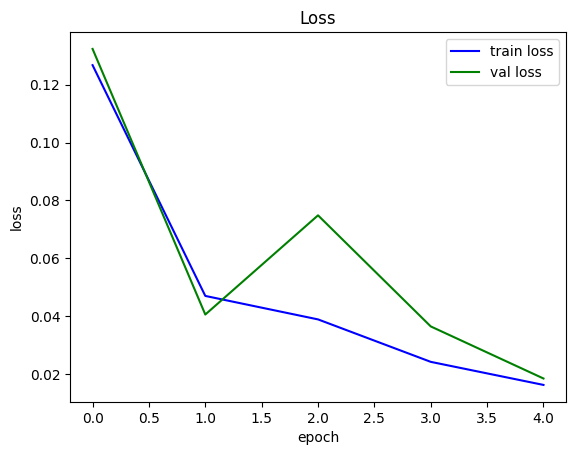

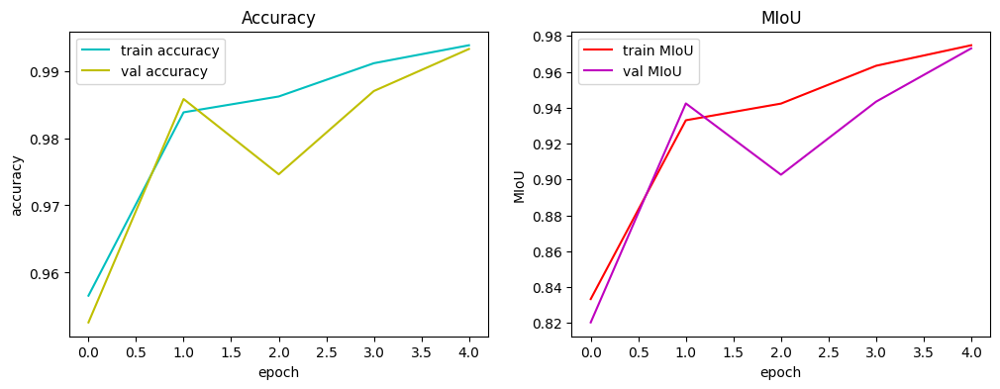

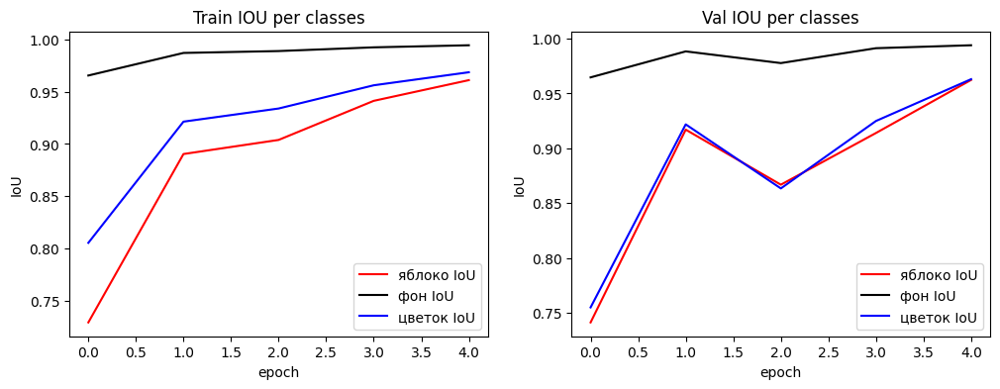

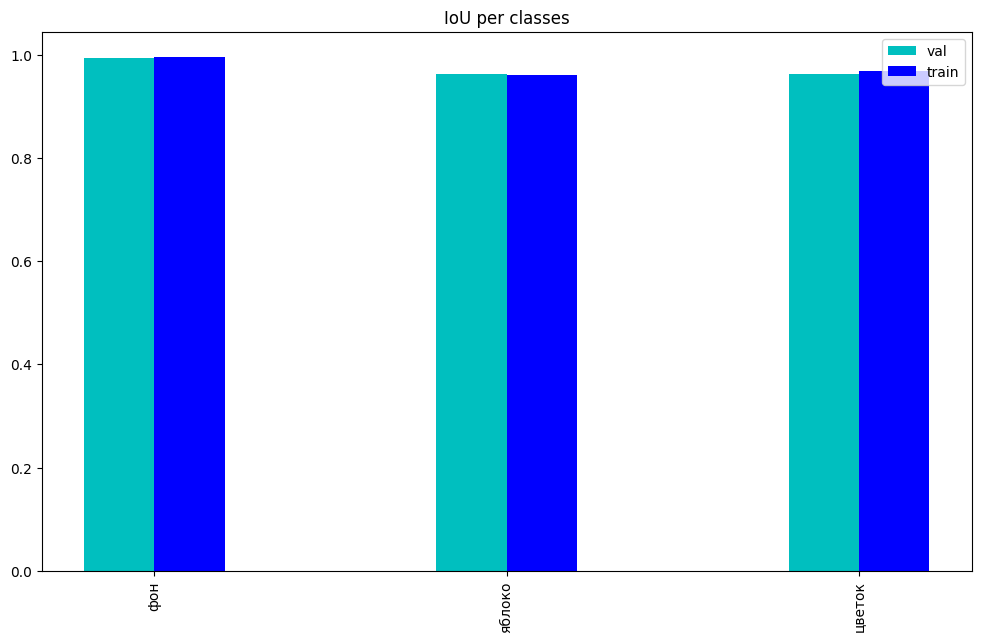

In [8]:
plt.plot(history.history["loss"], label = 'train loss', color = 'b')
plt.plot(history.history["val_loss"], label = 'val loss', color = 'g')
plt.title("Loss")
plt.ylabel("loss")
plt.xlabel("epoch")
plt.legend()
plt.show()


fig, axs = plt.subplots(1, 2, figsize=(12, 4))
axs[0].plot(history.history["accuracy"], label = 'train accuracy', color = 'c')
axs[0].plot(history.history["val_accuracy"], label = 'val accuracy', color = 'y')
axs[0].set_title("Accuracy")
axs[0].set_ylabel("accuracy")
axs[0].set_xlabel("epoch")
axs[0].legend()
axs[1].plot(history.history["MIoU"], label = 'train MIoU', color = 'r')
axs[1].plot(history.history["val_MIoU"], label = 'val MIoU', color = 'm')
axs[1].set_title("MIoU")
axs[1].set_ylabel("MIoU")
axs[1].set_xlabel("epoch")
axs[1].legend()
plt.show()

fig, axs = plt.subplots(1, 2, figsize=(12, 4))
axs[0].plot(history.history["яблоко"], label = 'яблоко IoU', color = 'r')
axs[0].plot(history.history["фон"], label = 'фон IoU', color = 'black')
axs[0].plot(history.history["цветок"], label = 'цветок IoU', color = 'b')
axs[0].set_title("Train IOU per classes")
axs[0].set_ylabel("IoU")
axs[0].set_xlabel("epoch")
axs[0].legend()
axs[1].plot(history.history["val_яблоко"], label = 'яблоко IoU', color = 'r')
axs[1].plot(history.history["val_фон"], label = 'фон IoU', color = 'black')
axs[1].plot(history.history["val_цветок"], label = 'цветок IoU', color = 'b')
axs[1].set_title("Val IOU per classes")
axs[1].set_ylabel("IoU")
axs[1].set_xlabel("epoch")
axs[1].legend()
plt.show()

# print(history.history["яблоко"][4])

train_values = [history.history["фон"][4], history.history["яблоко"][4], history.history["цветок"][4]]
val_values = [history.history["val_фон"][4], history.history["val_яблоко"][4], history.history["val_цветок"][4]]
x_axis = np.arange(len(CLASSES))
plt.figure(figsize = (12, 7))
plt.title('IoU per classes')
plt.bar(x_axis-0.1, val_values, width=0.2, color='c', label='val')
plt.bar(x_axis+0.1, train_values, width=0.2, color='b', label='train')
plt.xticks(x_axis, CLASSES, rotation=90)
plt.legend()
plt.show()

# Inference using Colormap Overlay



In [9]:
def infer(model, image_tensor):
    predictions = model.predict(np.expand_dims((image_tensor), axis=0))
    predictions = np.squeeze(predictions)
    predictions = np.argmax(predictions, axis=2)
    return predictions


def decode_segmentation_masks(mask, colormap, n_classes):
    r = np.zeros_like(mask).astype(np.uint8)
    g = np.zeros_like(mask).astype(np.uint8)
    b = np.zeros_like(mask).astype(np.uint8)

    # print(mask[250])

    
    for l in range(0, n_classes):
        idx = mask == l
        r[idx] = colormap[l][0]
        g[idx] = colormap[l][1]
        b[idx] = colormap[l][2]
    rgb = np.stack([r, g, b], axis=2)
    return rgb


def get_overlay(image, colored_mask):
    image = keras.utils.array_to_img(image)
    image = np.array(image).astype(np.uint8)
    overlay = cv2.addWeighted(image, 0.35, colored_mask, 0.65, 0)
    return overlay


def plot_samples_matplotlib(display_list, figsize=(5, 3)):
    _, axes = plt.subplots(nrows=1, ncols=len(display_list), figsize=figsize)
    for i in range(len(display_list)):
        if display_list[i].shape[-1] == 3:
            axes[i].imshow(keras.utils.array_to_img(display_list[i]))
        else:
            axes[i].imshow(display_list[i])
    plt.show()


def _predictions(images_list, colormap, mod, model):
    for image_file in images_list:
        image_tensor = read_image(image_file)
        prediction_mask = infer(image_tensor=image_tensor, model=model)
        prediction_colormap = decode_segmentation_masks(prediction_mask, colormap, len(CLASSES))

        name = image_file.split("\\")[2]
        if mod == "train":
            if not (os.path.exists("C:/Users/iraor/PycharmProjects/FusionBrainGen/join_classes_otsu_color/train_pred")):
                os.makedirs("C:/Users/iraor/PycharmProjects/FusionBrainGen/join_classes_otsu_color/train_pred")
            path = f"C:/Users/iraor/PycharmProjects/FusionBrainGen/join_classes_otsu_color/train_pred/{name}"
        elif  mod == "val":
            if not (os.path.exists("C:/Users/iraor/PycharmProjects/FusionBrainGen/join_classes_otsu_color/val_pred")):
                os.makedirs("C:/Users/iraor/PycharmProjects/FusionBrainGen/join_classes_otsu_color/val_pred")
            path = f"C:/Users/iraor/PycharmProjects/FusionBrainGen/join_classes_otsu_color/val_pred/{name}"
        else: 
            if not (os.path.exists("C:/Users/iraor/PycharmProjects/FusionBrainGen/join_classes_otsu_color/test_pred")):
                os.makedirs("C:/Users/iraor/PycharmProjects/FusionBrainGen/join_classes_otsu_color/test_pred")
            path = f"C:/Users/iraor/PycharmProjects/FusionBrainGen/join_classes_otsu_color/test_pred/{name}"
        pred_map = cv2.cvtColor(prediction_colormap, cv2.COLOR_BGR2RGB)
        cv2.imwrite(path, pred_map)
            

def plot_predictions(images_list, colormap, mod, model):
    for image_file in images_list:
        image_tensor = read_image(image_file)
        prediction_mask = infer(image_tensor=image_tensor, model=model)
        prediction_colormap = decode_segmentation_masks(prediction_mask, colormap, len(CLASSES))

        # name = image_file.split("\\")[2]
        # if mod == "train":
        #     path = f"C:/Users/iraor/PycharmProjects/FusionBrainGen/join_classes_kmeans_white/train_pred/{name}"
        # elif  mod == "val":
        #     path = f"C:/Users/iraor/PycharmProjects/FusionBrainGen/join_classes_kmeans_white/val_pred/{name}"
        # else: 
        #     path = f"C:/Users/iraor/PycharmProjects/FusionBrainGen/join_classes_kmeans_white/test_pred/{name}"
        # pred_map = cv2.cvtColor(prediction_colormap, cv2.COLOR_BGR2RGB)
        # cv2.imwrite(path, pred_map)
            
        overlay = get_overlay(image_tensor, prediction_colormap)
        plot_samples_matplotlib(
            [image_tensor, overlay, prediction_colormap], figsize=(18, 14)
        )

## Inference on Train Images

In [10]:
# _predictions(train_images, colormap, "train", model=model)

1/1 ━━━━━━━━━━━━━━━━━━━━ 10s 10s/step


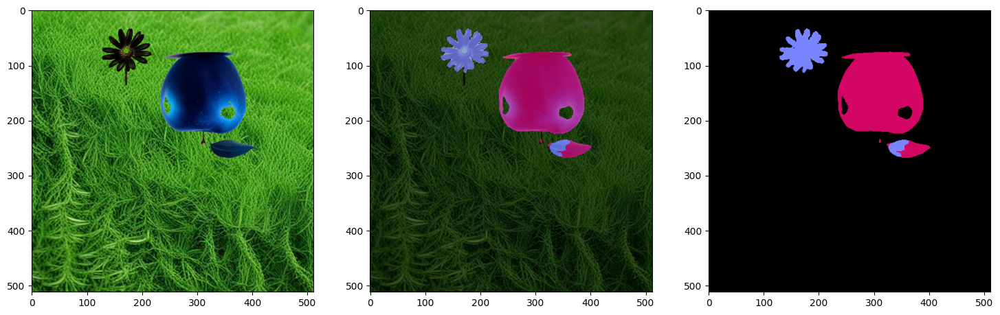

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 529ms/step


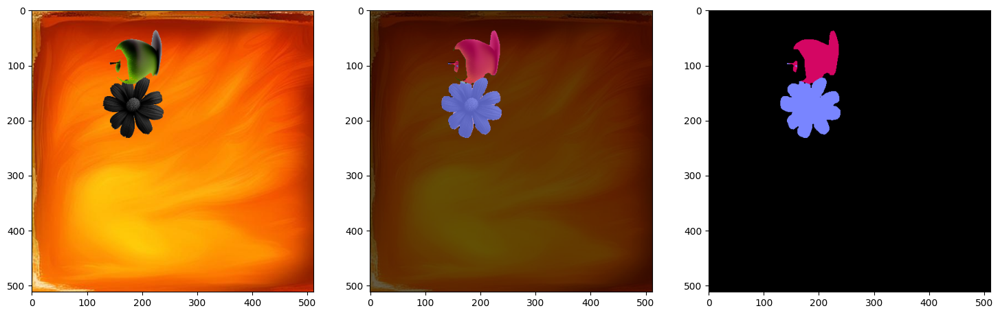

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 502ms/step


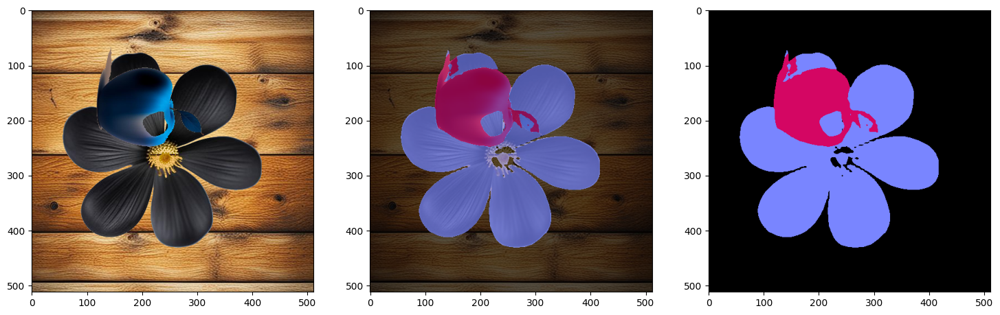

In [11]:
plot_predictions(train_images[:3], colormap, "train", model=model)

## Inference on Validation Images

In [12]:
# _predictions(val_images, colormap, "val", model=model)

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 502ms/step


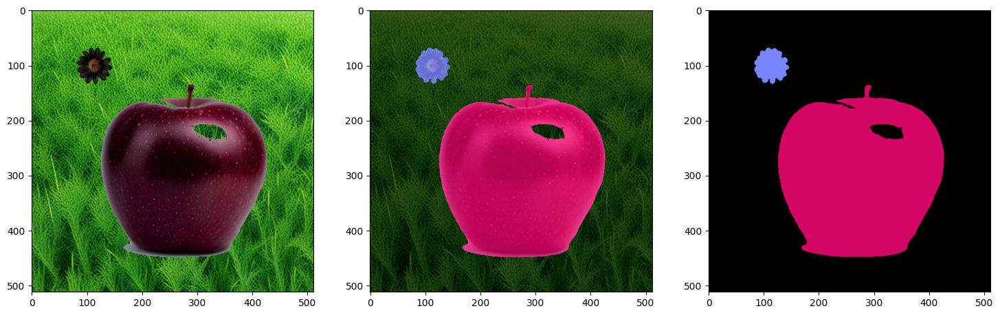

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 516ms/step


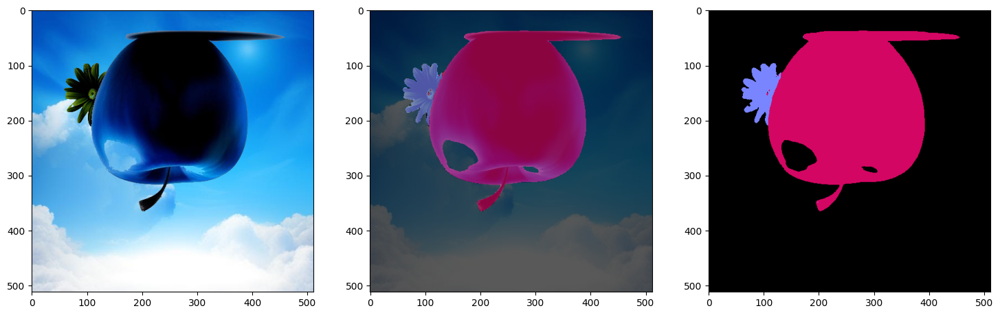

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 498ms/step


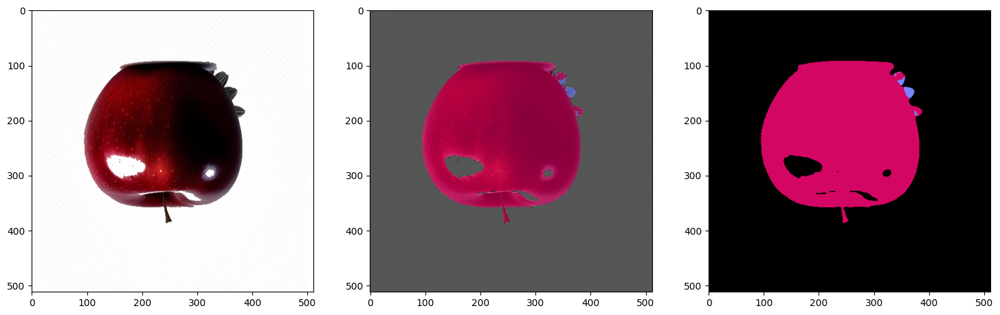

In [13]:
plot_predictions(val_images[:3], colormap, "val", model=model)

## Inference on Testing Images

In [14]:
_predictions(test_images, colormap, "test", model=model)

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 513ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 545ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 501ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 621ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 496ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 495ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 537ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 549ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 541ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 502ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 498ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 489ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 475ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 481ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 511ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 475ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 493ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 500ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 475ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 570ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 482ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 475ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 485ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 500ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 486ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 544ms/step


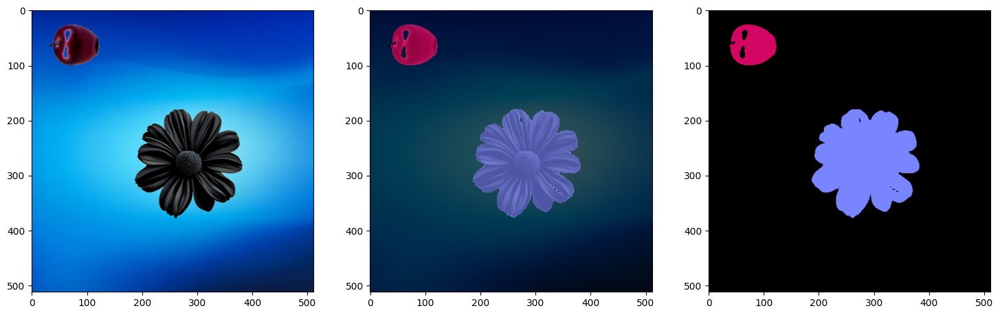

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 578ms/step


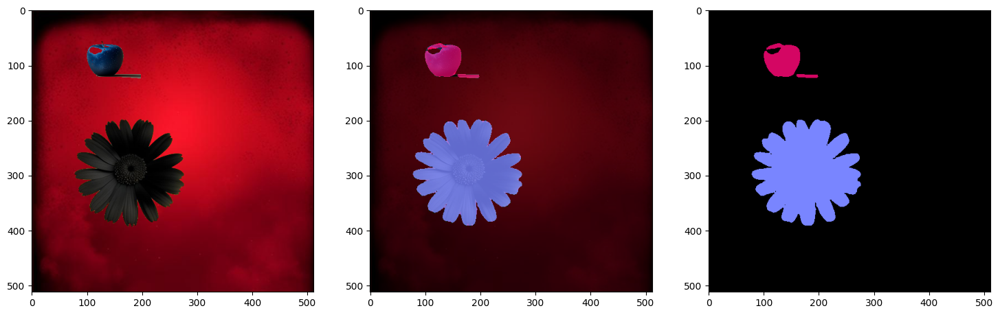

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 480ms/step


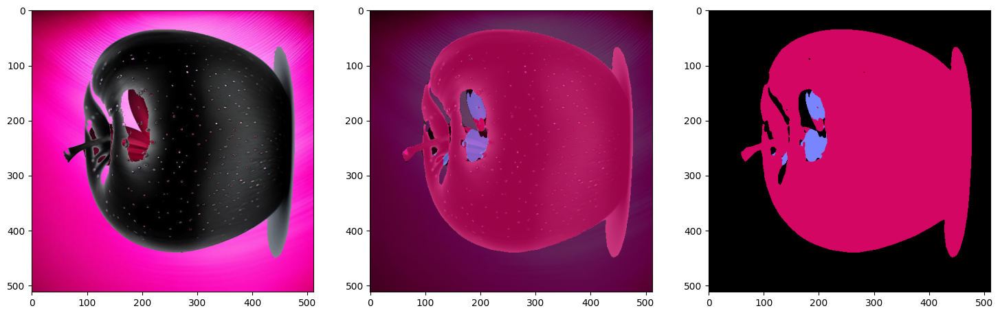

In [15]:
plot_predictions(test_images[10:13], colormap, "test", model=model)

# IOU for test

In [16]:
test_pred = sorted(glob(os.path.join(DATA_DIR, "test_pred/*")))
mask_color = sorted(glob(os.path.join(DATA_DIR, "mask_color/*")))[NUM_VAL_IMAGES + NUM_TRAIN_IMAGES : NUM_TEST_IMAGES + NUM_VAL_IMAGES + NUM_TRAIN_IMAGES]

In [17]:
# from pathlib import Path
# names = []
# for i in range(334):
#     path = Path(test_pred[i])
#     names.append(path.name)

# print(names)

In [18]:
# for i in range(334):
#     name = f"C:/Users/iraor/PycharmProjects/FusionBrainGen/join_classes/mask_color/{names[i]}.png"
#     new_name = f"C:/Users/iraor/PycharmProjects/FusionBrainGen/join_classes/mask_color/{names[i]}"
#     # if name != new_name:
#     os.rename(name, new_name)

In [19]:
# for i in range(334):
#     image = cv2.imread(f"C:/Users/iraor/PycharmProjects/FusionBrainGen/join_classes/mask/image{i}.png")
#     for k in range(image.shape[0]):
#         for l in range(image.shape[0]):
#             if list(image[k, l]) == [1, 1, 1]:
#                 image[k, l] = [99, 6, 212]
#             elif list(image[k, l]) == [2, 2, 2]:
#                 image[k, l] = [255, 133, 121]
#     cv2.imwrite(f"C:/Users/iraor/PycharmProjects/FusionBrainGen/join_classes/mask_color/image{i}.png", image)

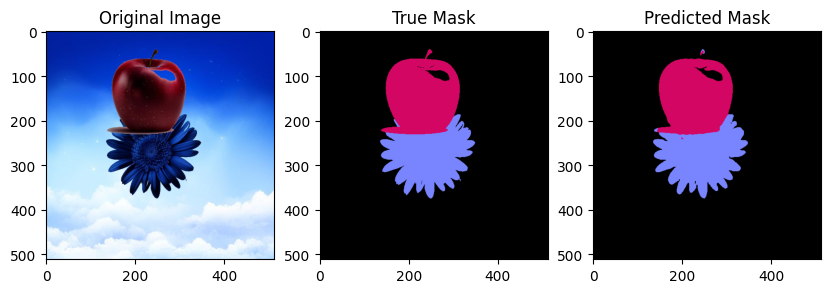

image0 IOU_apple: 0.977235499180982
image0 IOU_flower: 0.9733595800524935
image0 IOU_back: 0.9969913483935372


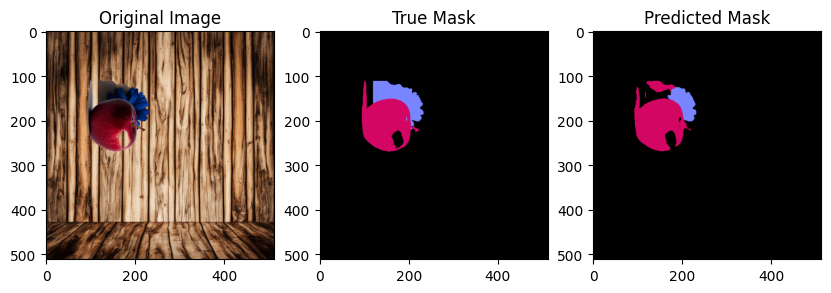

image1 IOU_apple: 0.8681505394613882
image1 IOU_flower: 0.5087059754649782
image1 IOU_back: 0.9925281152321722


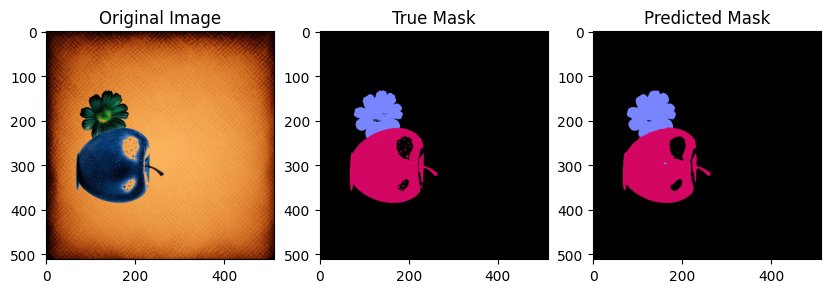

image2 IOU_apple: 0.9679675479087985
image2 IOU_flower: 0.9705271358088808
image2 IOU_back: 0.996613184632753


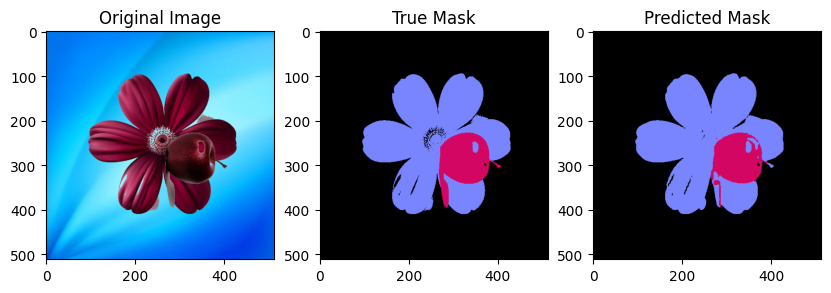

image3 IOU_apple: 0.8777194943675295
image3 IOU_flower: 0.9570188439551133
image3 IOU_back: 0.9942749452452504


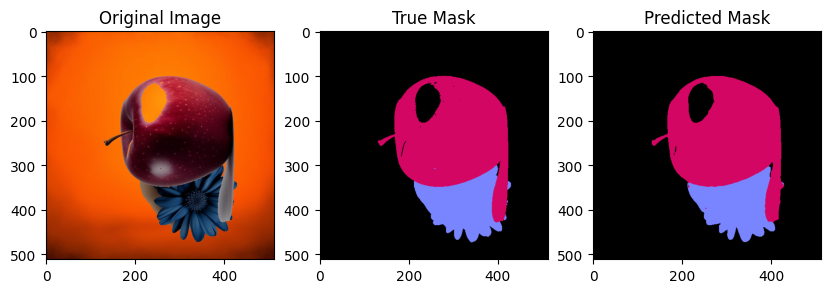

image4 IOU_apple: 0.9864570508570888
image4 IOU_flower: 0.9722133503672948
image4 IOU_back: 0.9965276689954782


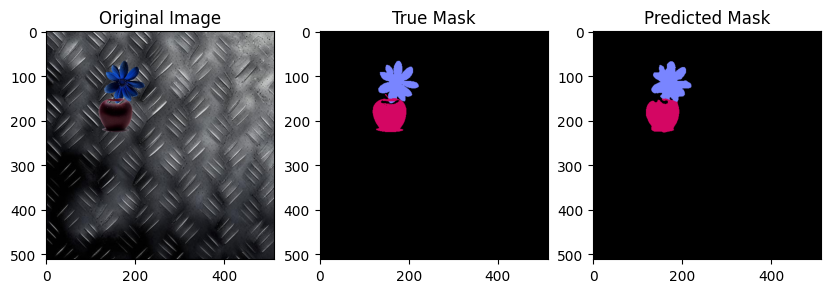

image5 IOU_apple: 0.9080604534005038
image5 IOU_flower: 0.9330637007077857
image5 IOU_back: 0.9971916658437839


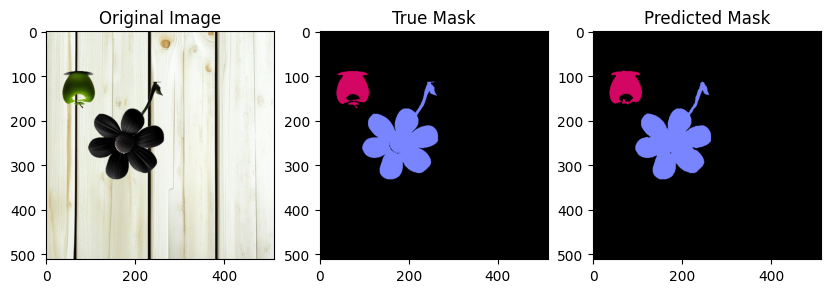

image6 IOU_apple: 0.929636533084809
image6 IOU_flower: 0.9841146411908465
image6 IOU_back: 0.9975627508474224


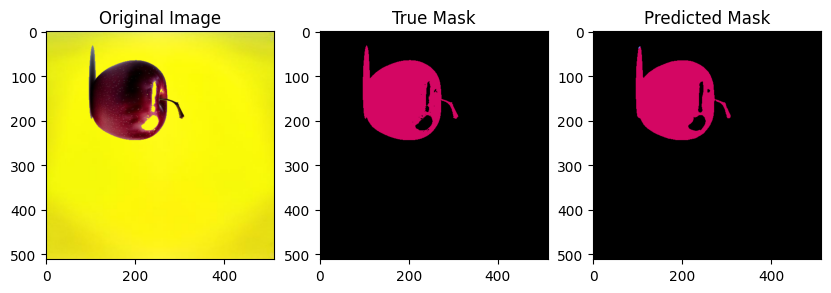

image7 IOU_apple: 0.9855946527350953
image7 IOU_flower: 1
image7 IOU_back: 0.998464954012052


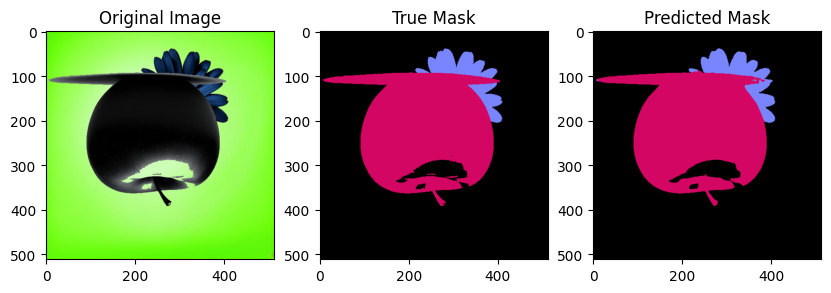

image8 IOU_apple: 0.984235534437586
image8 IOU_flower: 0.9292982828068688
image8 IOU_back: 0.9960833547944029


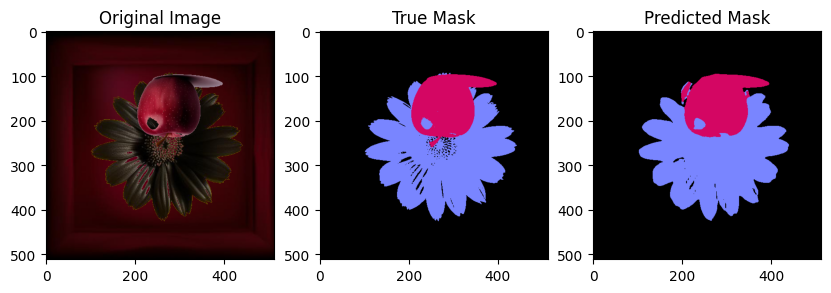

image9 IOU_apple: 0.9276928013691303
image9 IOU_flower: 0.9326454624604043
image9 IOU_back: 0.9871325051759834


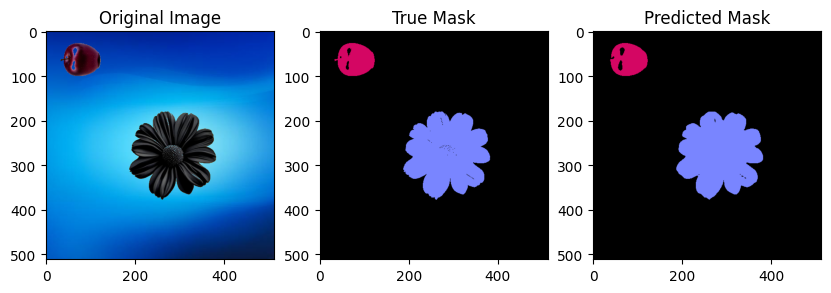

image10 IOU_apple: 0.9559498956158664
image10 IOU_flower: 0.9870047661602621
image10 IOU_back: 0.9975763661072111


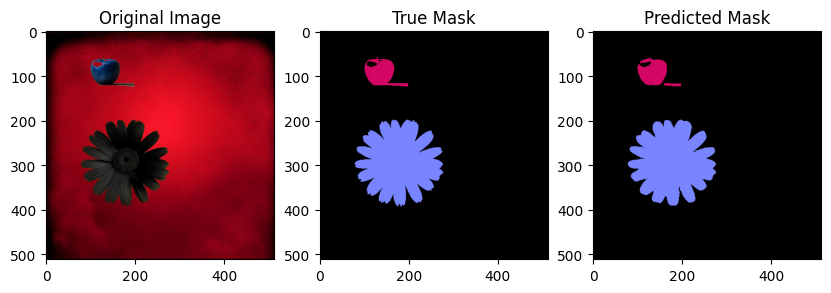

image11 IOU_apple: 0.9150043365134432
image11 IOU_flower: 0.9793161671591388
image11 IOU_back: 0.9964319216650461


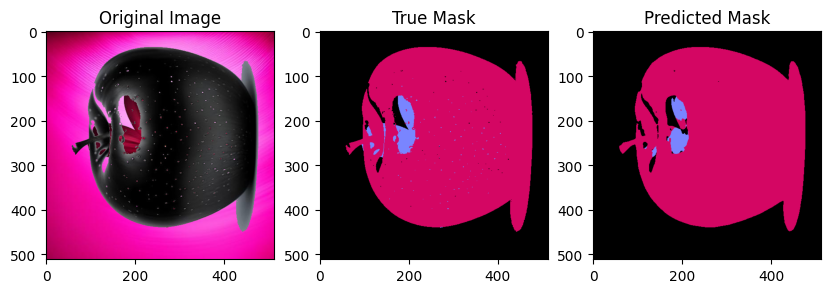

image12 IOU_apple: 0.9839409891975188
image12 IOU_flower: 0.5886037583350172
image12 IOU_back: 0.9886115125878729


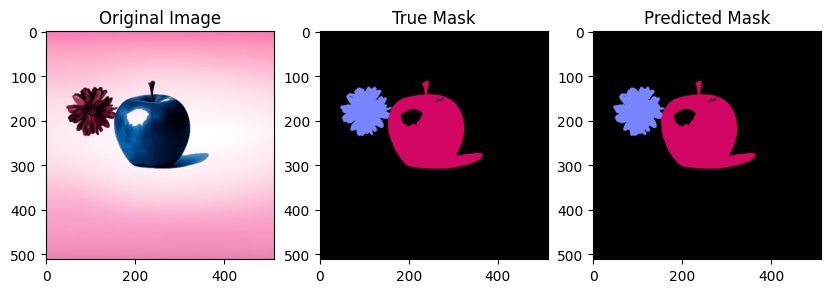

image13 IOU_apple: 0.9913857677902622
image13 IOU_flower: 0.9723225030084236
image13 IOU_back: 0.998145381260967


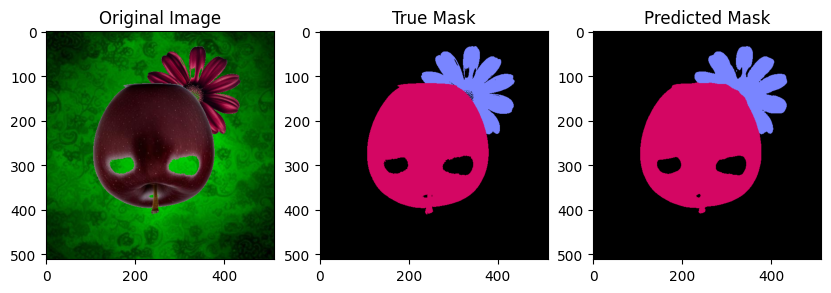

image14 IOU_apple: 0.9904497426171769
image14 IOU_flower: 0.9607369027058146
image14 IOU_back: 0.9944984078563592


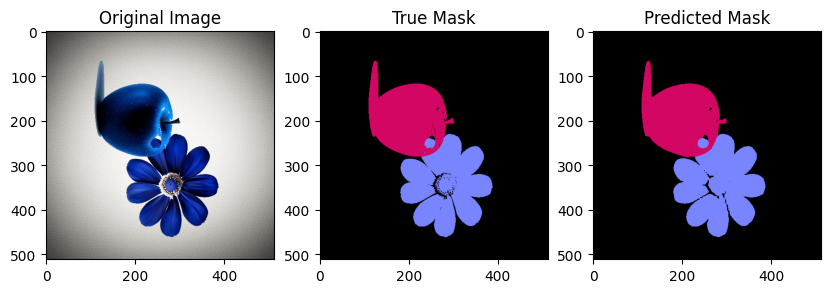

image15 IOU_apple: 0.9880242002320571
image15 IOU_flower: 0.9721291350077972
image15 IOU_back: 0.9955624913236414


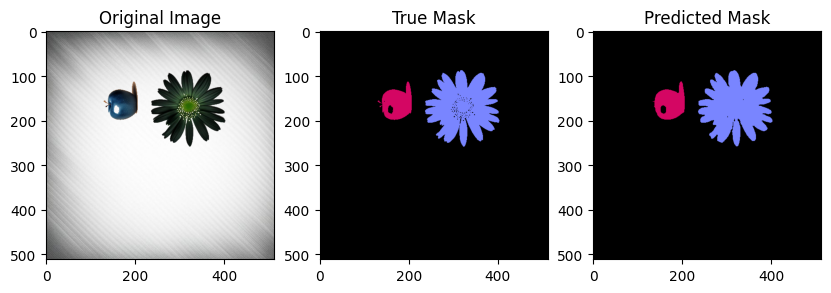

image16 IOU_apple: 0.9633534136546185
image16 IOU_flower: 0.9679389312977099
image16 IOU_back: 0.9970437998573727


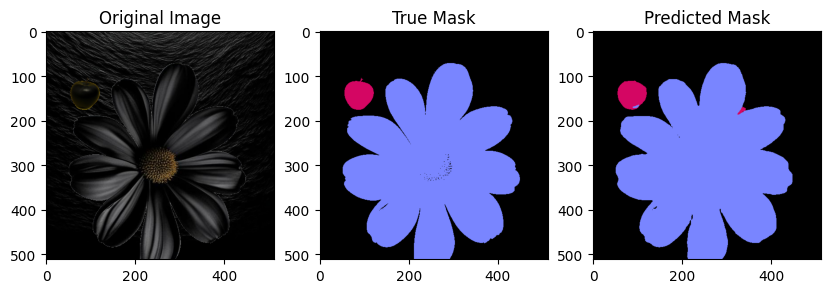

image17 IOU_apple: 0.9123652864435621
image17 IOU_flower: 0.9898823694160481
image17 IOU_back: 0.9908275762710702


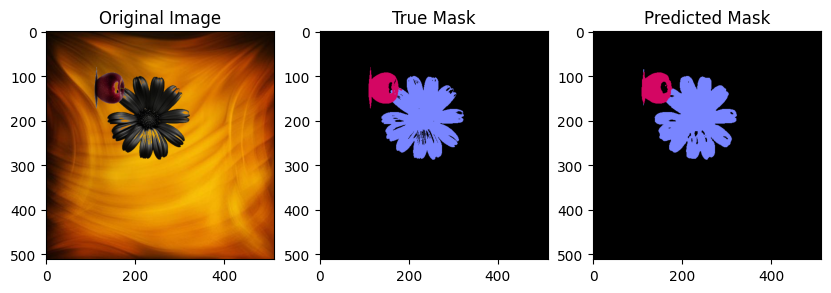

image18 IOU_apple: 0.9134396355353075
image18 IOU_flower: 0.9436057449639793
image18 IOU_back: 0.99386755774121


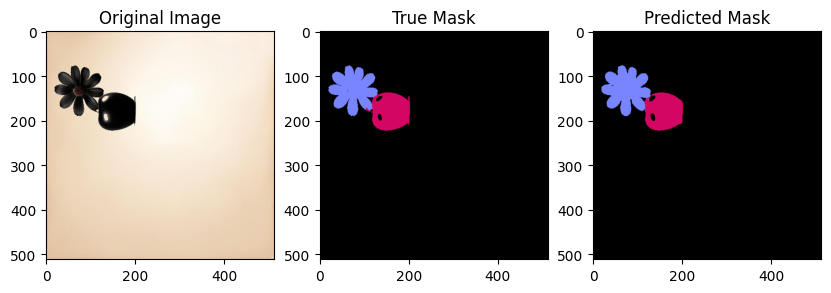

image19 IOU_apple: 0.9630593978844589
image19 IOU_flower: 0.9683496608892238
image19 IOU_back: 0.9986355183822642


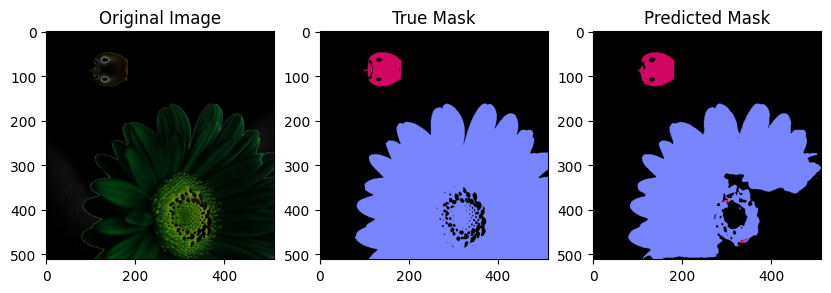

image20 IOU_apple: 0.8951956213257652
image20 IOU_flower: 0.7074098426147098
image20 IOU_back: 0.7939301287285235


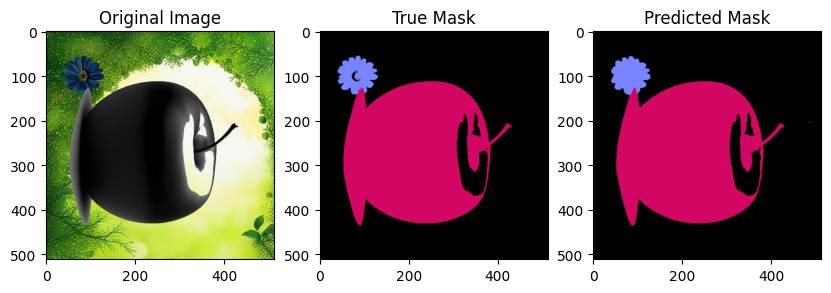

image21 IOU_apple: 0.9929110031967593
image21 IOU_flower: 0.921042899408284
image21 IOU_back: 0.9946515544631072


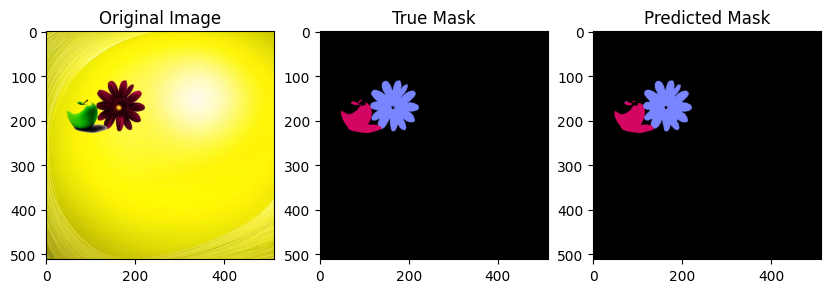

image22 IOU_apple: 0.9506662886305642
image22 IOU_flower: 0.9741652449427248
image22 IOU_back: 0.9986282578875172


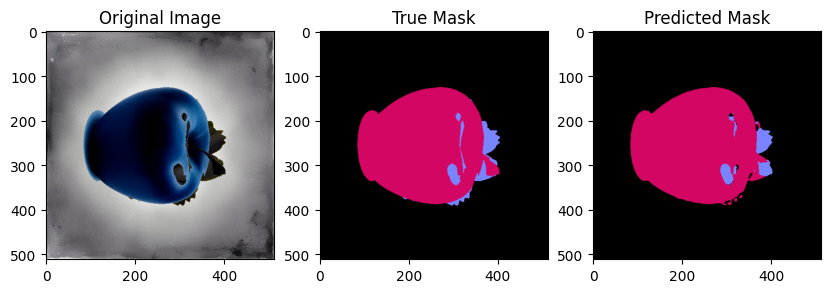

image23 IOU_apple: 0.958189727287937
image23 IOU_flower: 0.482086406743941
image23 IOU_back: 0.9961958915628879


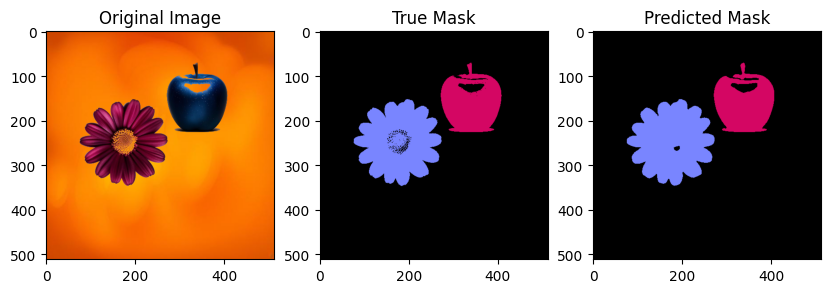

image24 IOU_apple: 0.9760692109118817
image24 IOU_flower: 0.972101673899566
image24 IOU_back: 0.9952345942456493


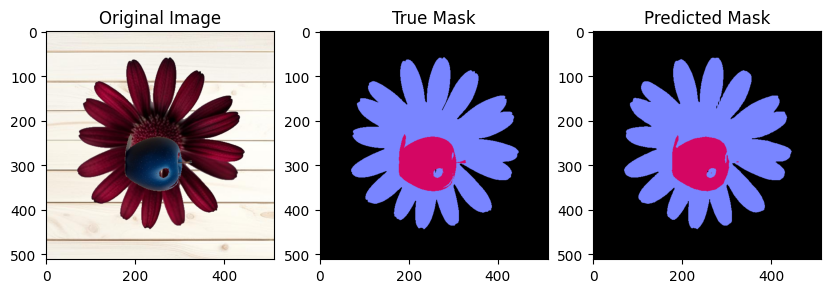

image25 IOU_apple: 0.9559949976551508
image25 IOU_flower: 0.9856733900619813
image25 IOU_back: 0.9969361760723384


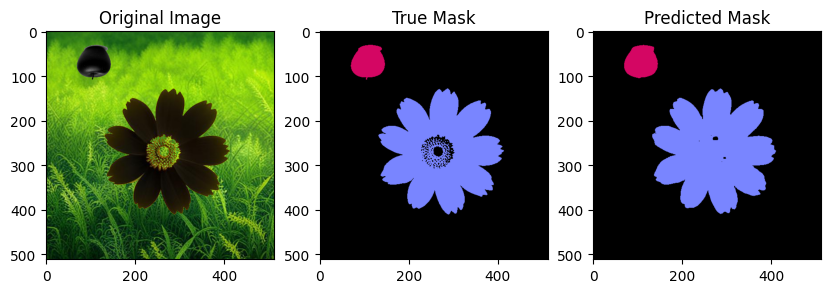

image26 IOU_apple: 0.9822340661781035
image26 IOU_flower: 0.9511637159339567
image26 IOU_back: 0.9879231656074624


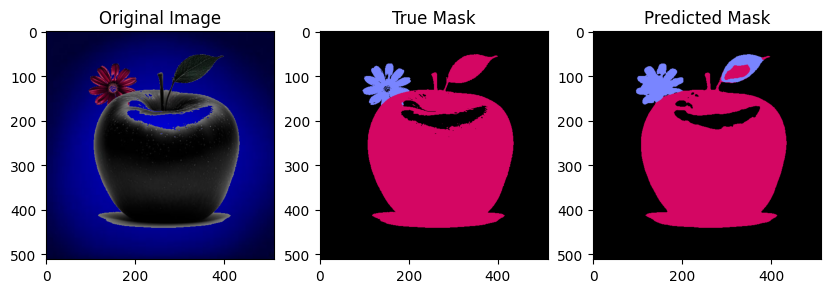

image27 IOU_apple: 0.9548612730240149
image27 IOU_flower: 0.6250576302443522
image27 IOU_back: 0.989896583778759


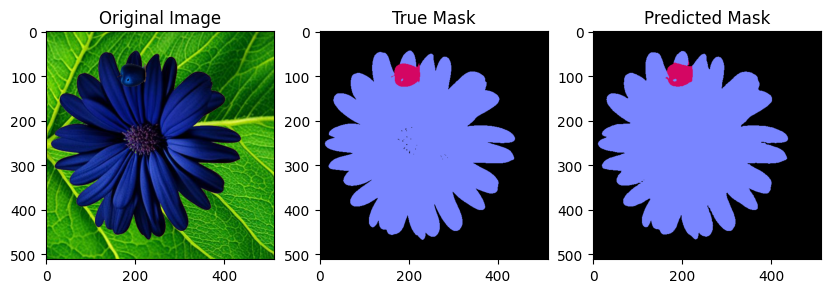

image28 IOU_apple: 0.917175572519084
image28 IOU_flower: 0.9908159969270256
image28 IOU_back: 0.9938450373474097


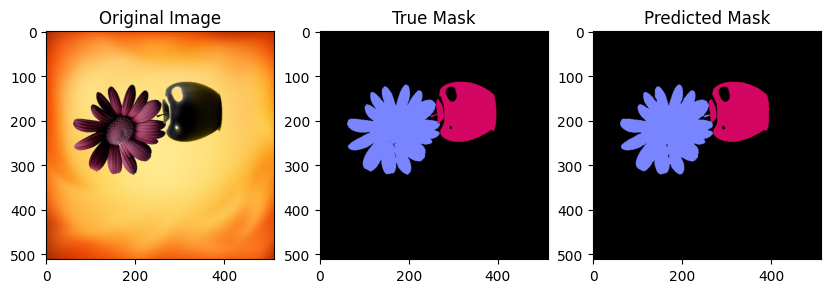

image29 IOU_apple: 0.9801565120178871
image29 IOU_flower: 0.9854895837300529
image29 IOU_back: 0.9974481414638757


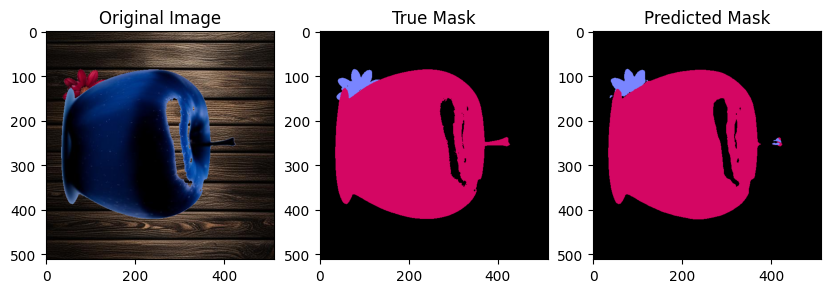

image30 IOU_apple: 0.9853903950085681
image30 IOU_flower: 0.8483256730137886
image30 IOU_back: 0.992135593220339


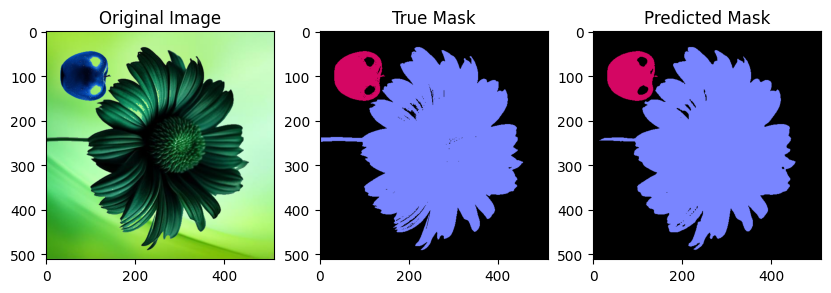

image31 IOU_apple: 0.9822960193534198
image31 IOU_flower: 0.9841758241758242
image31 IOU_back: 0.9874778683317791


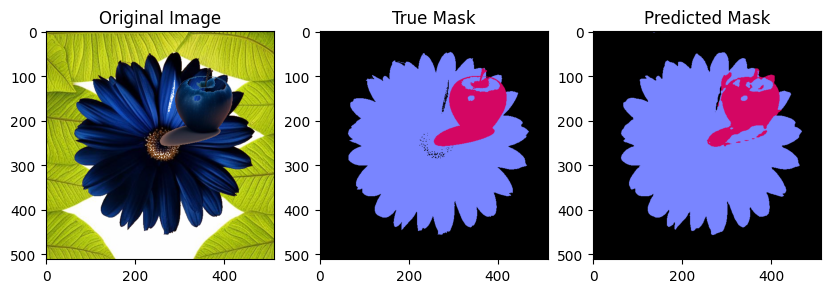

image32 IOU_apple: 0.7447218045112782
image32 IOU_flower: 0.9504223247974565
image32 IOU_back: 0.9928586072575685


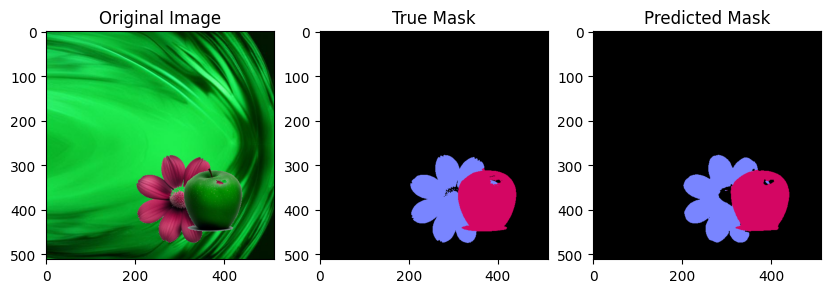

image33 IOU_apple: 0.9795365225640331
image33 IOU_flower: 0.9355447082316397
image33 IOU_back: 0.9947290396969198


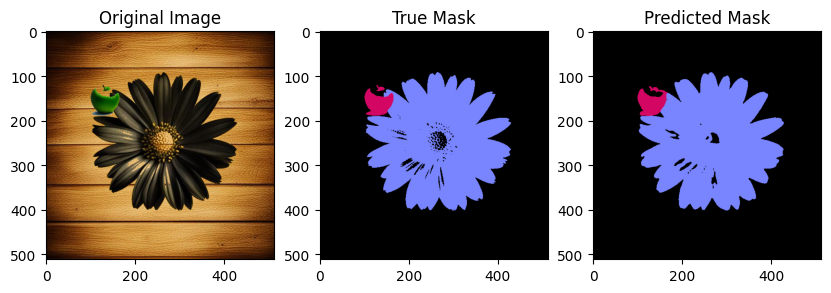

image34 IOU_apple: 0.9075283602612582
image34 IOU_flower: 0.9653340118846263
image34 IOU_back: 0.9877738443384126


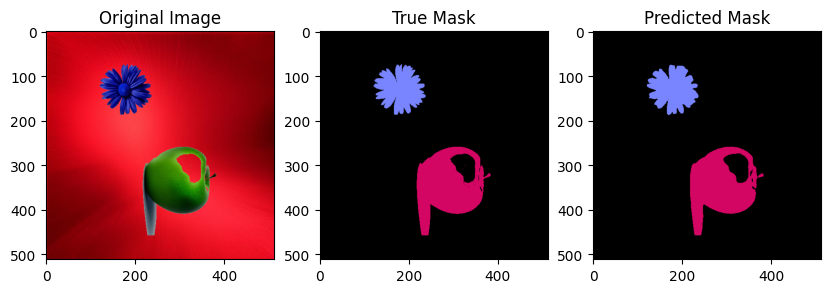

image35 IOU_apple: 0.9722546566583263
image35 IOU_flower: 0.9539558256398271
image35 IOU_back: 0.9962240216495063


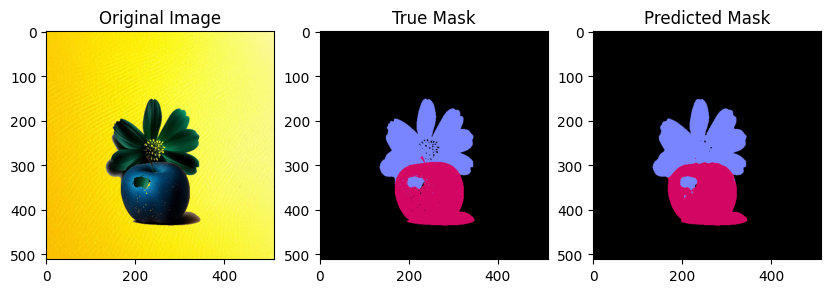

image36 IOU_apple: 0.9716248348745046
image36 IOU_flower: 0.9646256138368606
image36 IOU_back: 0.9977976456968167


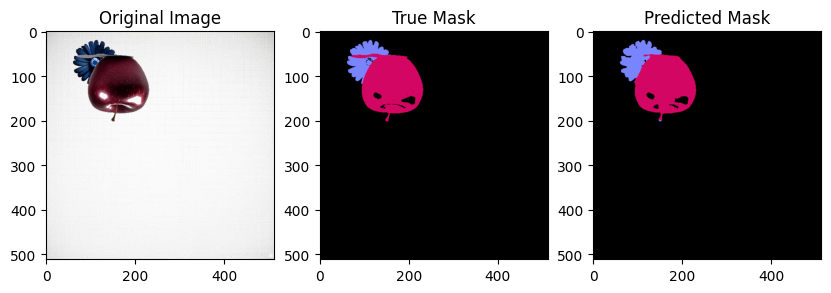

image37 IOU_apple: 0.9569488981374088
image37 IOU_flower: 0.870604458745116
image37 IOU_back: 0.998204564832426


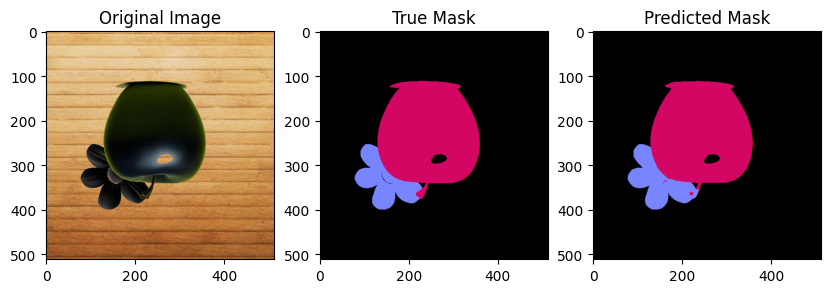

image38 IOU_apple: 0.986364048201504
image38 IOU_flower: 0.9578957510357452
image38 IOU_back: 0.998238287250384


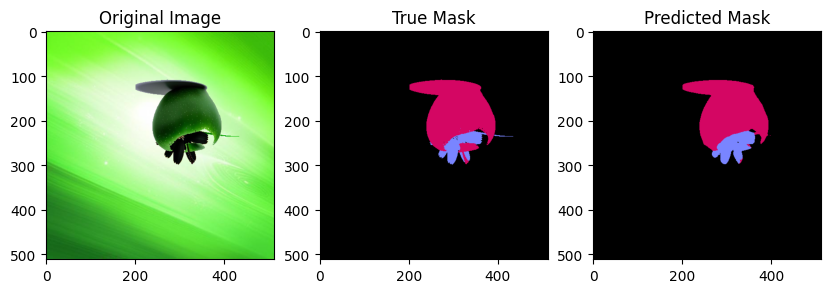

image39 IOU_apple: 0.941124597987343
image39 IOU_flower: 0.7336956521739131
image39 IOU_back: 0.9983580733616156


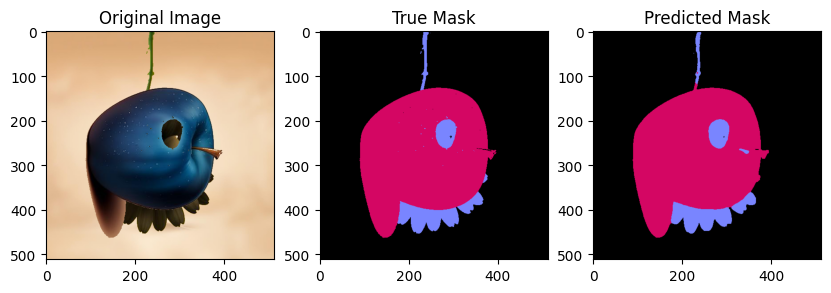

image40 IOU_apple: 0.9872454984112039
image40 IOU_flower: 0.9143866642507701
image40 IOU_back: 0.9974277295100205


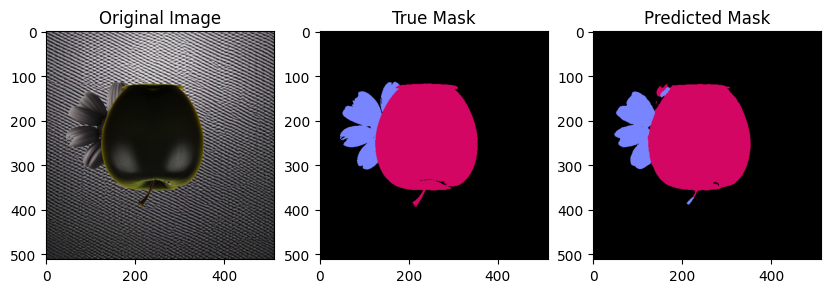

image41 IOU_apple: 0.973942896134081
image41 IOU_flower: 0.8441916274108968
image41 IOU_back: 0.9909648476862258


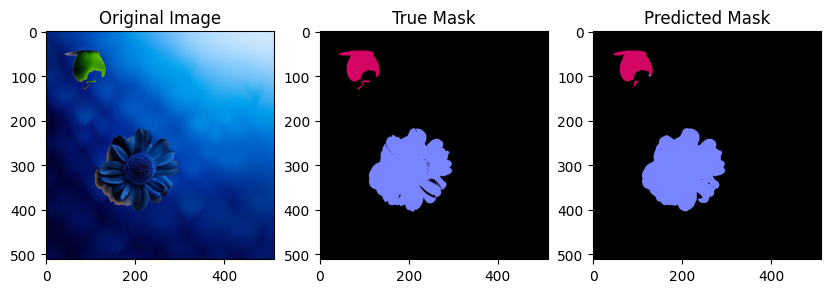

image42 IOU_apple: 0.9428499496475328
image42 IOU_flower: 0.9653613172937463
image42 IOU_back: 0.9956947195629398


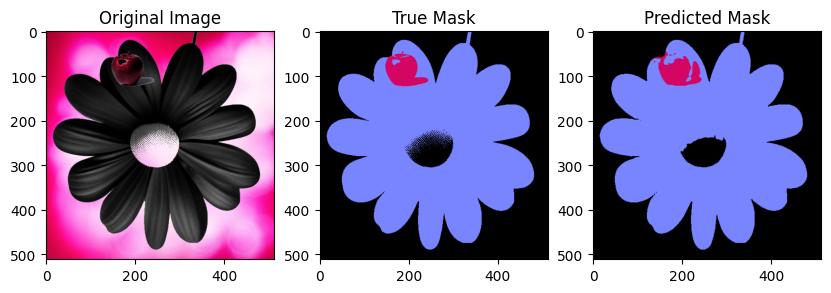

image43 IOU_apple: 0.7495223538402751
image43 IOU_flower: 0.9793597489441577
image43 IOU_back: 0.9876611268747466


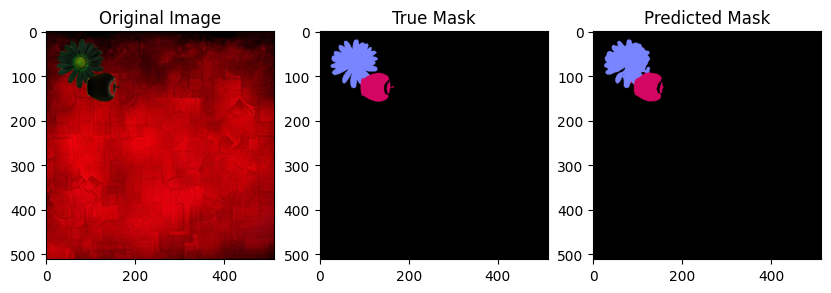

image44 IOU_apple: 0.9281122150789012
image44 IOU_flower: 0.9322033898305084
image44 IOU_back: 0.9973741412410554


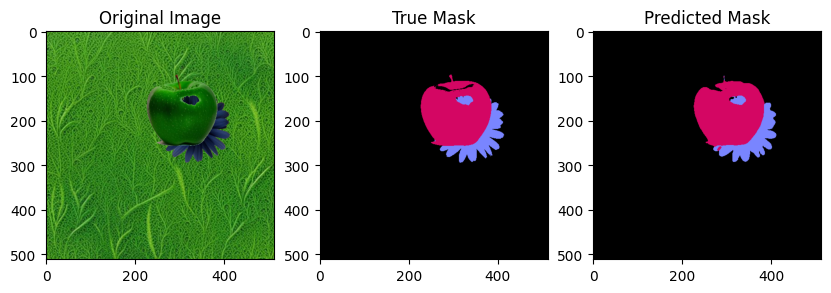

image45 IOU_apple: 0.9554642741325262
image45 IOU_flower: 0.9098434677904876
image45 IOU_back: 0.99588161209068


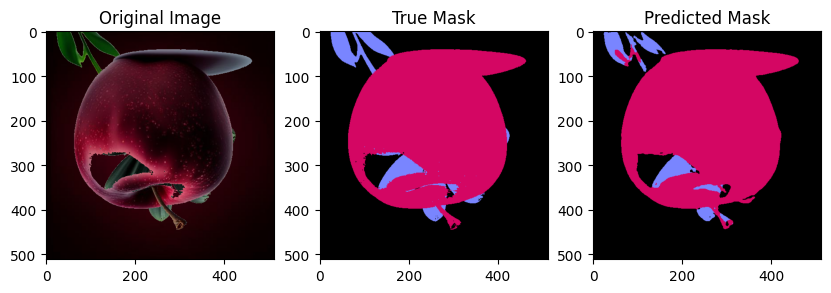

image46 IOU_apple: 0.9664336204565646
image46 IOU_flower: 0.6389631429728635
image46 IOU_back: 0.9833433462510975


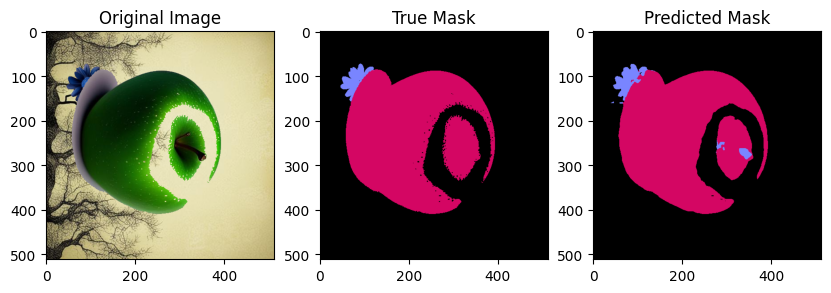

image47 IOU_apple: 0.9682914820285574
image47 IOU_flower: 0.6867124856815578
image47 IOU_back: 0.9920105263157895


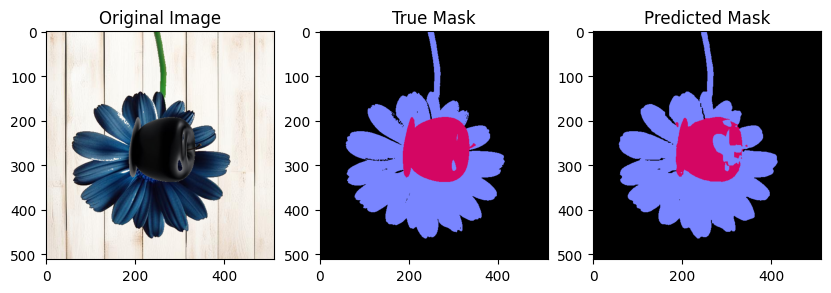

image48 IOU_apple: 0.8109934061182574
image48 IOU_flower: 0.9328325645181399
image48 IOU_back: 0.99545689491009


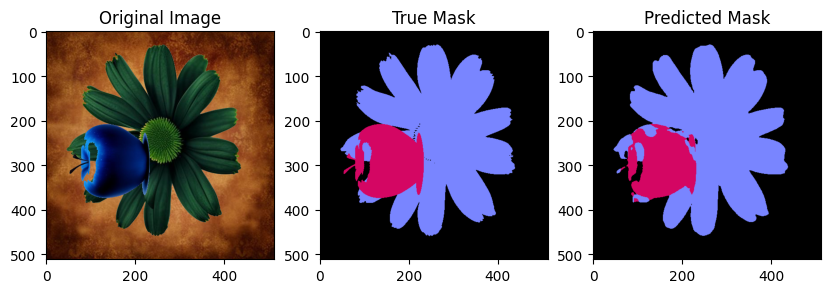

image49 IOU_apple: 0.8917280837858805
image49 IOU_flower: 0.9627965450608805
image49 IOU_back: 0.9915785104215147


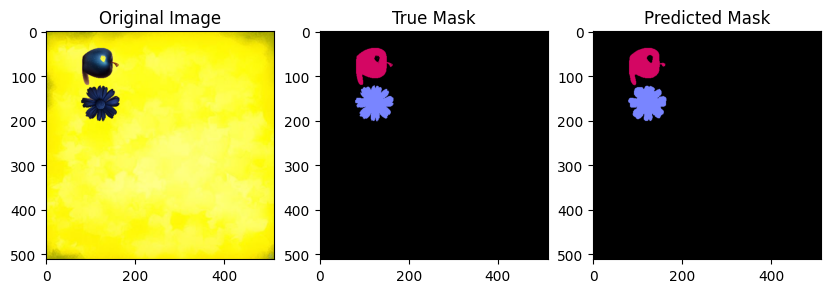

image50 IOU_apple: 0.9671627687219466
image50 IOU_flower: 0.9576164498531263
image50 IOU_back: 0.9986547580536992


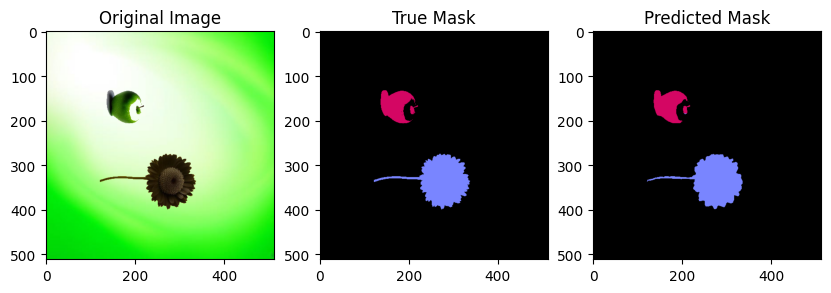

image51 IOU_apple: 0.9589465530596437
image51 IOU_flower: 0.9677539608574092
image51 IOU_back: 0.99801241735204


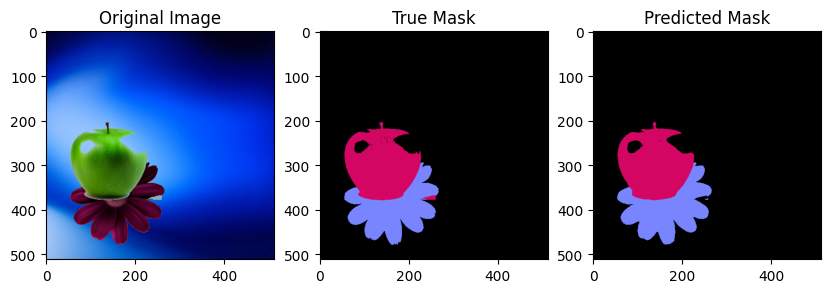

image52 IOU_apple: 0.9701521845851743
image52 IOU_flower: 0.9765895630796737
image52 IOU_back: 0.9969608109250615


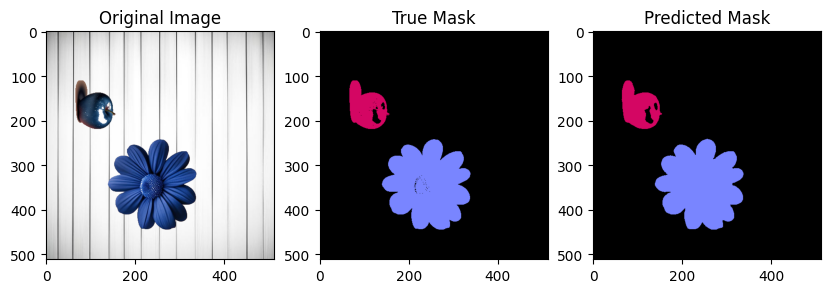

image53 IOU_apple: 0.9646448264677262
image53 IOU_flower: 0.9918710832587287
image53 IOU_back: 0.9980524993654212


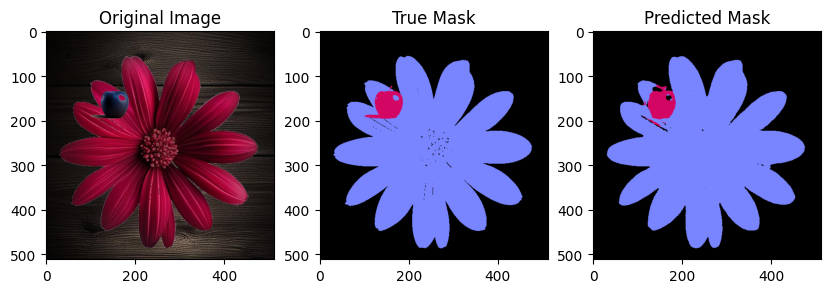

image54 IOU_apple: 0.8262130801687764
image54 IOU_flower: 0.9786471406128677
image54 IOU_back: 0.9872850859656137


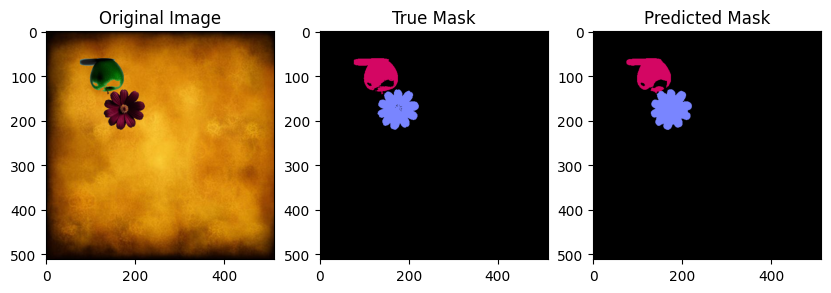

image55 IOU_apple: 0.9463649696207835
image55 IOU_flower: 0.9764424718333903
image55 IOU_back: 0.9984359307204643


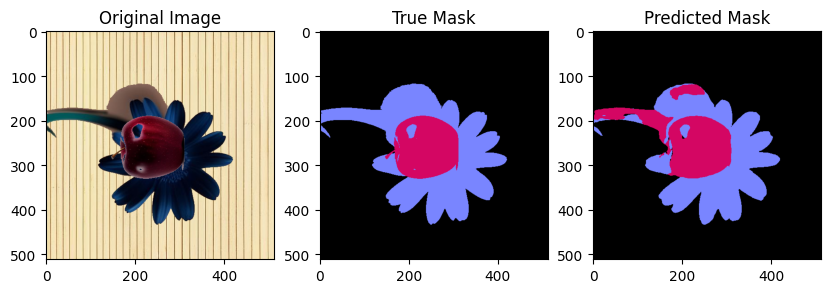

image56 IOU_apple: 0.6916741347672086
image56 IOU_flower: 0.8326208694908733
image56 IOU_back: 0.9960669715681074


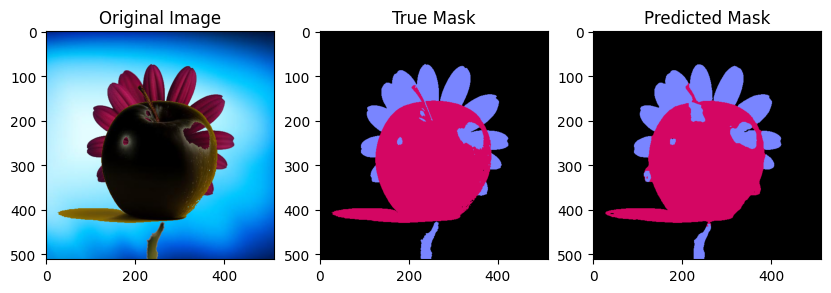

image57 IOU_apple: 0.9635964250381475
image57 IOU_flower: 0.917005076142132
image57 IOU_back: 0.9969564947837702


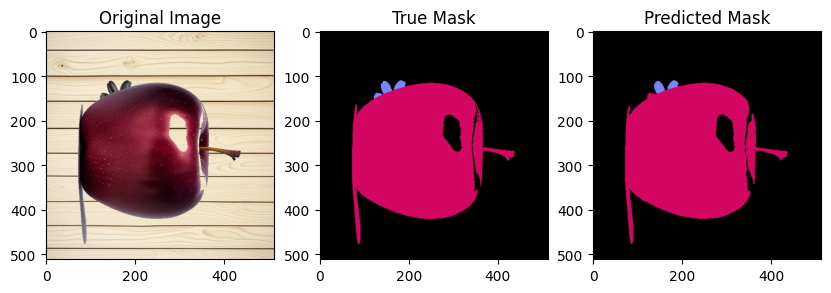

image58 IOU_apple: 0.9877635617202758
image58 IOU_flower: 0.798974358974359
image58 IOU_back: 0.9955638795986622


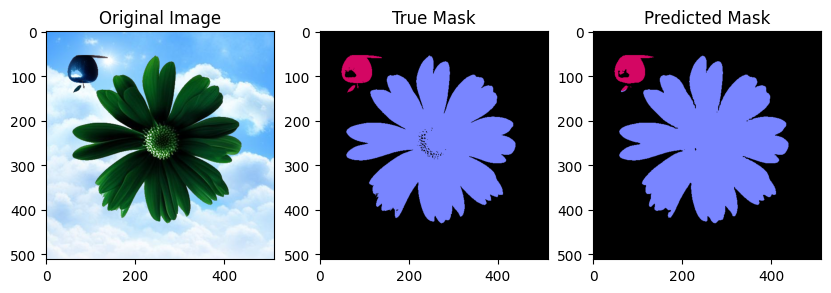

image59 IOU_apple: 0.9343434343434344
image59 IOU_flower: 0.9891903475041369
image59 IOU_back: 0.9936814517277726


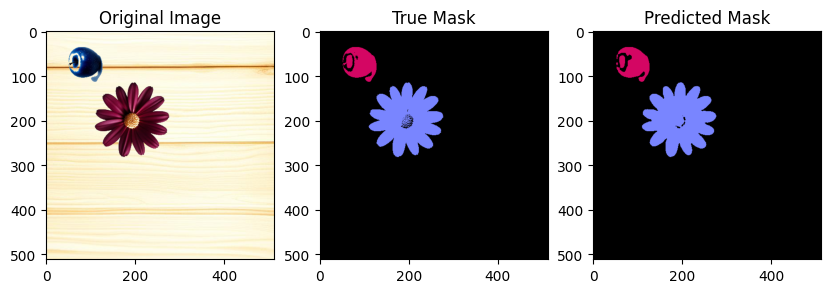

image60 IOU_apple: 0.9179199592148866
image60 IOU_flower: 0.9732223731884058
image60 IOU_back: 0.9967060558851801


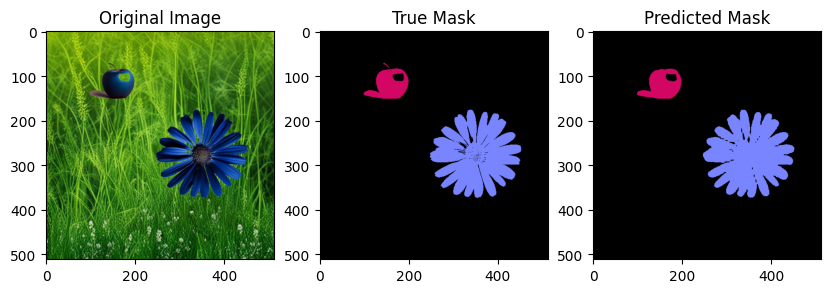

image61 IOU_apple: 0.9531069531069531
image61 IOU_flower: 0.9543935144273255
image61 IOU_back: 0.9940388887459366


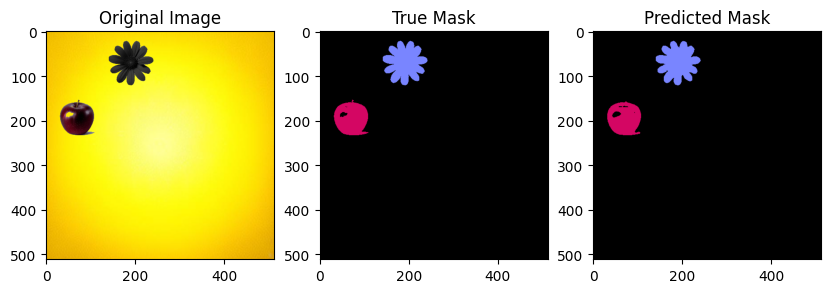

image62 IOU_apple: 0.9614204296361245
image62 IOU_flower: 0.9785165438293869
image62 IOU_back: 0.9987555562623749


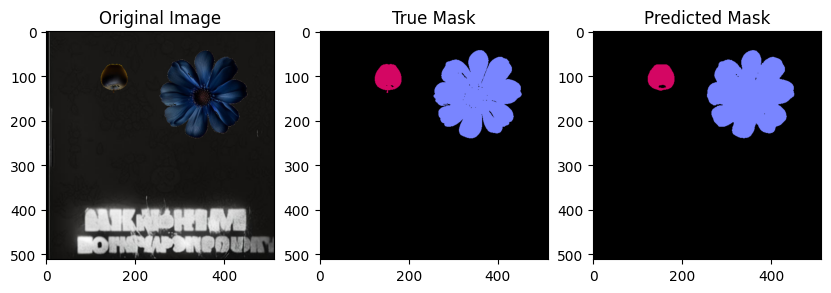

image63 IOU_apple: 0.9535938590369853
image63 IOU_flower: 0.9822084051239793
image63 IOU_back: 0.9973926617150111


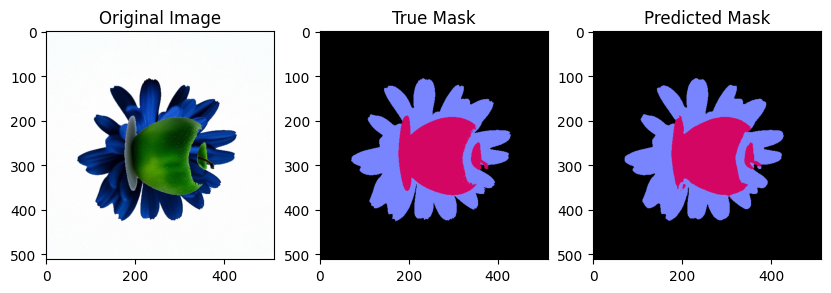

image64 IOU_apple: 0.9636130992842576
image64 IOU_flower: 0.970413809828259
image64 IOU_back: 0.9976388960803604


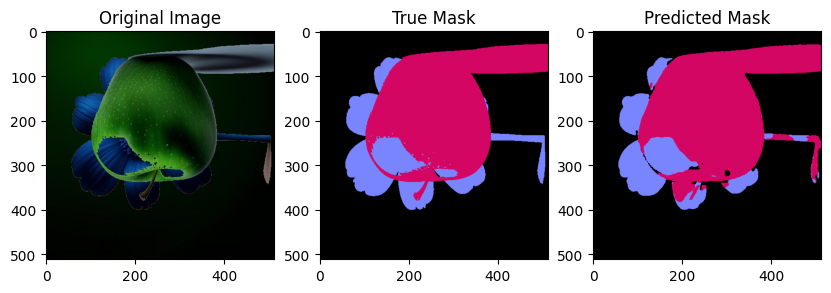

image65 IOU_apple: 0.9178968123562274
image65 IOU_flower: 0.7748254897545598
image65 IOU_back: 0.9861734160879986


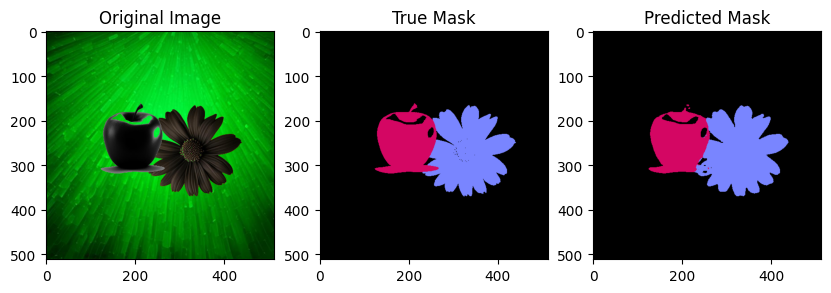

image66 IOU_apple: 0.9394605394605394
image66 IOU_flower: 0.965426944971537
image66 IOU_back: 0.9959574678803267


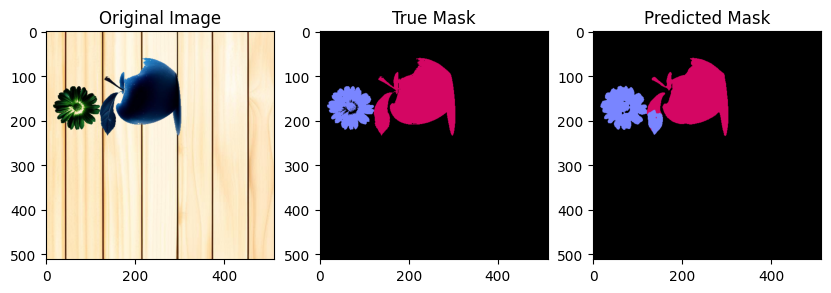

image67 IOU_apple: 0.9121773142112125
image67 IOU_flower: 0.7832571566033197
image67 IOU_back: 0.9963349547358465


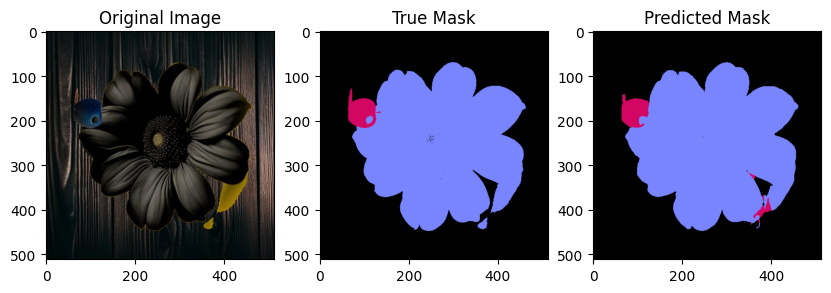

image68 IOU_apple: 0.7299102003223579
image68 IOU_flower: 0.9810699025139091
image68 IOU_back: 0.9875811369934078


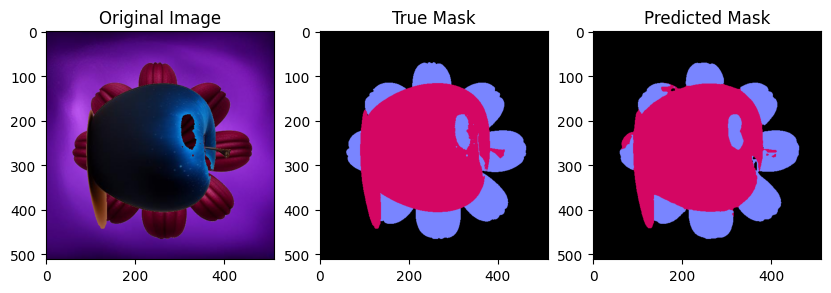

image69 IOU_apple: 0.9721822474955639
image69 IOU_flower: 0.929882026370576
image69 IOU_back: 0.9951839575526615


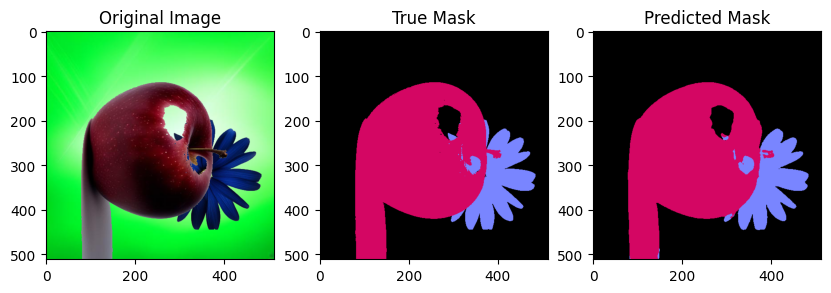

image70 IOU_apple: 0.9825920216565778
image70 IOU_flower: 0.9339764847753994
image70 IOU_back: 0.9963011711942281


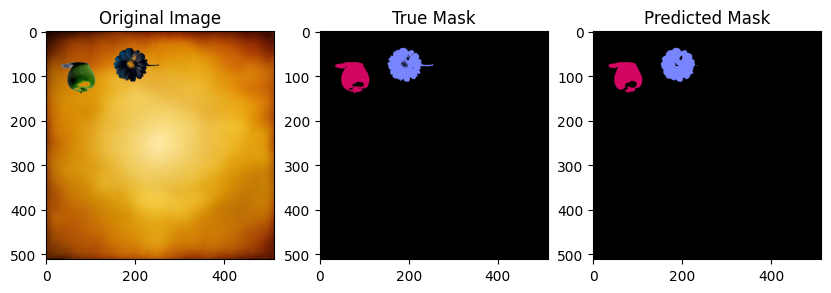

image71 IOU_apple: 0.9211691762621789
image71 IOU_flower: 0.9259689022975168
image71 IOU_back: 0.9977022671486939


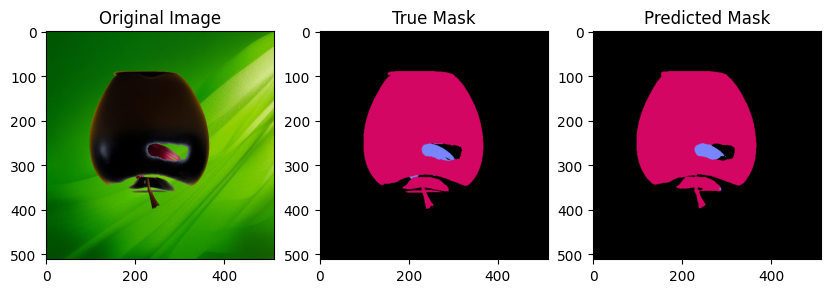

image72 IOU_apple: 0.9846601840777911
image72 IOU_flower: 0.820021299254526
image72 IOU_back: 0.9952128913154483


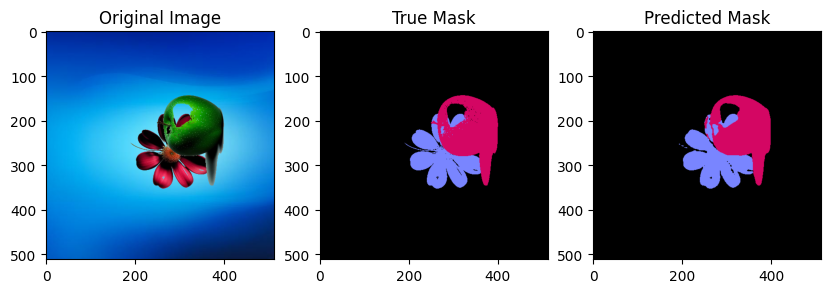

image73 IOU_apple: 0.95049880035358
image73 IOU_flower: 0.9128126202385533
image73 IOU_back: 0.9970377253140225


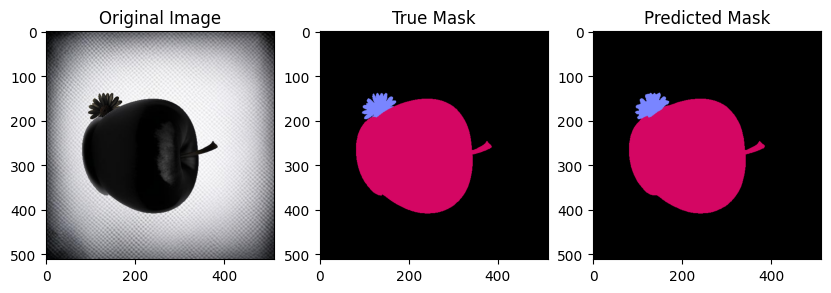

image74 IOU_apple: 0.9966130554681571
image74 IOU_flower: 0.9319852941176471
image74 IOU_back: 0.9987652160385797


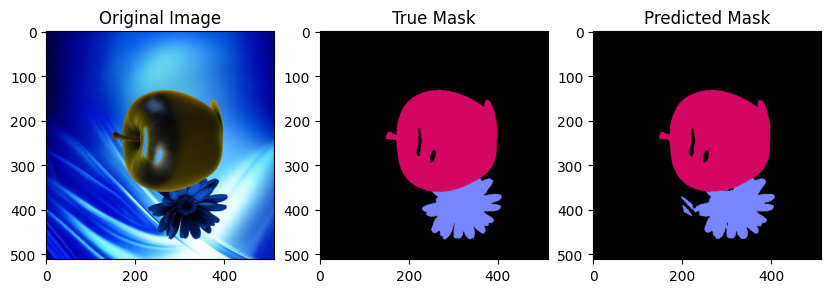

image75 IOU_apple: 0.9928867533446392
image75 IOU_flower: 0.9457943925233645
image75 IOU_back: 0.9949479448317524


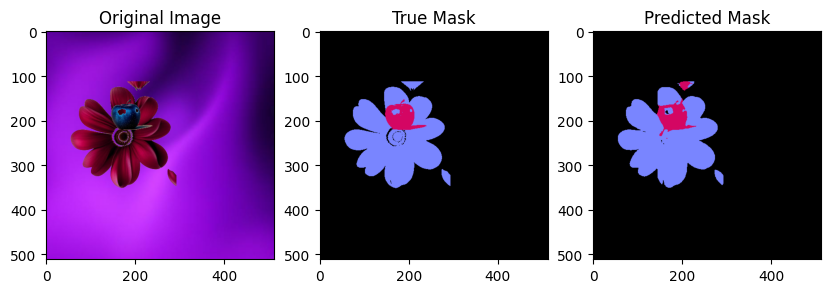

image76 IOU_apple: 0.752400202122284
image76 IOU_flower: 0.9467312348668281
image76 IOU_back: 0.996152707901746


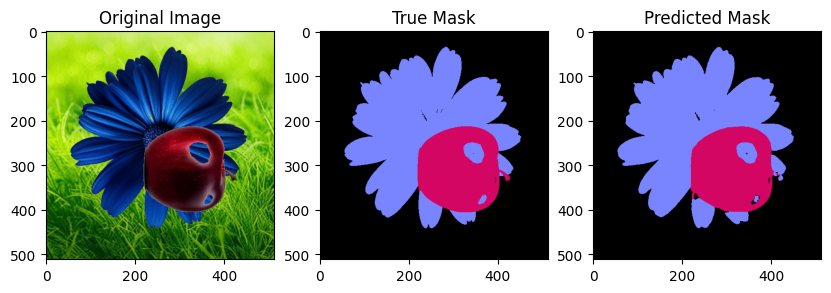

image77 IOU_apple: 0.9754618431661233
image77 IOU_flower: 0.9800373383117749
image77 IOU_back: 0.9934788577704557


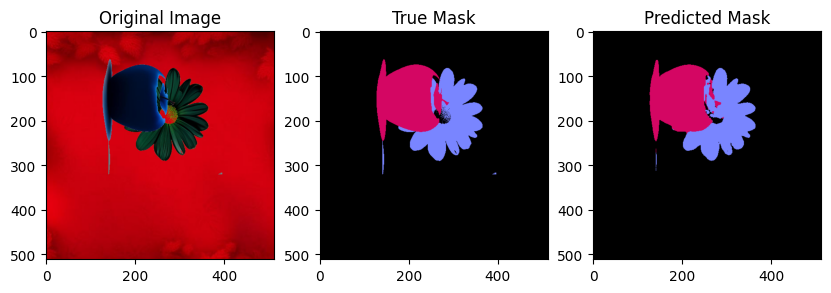

image78 IOU_apple: 0.9263040357313767
image78 IOU_flower: 0.8872400286864898
image78 IOU_back: 0.9950678283498765


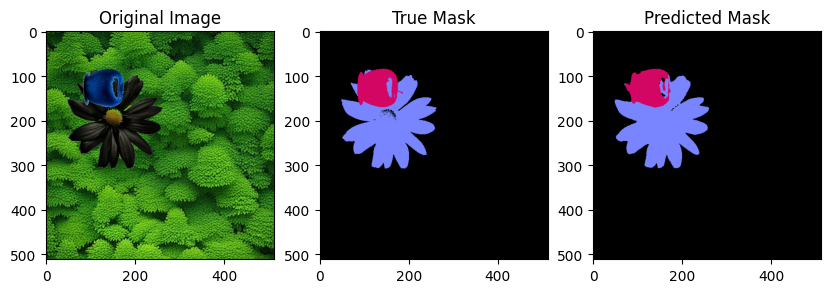

image79 IOU_apple: 0.8670886075949367
image79 IOU_flower: 0.9345775637166366
image79 IOU_back: 0.9963749085116459


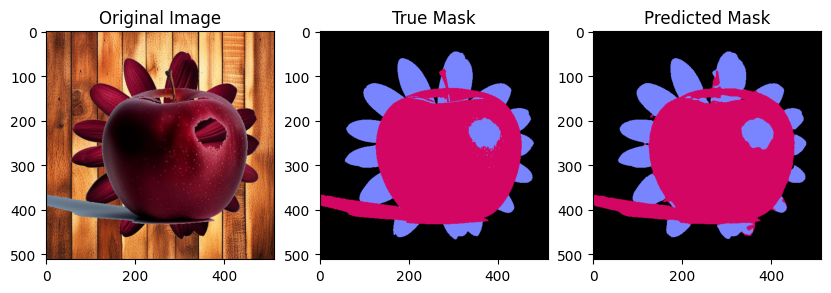

image80 IOU_apple: 0.9676133590536175
image80 IOU_flower: 0.916233375294182
image80 IOU_back: 0.9926989943633998


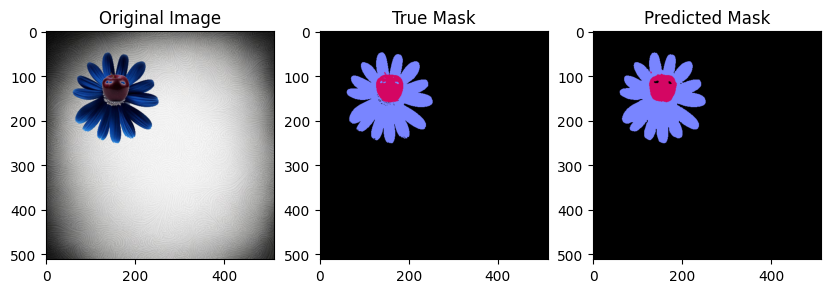

image81 IOU_apple: 0.9359014840543101
image81 IOU_flower: 0.9711278755704573
image81 IOU_back: 0.9980138651527812


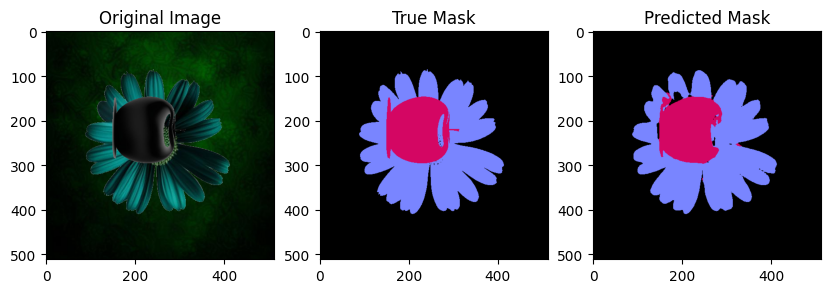

image82 IOU_apple: 0.8897161972590913
image82 IOU_flower: 0.9333523918429579
image82 IOU_back: 0.9911844287335253


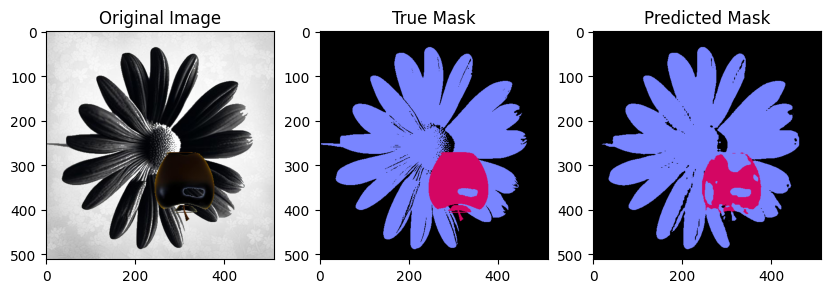

image83 IOU_apple: 0.7209238571722295
image83 IOU_flower: 0.9269267915781341
image83 IOU_back: 0.9753724456163481


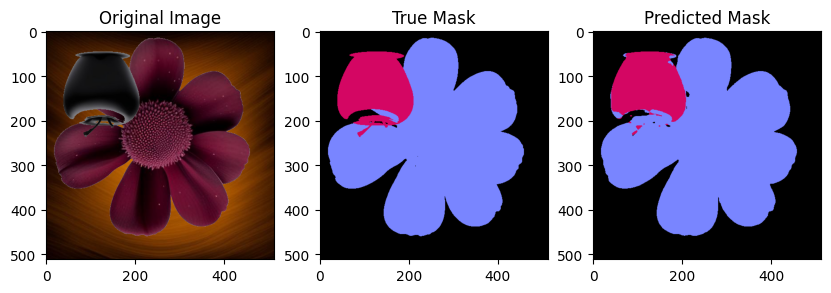

image84 IOU_apple: 0.8785685564937676
image84 IOU_flower: 0.9728272196748645
image84 IOU_back: 0.9940974122429833


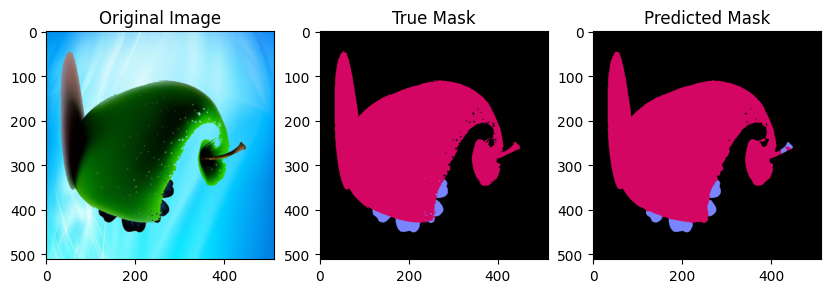

image85 IOU_apple: 0.9836339659963265
image85 IOU_flower: 0.8245100906697865
image85 IOU_back: 0.9948641276435476


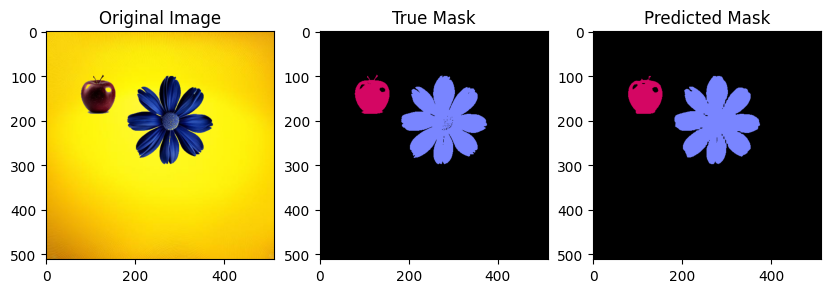

image86 IOU_apple: 0.9637046307884856
image86 IOU_flower: 0.9792476735549828
image86 IOU_back: 0.9972395899791587


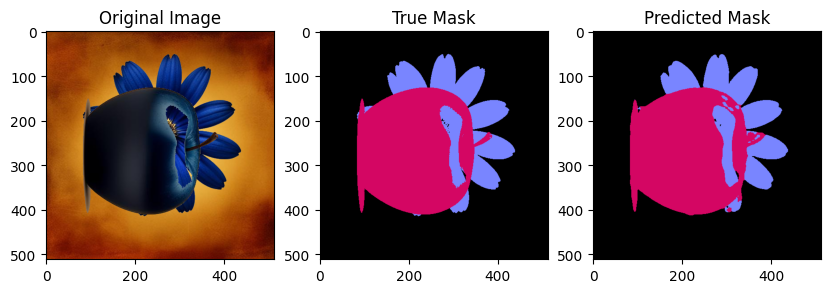

image87 IOU_apple: 0.9674466426759092
image87 IOU_flower: 0.925376108398924
image87 IOU_back: 0.996416861423264


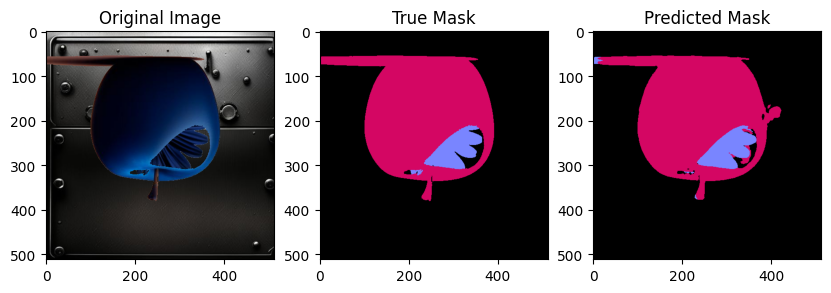

image88 IOU_apple: 0.9594574340527577
image88 IOU_flower: 0.8977227853099908
image88 IOU_back: 0.9876693369123013


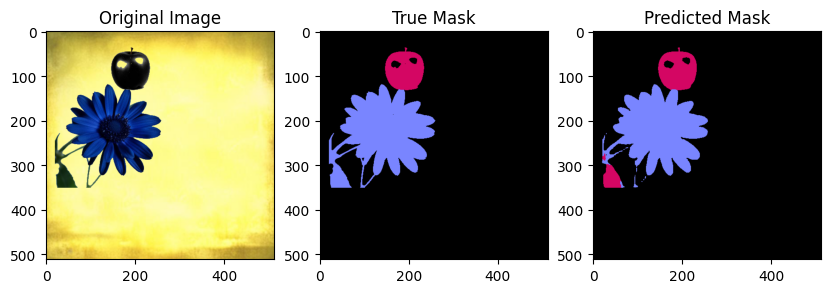

image89 IOU_apple: 0.7684045061566676
image89 IOU_flower: 0.919672131147541
image89 IOU_back: 0.9962444580440363


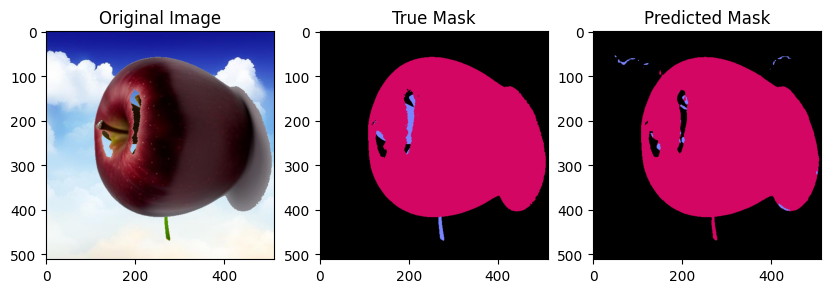

image90 IOU_apple: 0.9866170670491216
image90 IOU_flower: 0.12259059367771781
image90 IOU_back: 0.9883583634047973


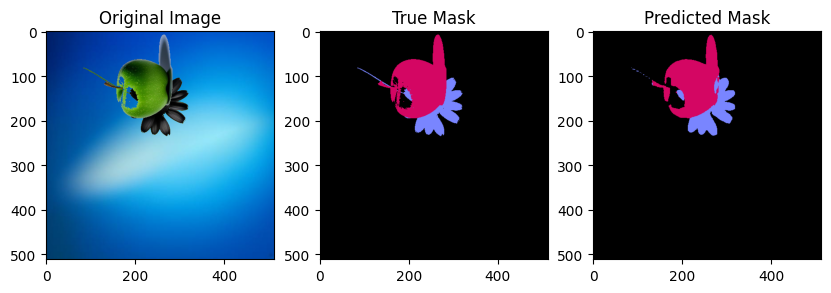

image91 IOU_apple: 0.9171727157181189
image91 IOU_flower: 0.8793507101607617
image91 IOU_back: 0.9955489553208907


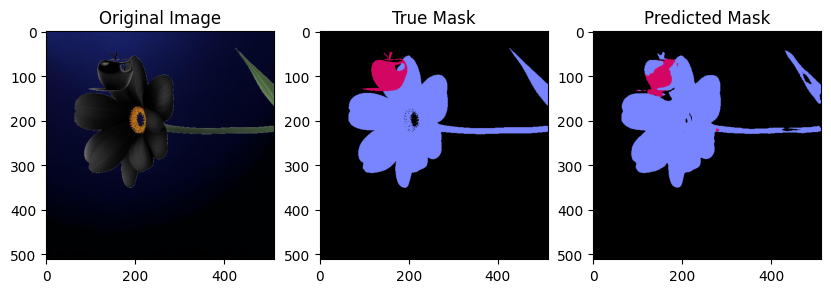

image92 IOU_apple: 0.47575757575757577
image92 IOU_flower: 0.9058397755744481
image92 IOU_back: 0.9866579919604062


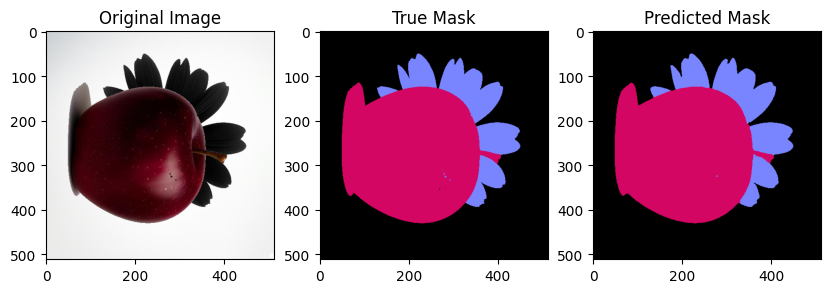

image93 IOU_apple: 0.9951170901843548
image93 IOU_flower: 0.9835897045385318
image93 IOU_back: 0.9978422333205276


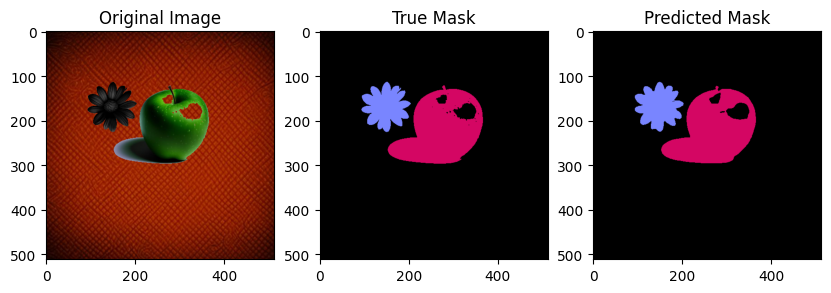

image94 IOU_apple: 0.9790135949667825
image94 IOU_flower: 0.9671204726432058
image94 IOU_back: 0.9968454394436268


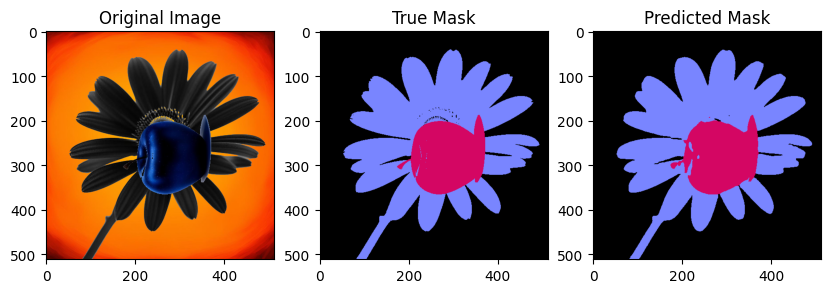

image95 IOU_apple: 0.9585650842926745
image95 IOU_flower: 0.9777973207401697
image95 IOU_back: 0.9939804840958053


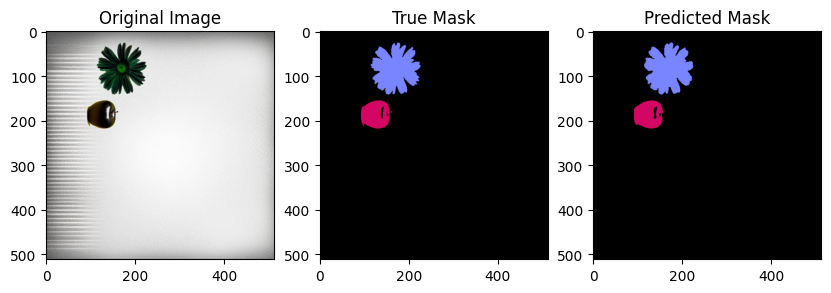

image96 IOU_apple: 0.9658536585365853
image96 IOU_flower: 0.9673763736263736
image96 IOU_back: 0.9984153278115957


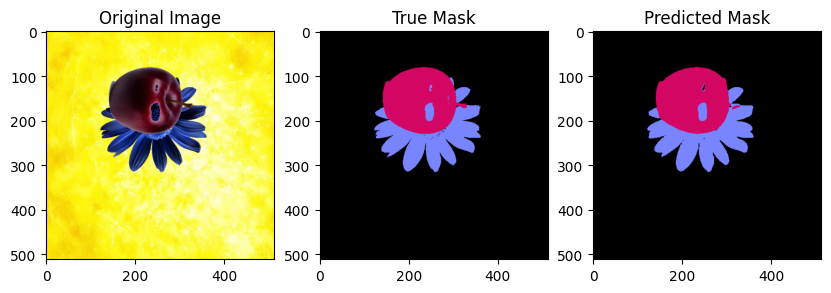

image97 IOU_apple: 0.9752159027032552
image97 IOU_flower: 0.9570095417846283
image97 IOU_back: 0.9979632947384371


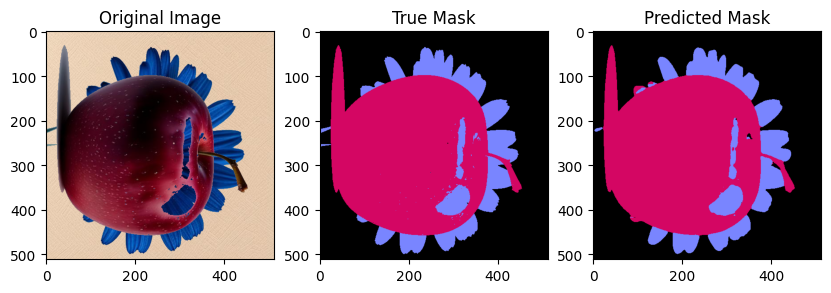

image98 IOU_apple: 0.9834567736905656
image98 IOU_flower: 0.9348986125933831
image98 IOU_back: 0.992805583631111


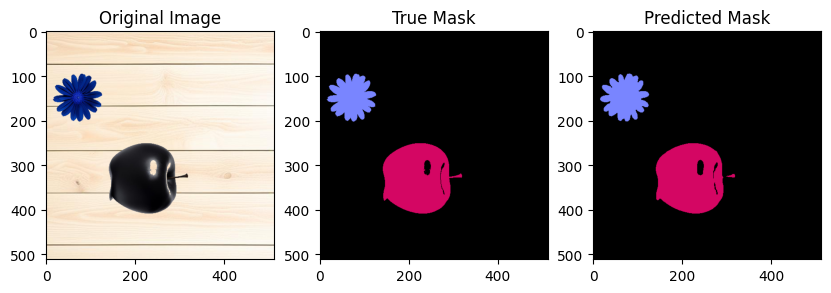

image99 IOU_apple: 0.9881141451918644
image99 IOU_flower: 0.9781173119254176
image99 IOU_back: 0.998295814333009


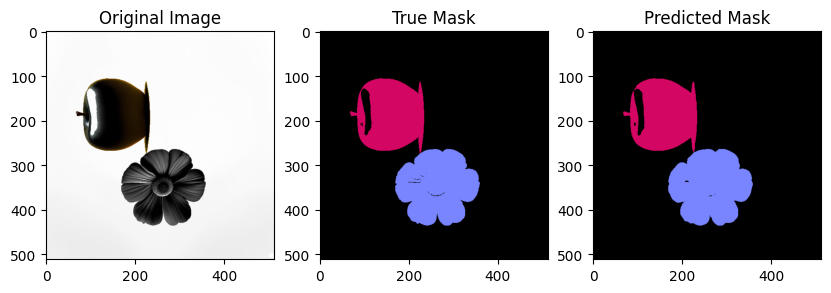

image100 IOU_apple: 0.9905402670983408
image100 IOU_flower: 0.9891856193503117
image100 IOU_back: 0.9979734211669983


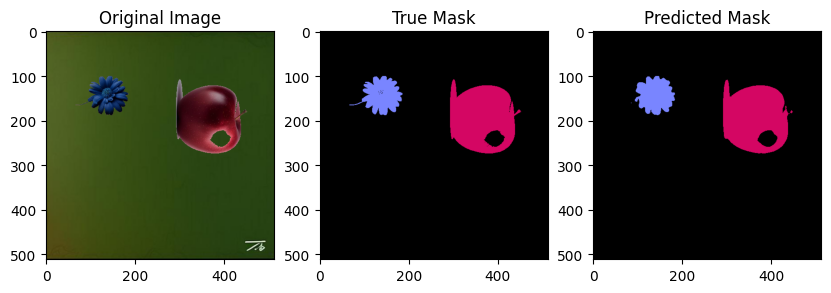

image101 IOU_apple: 0.9815352583420086
image101 IOU_flower: 0.9385317878468563
image101 IOU_back: 0.997124151268806


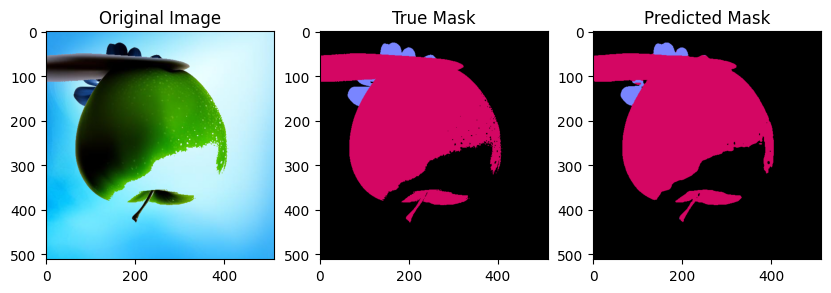

image102 IOU_apple: 0.9851645473162832
image102 IOU_flower: 0.8714893617021277
image102 IOU_back: 0.9937907252864617


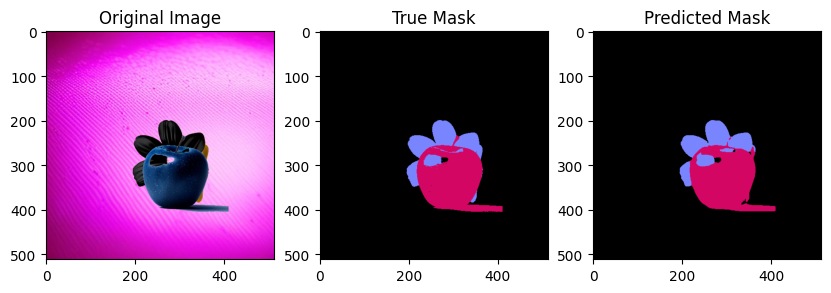

image103 IOU_apple: 0.9410791128765309
image103 IOU_flower: 0.8828521049151422
image103 IOU_back: 0.9985308002692828


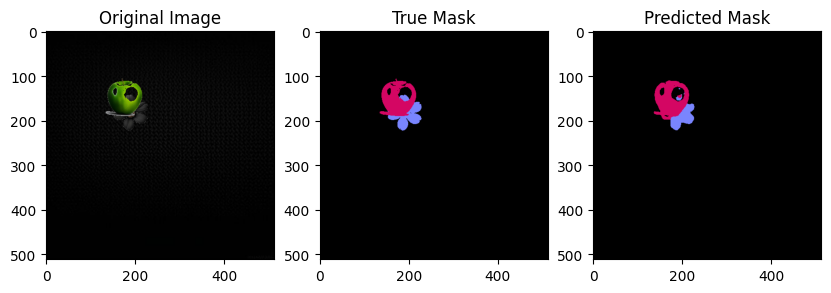

image104 IOU_apple: 0.8831197525408749
image104 IOU_flower: 0.7470562581770607
image104 IOU_back: 0.9976617911694557


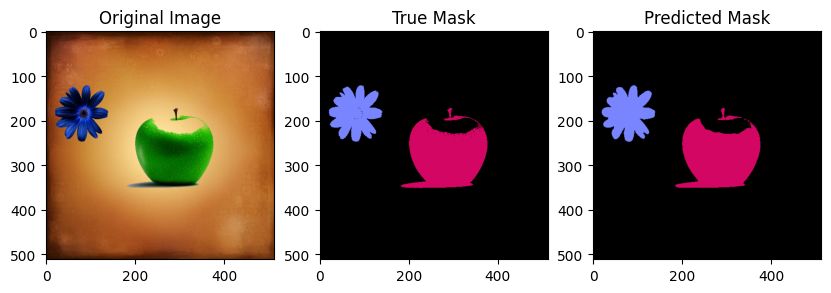

image105 IOU_apple: 0.9813691096994406
image105 IOU_flower: 0.9773713577185369
image105 IOU_back: 0.9973618870266915


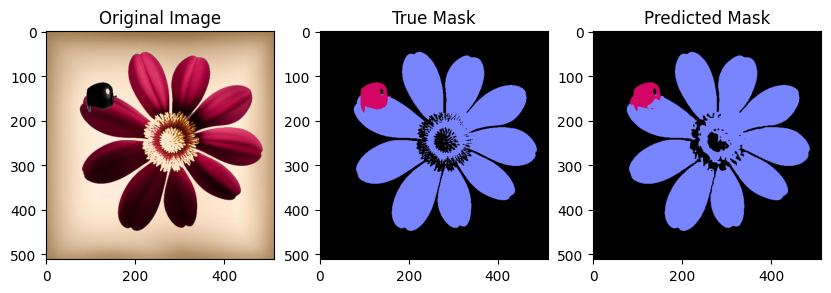

image106 IOU_apple: 0.8079165388155876
image106 IOU_flower: 0.9600043006128374
image106 IOU_back: 0.9814994959231681


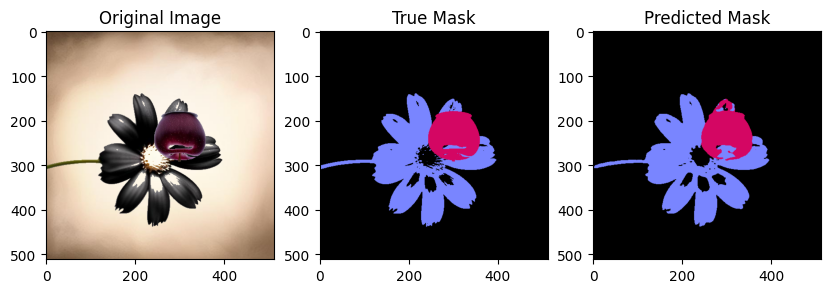

image107 IOU_apple: 0.8542454134783811
image107 IOU_flower: 0.926317783309882
image107 IOU_back: 0.9940131618334461


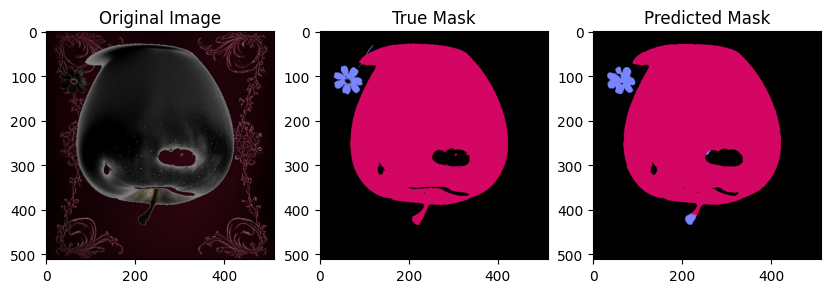

image108 IOU_apple: 0.9867417964865761
image108 IOU_flower: 0.711104331909701
image108 IOU_back: 0.990738047972486


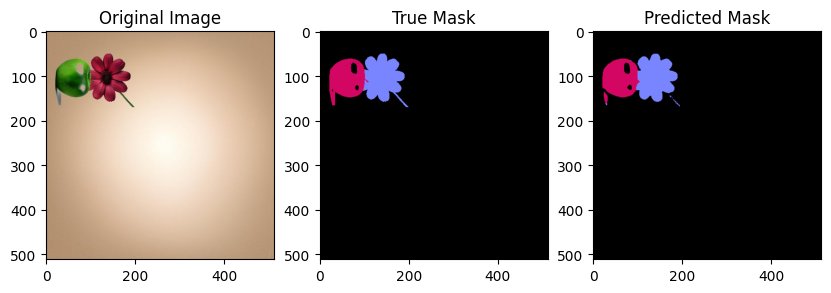

image109 IOU_apple: 0.9372643126499829
image109 IOU_flower: 0.956426116838488
image109 IOU_back: 0.998033025935214


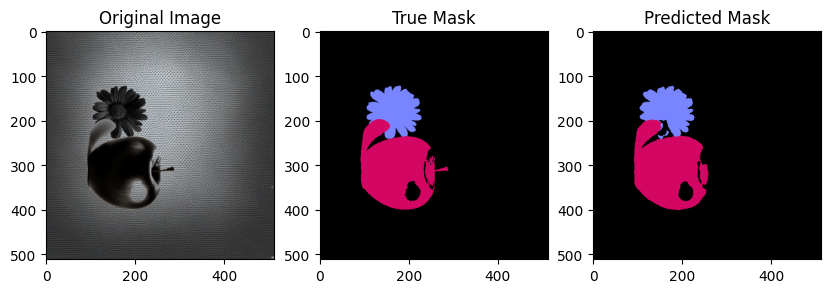

image110 IOU_apple: 0.9484639080842561
image110 IOU_flower: 0.9039201414162421
image110 IOU_back: 0.9915164553009143


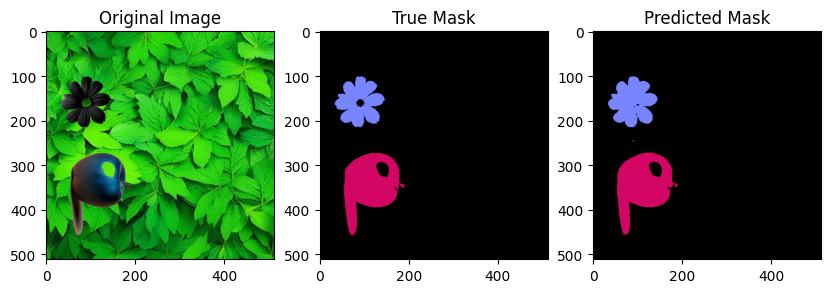

image111 IOU_apple: 0.9797795459522592
image111 IOU_flower: 0.9438935912938331
image111 IOU_back: 0.9969242391538959


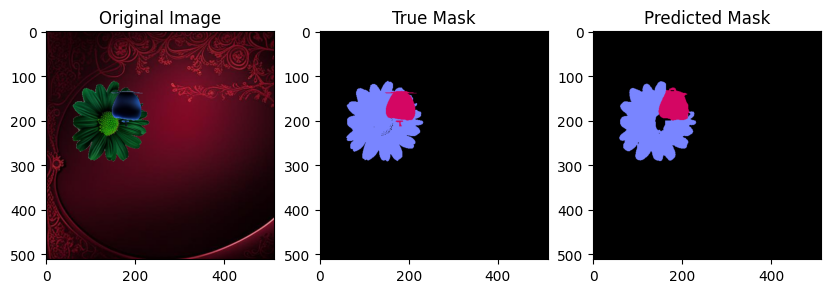

image112 IOU_apple: 0.8938661236955968
image112 IOU_flower: 0.9244192328471097
image112 IOU_back: 0.9952732986984987


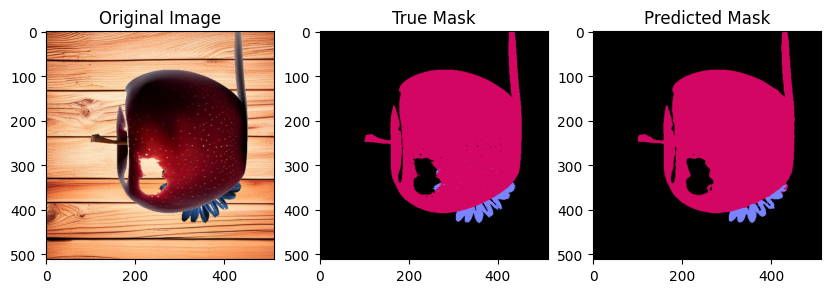

image113 IOU_apple: 0.9862130027826966
image113 IOU_flower: 0.8267567567567567
image113 IOU_back: 0.9944398955474905


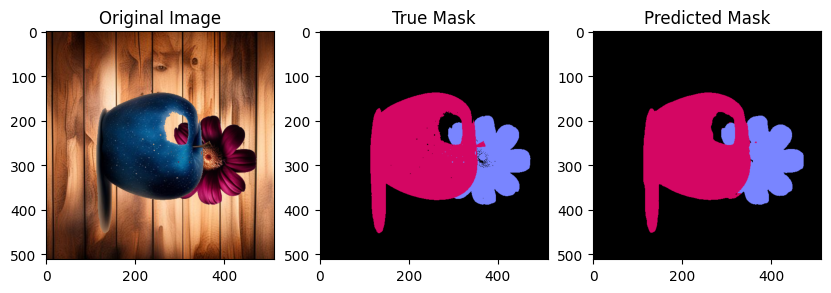

image114 IOU_apple: 0.9808133981016646
image114 IOU_flower: 0.9515345664978816
image114 IOU_back: 0.995793577511029


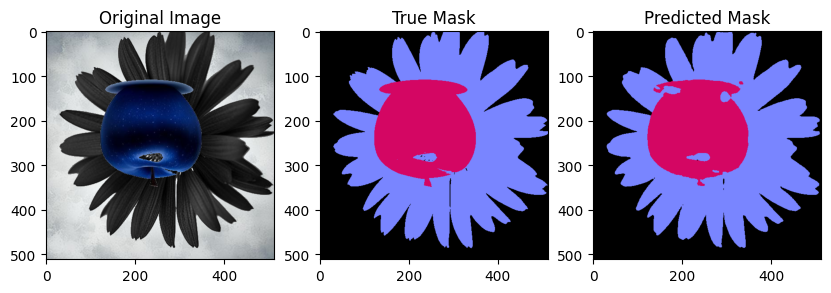

image115 IOU_apple: 0.9538590203106332
image115 IOU_flower: 0.9713973779425963
image115 IOU_back: 0.9888409502503462


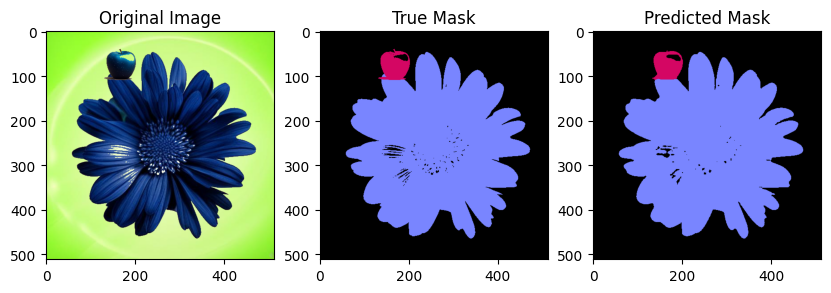

image116 IOU_apple: 0.9281575898030128
image116 IOU_flower: 0.9866234515340456
image116 IOU_back: 0.9897748481118215


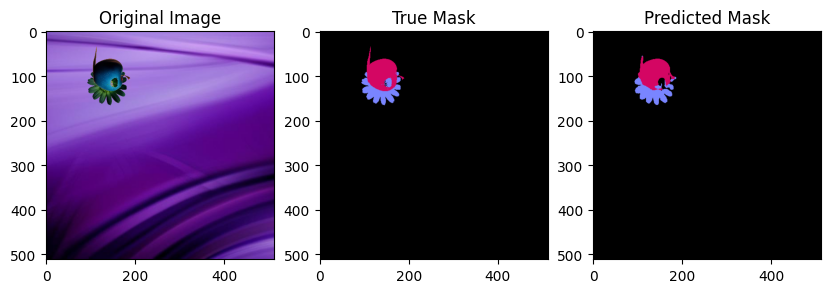

image117 IOU_apple: 0.8632765651235308
image117 IOU_flower: 0.745136186770428
image117 IOU_back: 0.9975145278970796


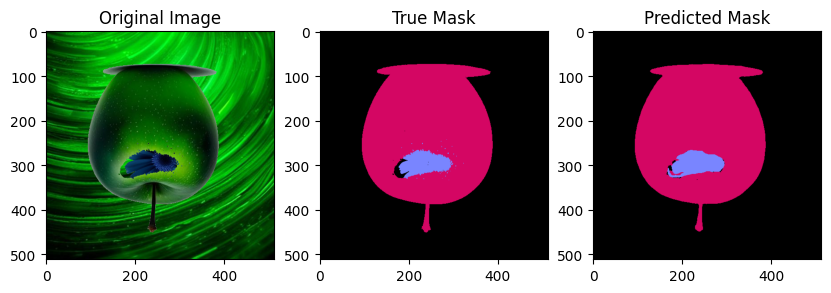

image118 IOU_apple: 0.9855194268393497
image118 IOU_flower: 0.8926681783824642
image118 IOU_back: 0.994670647066431


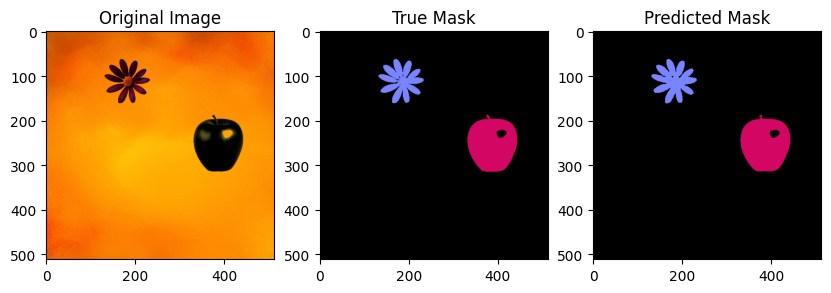

image119 IOU_apple: 0.9909892997935048
image119 IOU_flower: 0.9489720998531571
image119 IOU_back: 0.9984822414128953


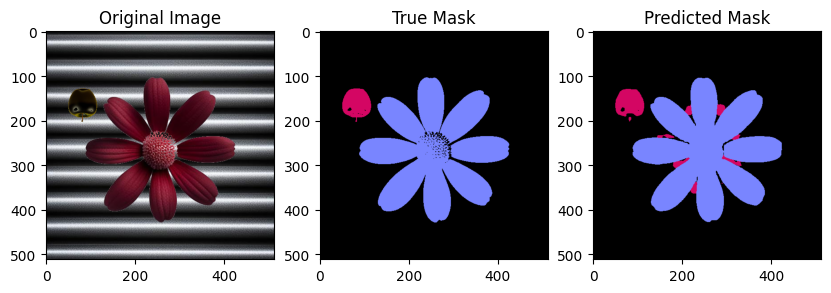

image120 IOU_apple: 0.5948163341413388
image120 IOU_flower: 0.9750026184408058
image120 IOU_back: 0.9824453417372464


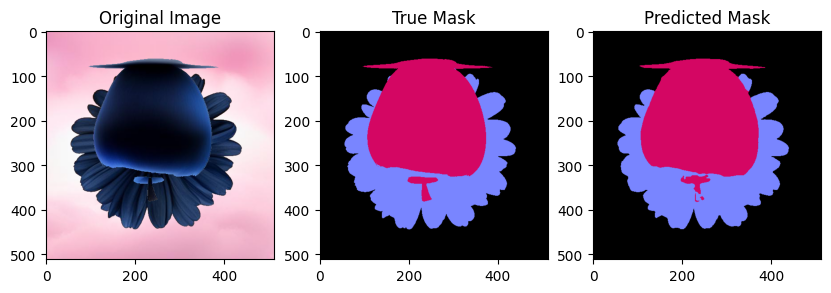

image121 IOU_apple: 0.982121754397812
image121 IOU_flower: 0.9746389647196115
image121 IOU_back: 0.9971717792196159


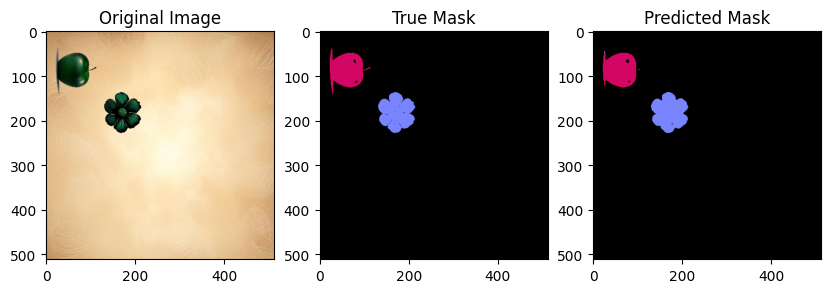

image122 IOU_apple: 0.952034597994889
image122 IOU_flower: 0.9763269835398557
image122 IOU_back: 0.9986032411155025


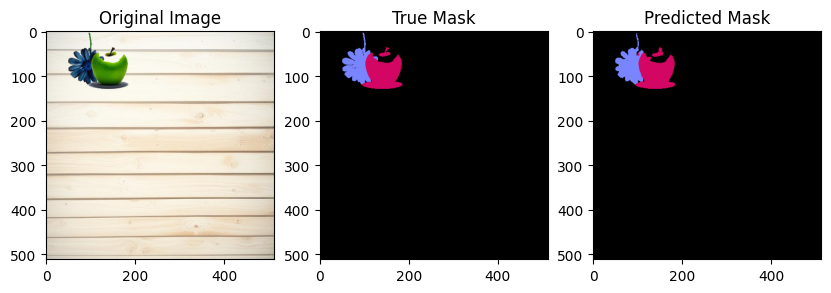

image123 IOU_apple: 0.9545284431137725
image123 IOU_flower: 0.9129725319553984
image123 IOU_back: 0.9985448895653991


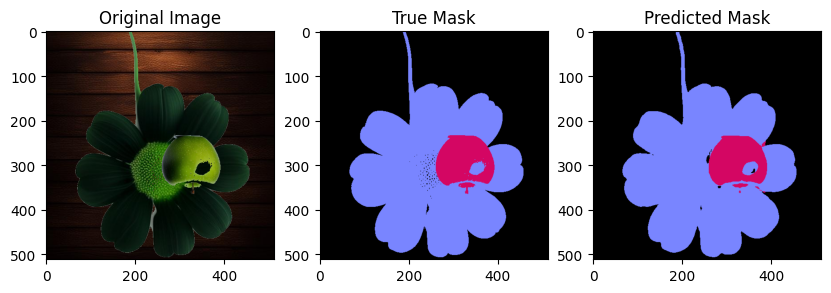

image124 IOU_apple: 0.9482496194824962
image124 IOU_flower: 0.9841798589300255
image124 IOU_back: 0.9932756231806684


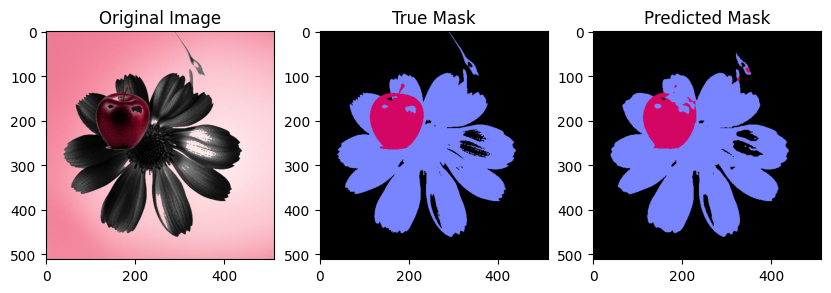

image125 IOU_apple: 0.8601197801296251
image125 IOU_flower: 0.9568154163252129
image125 IOU_back: 0.9893655162842339


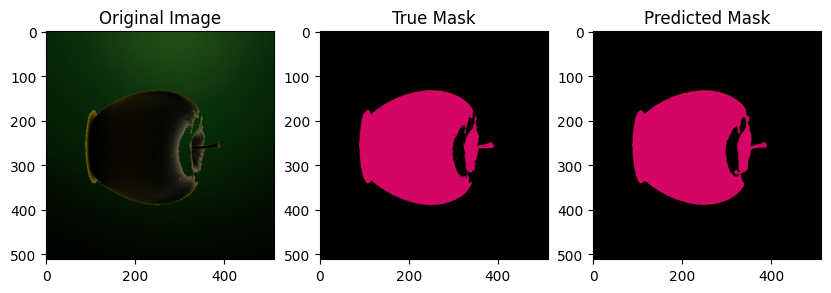

image126 IOU_apple: 0.98453426412432
image126 IOU_flower: 1
image126 IOU_back: 0.9960165649687255


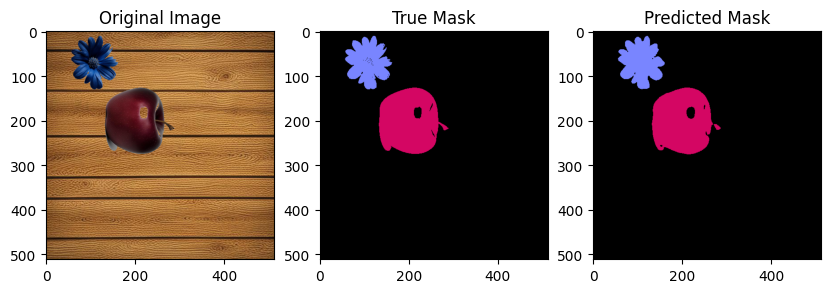

image127 IOU_apple: 0.9796546727843516
image127 IOU_flower: 0.9634206623826
image127 IOU_back: 0.9973416876293985


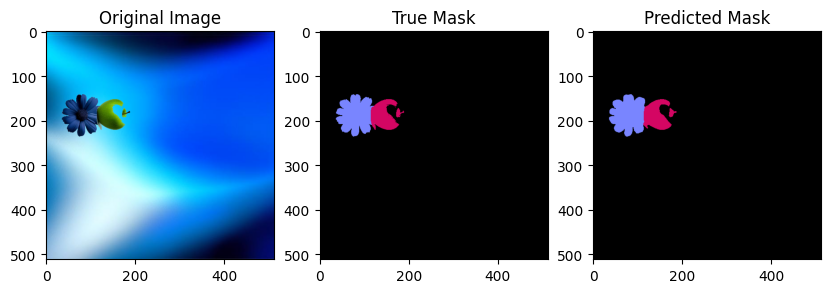

image128 IOU_apple: 0.9369510664993727
image128 IOU_flower: 0.9681674287724235
image128 IOU_back: 0.9986752303561501


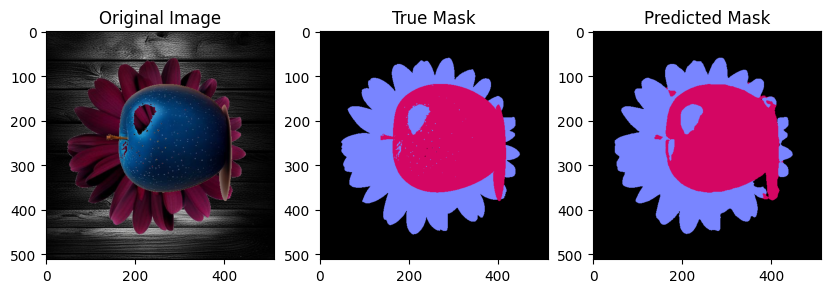

image129 IOU_apple: 0.9605544539056728
image129 IOU_flower: 0.9420024829715129
image129 IOU_back: 0.9882778675282714


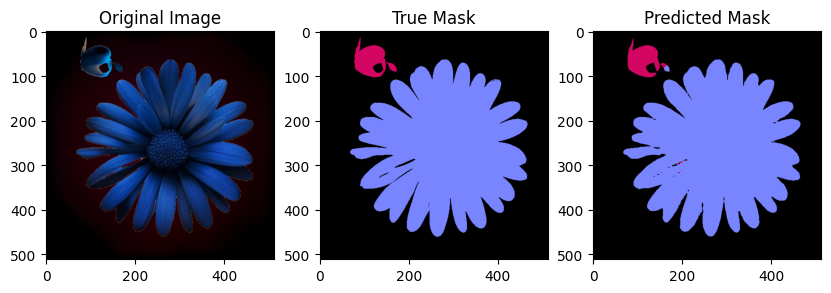

image130 IOU_apple: 0.9131847725162489
image130 IOU_flower: 0.9847461767723653
image130 IOU_back: 0.9893266712436748


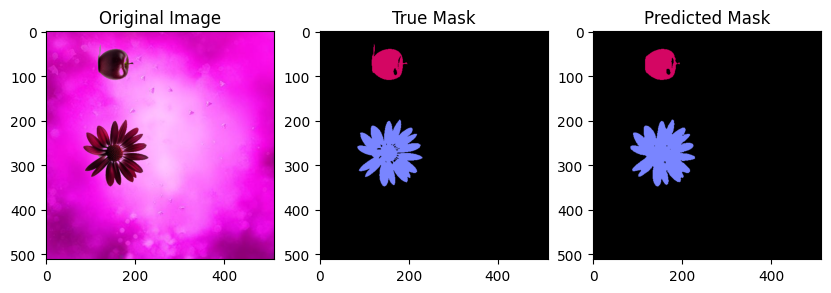

image131 IOU_apple: 0.9440854870775348
image131 IOU_flower: 0.9610711245259654
image131 IOU_back: 0.9970397719648514


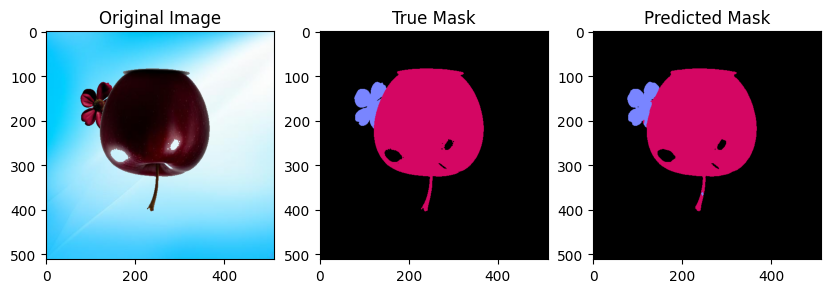

image132 IOU_apple: 0.9924211720839751
image132 IOU_flower: 0.9513920584208124
image132 IOU_back: 0.9983292002183051


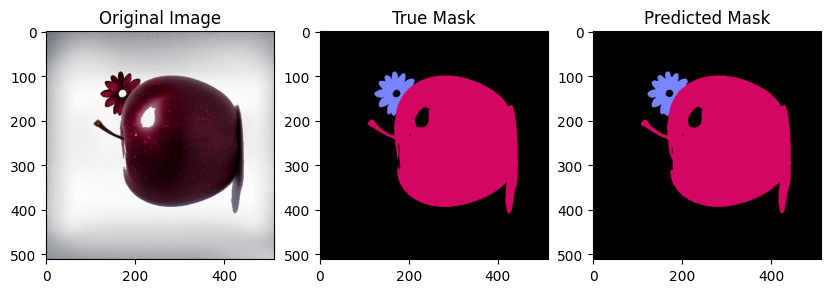

image133 IOU_apple: 0.9951100599271587
image133 IOU_flower: 0.9684354986276303
image133 IOU_back: 0.9977760521492


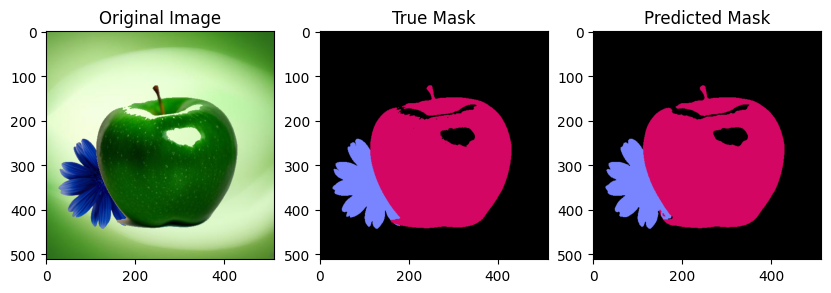

image134 IOU_apple: 0.9920040527403918
image134 IOU_flower: 0.976193724420191
image134 IOU_back: 0.9964559649363101


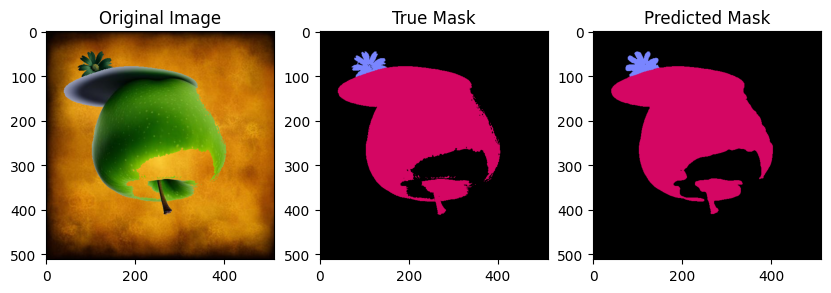

image135 IOU_apple: 0.9825202389254419
image135 IOU_flower: 0.90859375
image135 IOU_back: 0.9931839162991076


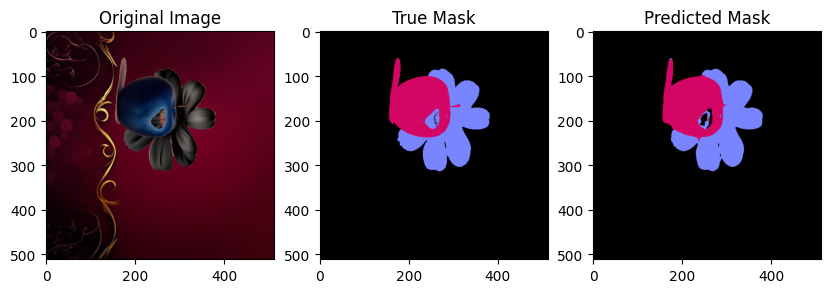

image136 IOU_apple: 0.9597672064777328
image136 IOU_flower: 0.9377380529175765
image136 IOU_back: 0.9956067468442675


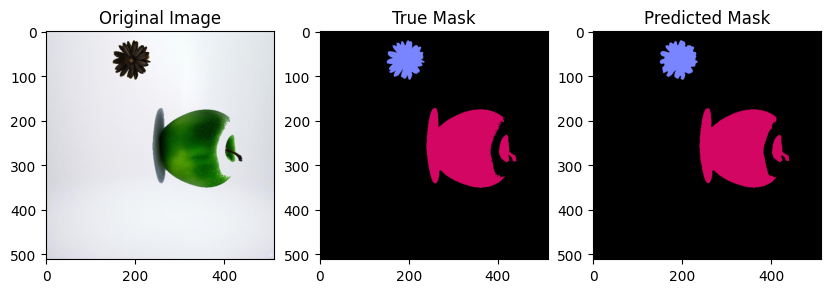

image137 IOU_apple: 0.9877065699314792
image137 IOU_flower: 0.9601202404809619
image137 IOU_back: 0.9978354978354979


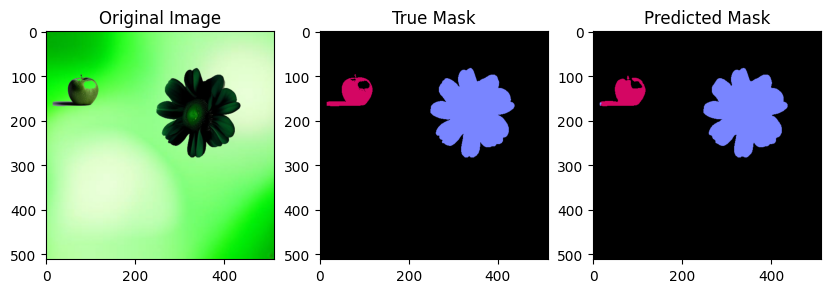

image138 IOU_apple: 0.9178832116788321
image138 IOU_flower: 0.9928403900752993
image138 IOU_back: 0.9981021188030981


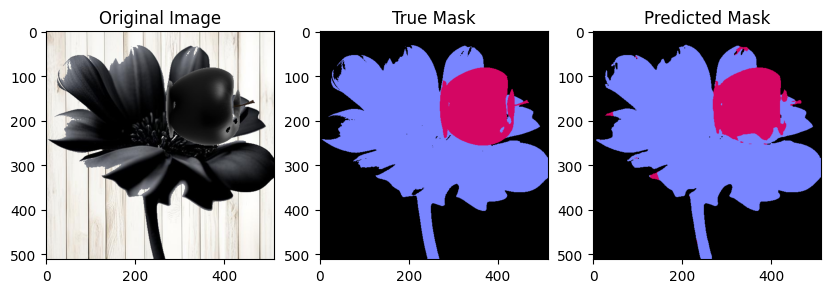

image139 IOU_apple: 0.8561092922678954
image139 IOU_flower: 0.9559101226467278
image139 IOU_back: 0.9905672746343454


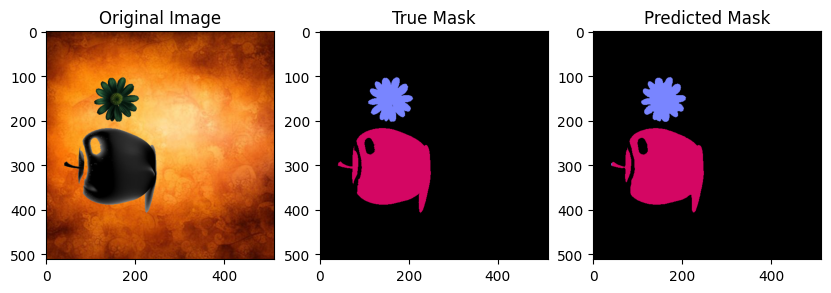

image140 IOU_apple: 0.9903538280711709
image140 IOU_flower: 0.9745826440066175
image140 IOU_back: 0.9983262621151376


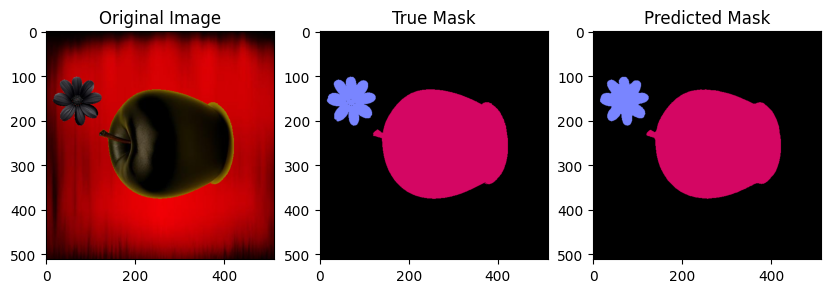

image141 IOU_apple: 0.9944594861128544
image141 IOU_flower: 0.9810236536148603
image141 IOU_back: 0.9977375452114718


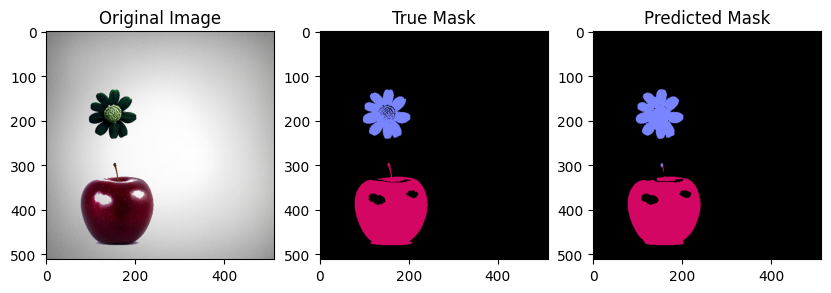

image142 IOU_apple: 0.9767569729081276
image142 IOU_flower: 0.9379885356956749
image142 IOU_back: 0.9963163753473314


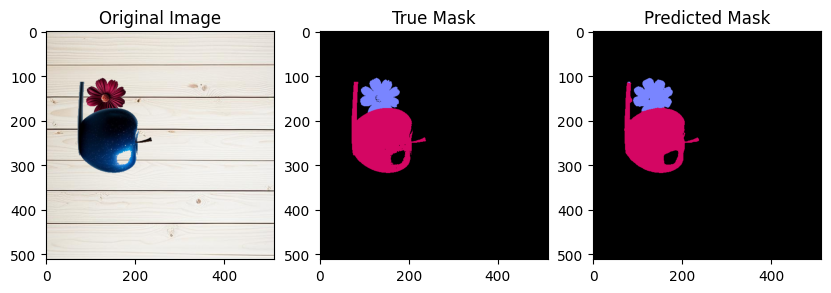

image143 IOU_apple: 0.9820187985288108
image143 IOU_flower: 0.9605879846612697
image143 IOU_back: 0.9982432022726234


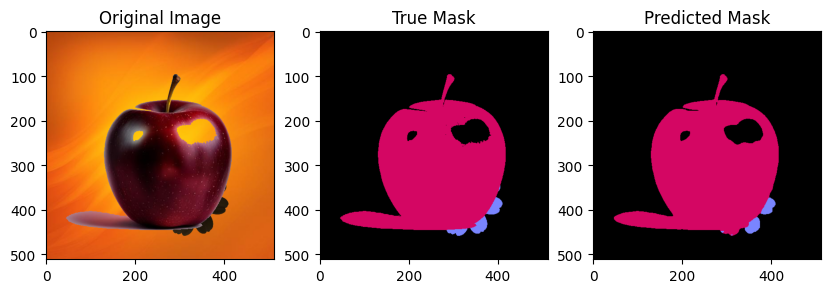

image144 IOU_apple: 0.9870350450093416
image144 IOU_flower: 0.727865796831314
image144 IOU_back: 0.997131885968829


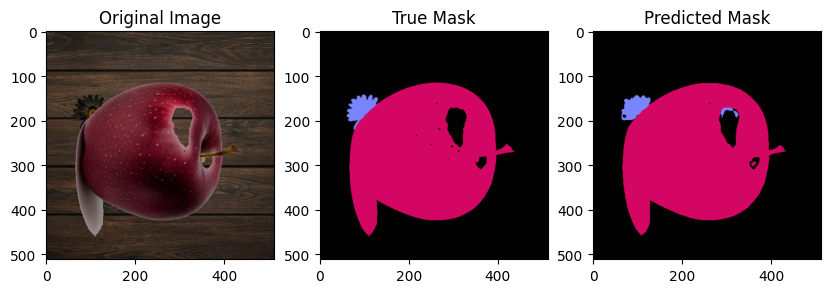

image145 IOU_apple: 0.9904026075934086
image145 IOU_flower: 0.7468852459016393
image145 IOU_back: 0.9916024050981782


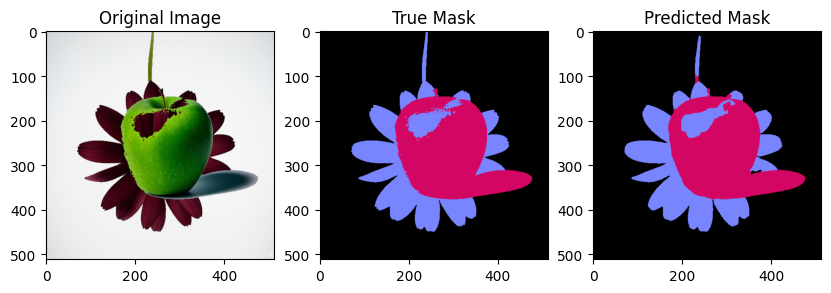

image146 IOU_apple: 0.9656290845718158
image146 IOU_flower: 0.9481918028395393
image146 IOU_back: 0.9964098970405908


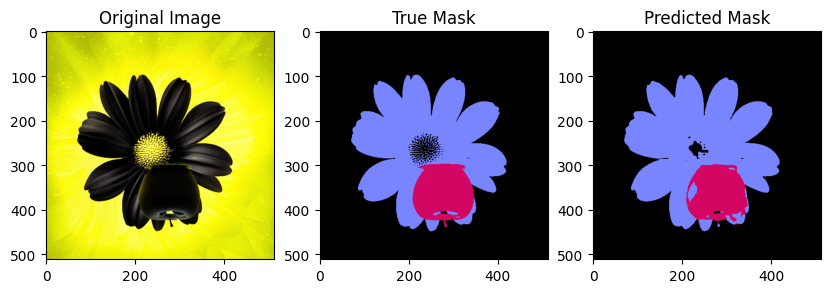

image147 IOU_apple: 0.8716861081654295
image147 IOU_flower: 0.9424888008397522
image147 IOU_back: 0.9885809016397913


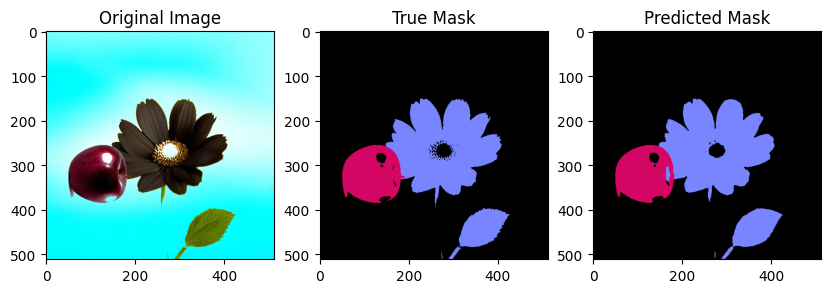

image148 IOU_apple: 0.9629215992852357
image148 IOU_flower: 0.9700771303782176
image148 IOU_back: 0.9943999768274904


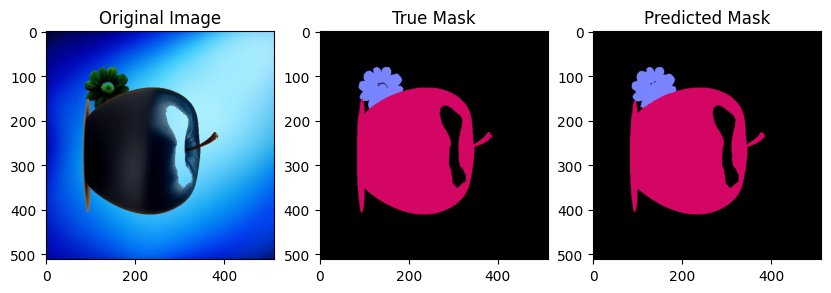

image149 IOU_apple: 0.9928731487877613
image149 IOU_flower: 0.965670367207515
image149 IOU_back: 0.9973874211416363


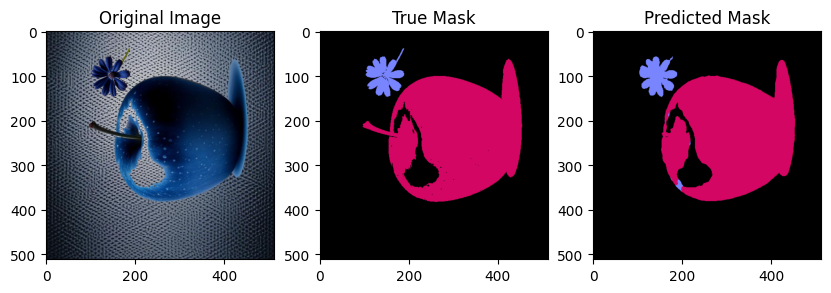

image150 IOU_apple: 0.9654507057232714
image150 IOU_flower: 0.8767441860465116
image150 IOU_back: 0.9875558490604975


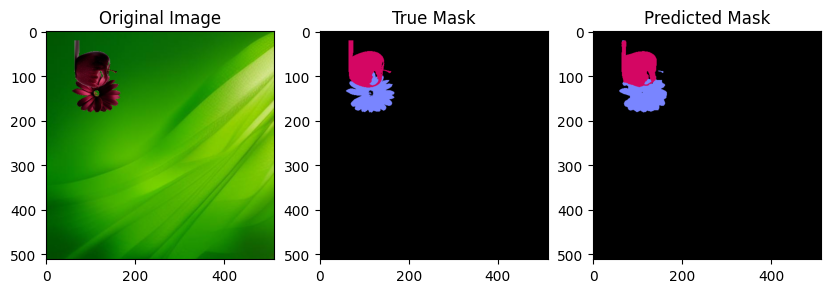

image151 IOU_apple: 0.9126547455295736
image151 IOU_flower: 0.8776715899218072
image151 IOU_back: 0.9978762835757976


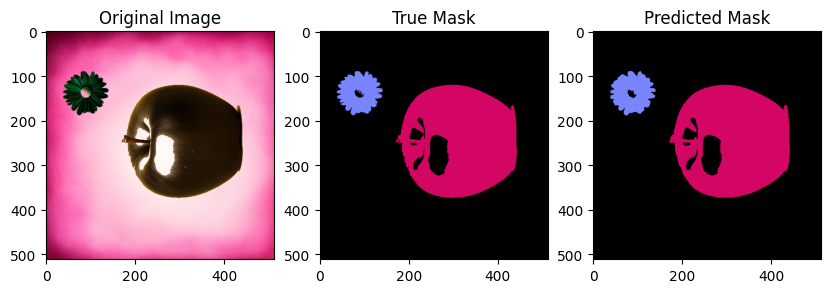

image152 IOU_apple: 0.9909382631334639
image152 IOU_flower: 0.9649174097354188
image152 IOU_back: 0.9966625170143817


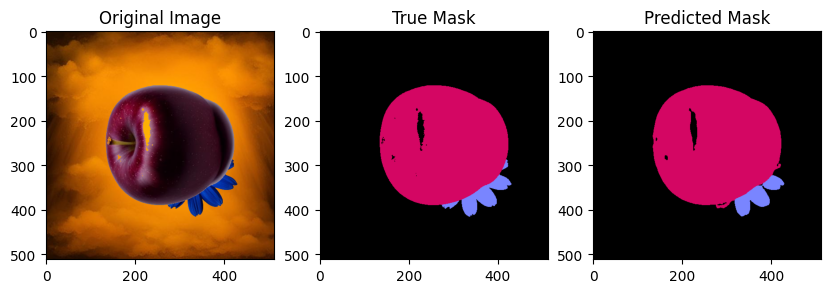

image153 IOU_apple: 0.9877479770294962
image153 IOU_flower: 0.8669565217391304
image153 IOU_back: 0.9967300711779855


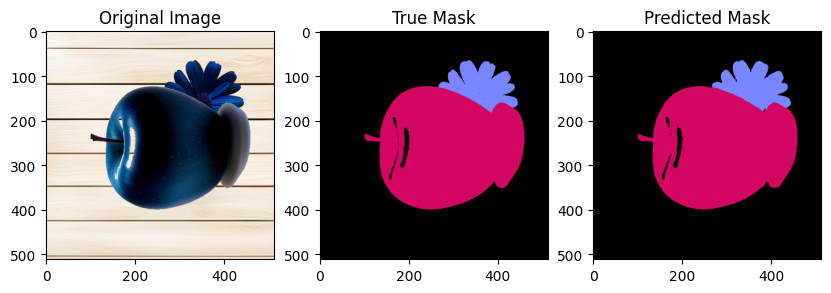

image154 IOU_apple: 0.9934596463045567
image154 IOU_flower: 0.9801875110560764
image154 IOU_back: 0.9970394990260062


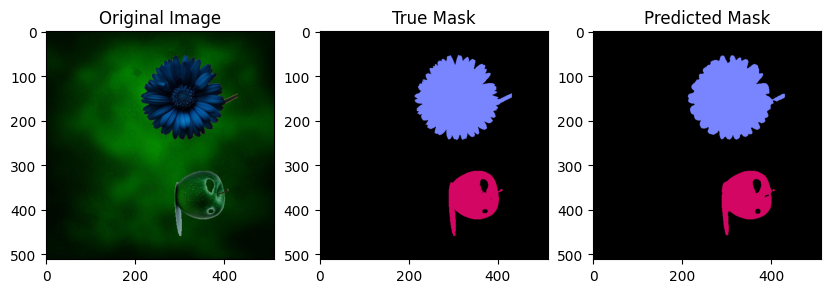

image155 IOU_apple: 0.9762768356043525
image155 IOU_flower: 0.9786500309981401
image155 IOU_back: 0.9965054995417049


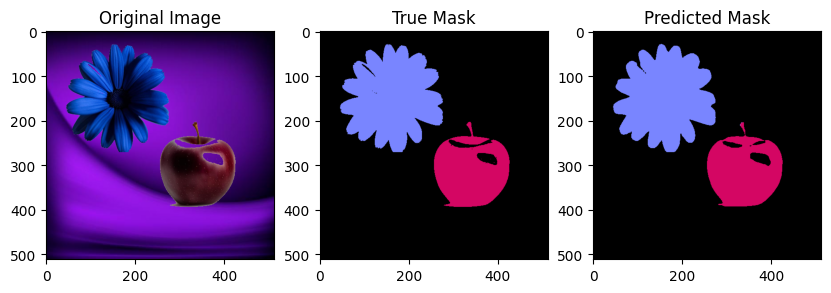

image156 IOU_apple: 0.9717105884575423
image156 IOU_flower: 0.9851211712783108
image156 IOU_back: 0.9943804274399616


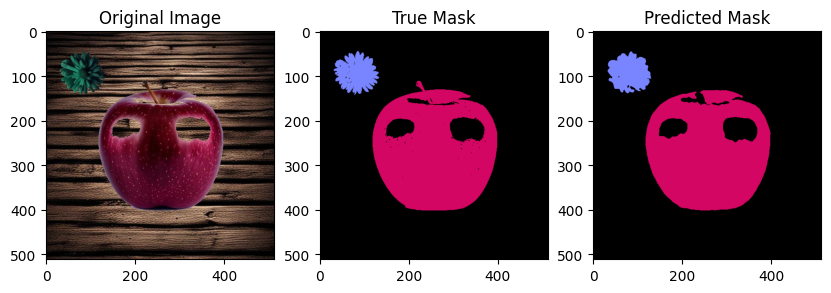

image157 IOU_apple: 0.967854807641331
image157 IOU_flower: 0.9100890207715133
image157 IOU_back: 0.9879498315460987


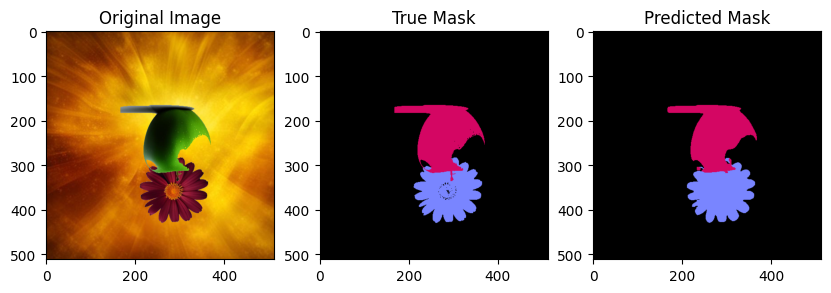

image158 IOU_apple: 0.9656899109792285
image158 IOU_flower: 0.9467186945725434
image158 IOU_back: 0.9971313235420425


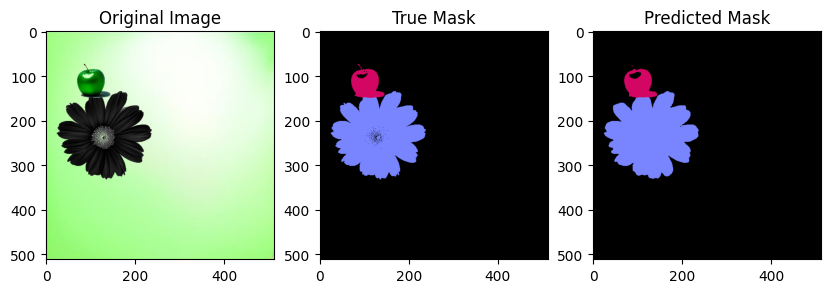

image159 IOU_apple: 0.9316338354577057
image159 IOU_flower: 0.9819128029696484
image159 IOU_back: 0.9970550443683652


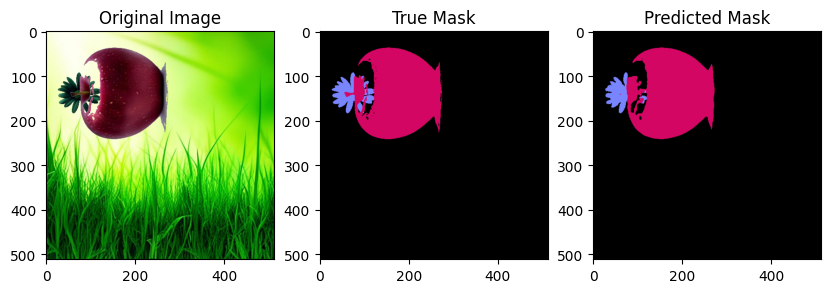

image160 IOU_apple: 0.9629378092558455
image160 IOU_flower: 0.7245095330201713
image160 IOU_back: 0.9956321778894823


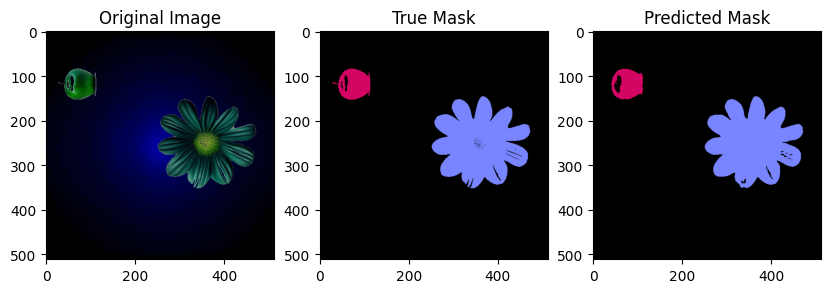

image161 IOU_apple: 0.8972917731221257
image161 IOU_flower: 0.9788939902693072
image161 IOU_back: 0.9955751058410341


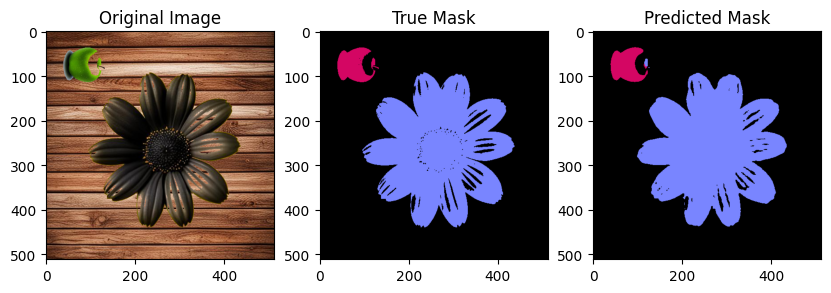

image162 IOU_apple: 0.9282265144863916
image162 IOU_flower: 0.9500781991844942
image162 IOU_back: 0.9806286723052197


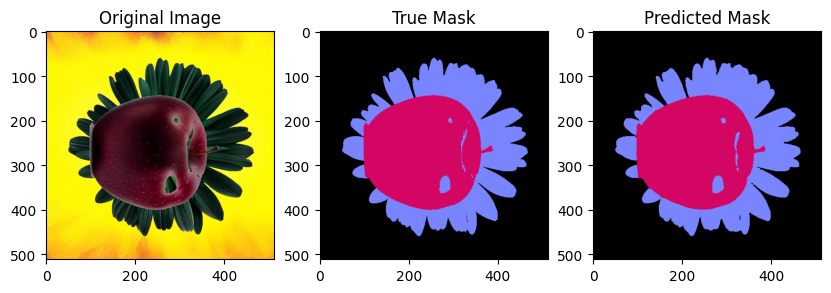

image163 IOU_apple: 0.9840816025380897
image163 IOU_flower: 0.9747820448159089
image163 IOU_back: 0.9963140890209259


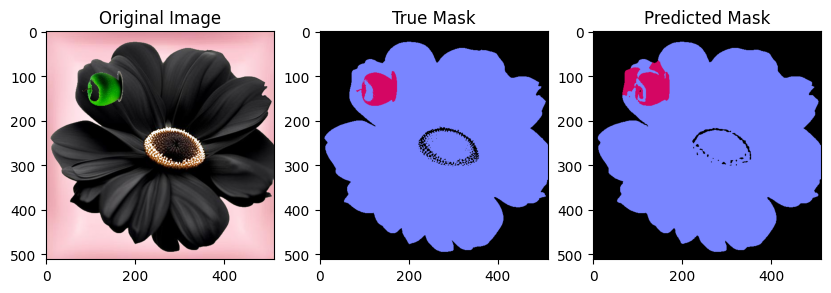

image164 IOU_apple: 0.6008508141411177
image164 IOU_flower: 0.9726697940036713
image164 IOU_back: 0.9802646405460224


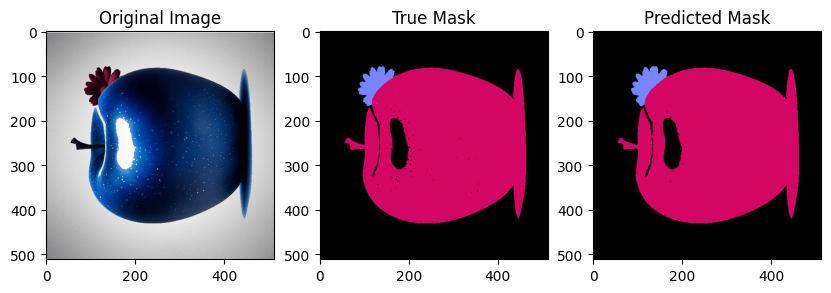

image165 IOU_apple: 0.9932767027274112
image165 IOU_flower: 0.9656821378340366
image165 IOU_back: 0.9950769230769231


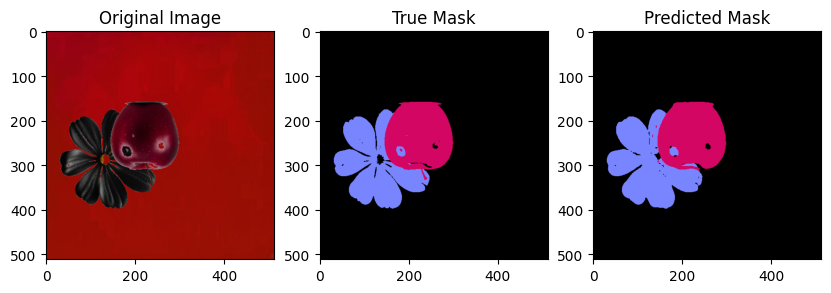

image166 IOU_apple: 0.9612661604760927
image166 IOU_flower: 0.9383019718771779
image166 IOU_back: 0.9937476428704499


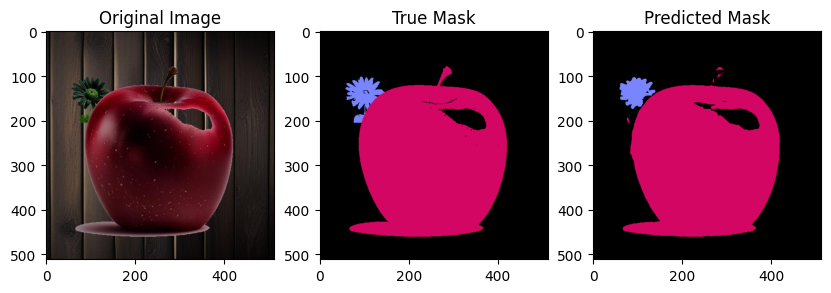

image167 IOU_apple: 0.9834386186565592
image167 IOU_flower: 0.7563920454545454
image167 IOU_back: 0.9847135451282732


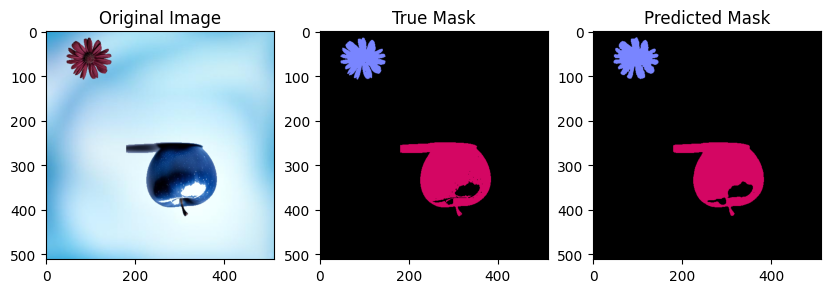

image168 IOU_apple: 0.9791244742171678
image168 IOU_flower: 0.9543063773833005
image168 IOU_back: 0.9971366371487643


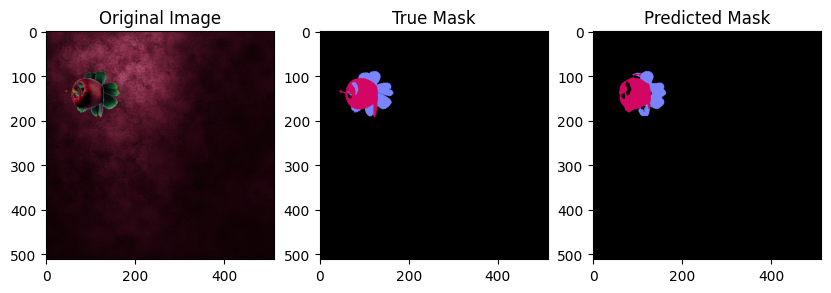

image169 IOU_apple: 0.8464513193812557
image169 IOU_flower: 0.7375434530706837
image169 IOU_back: 0.9968413636541548


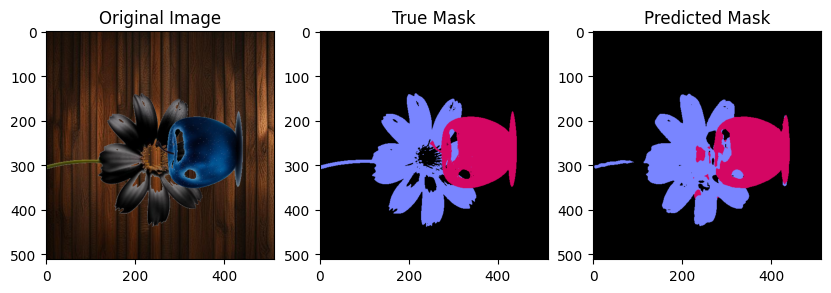

image170 IOU_apple: 0.9141908498986676
image170 IOU_flower: 0.8487950522499467
image170 IOU_back: 0.97359843859666


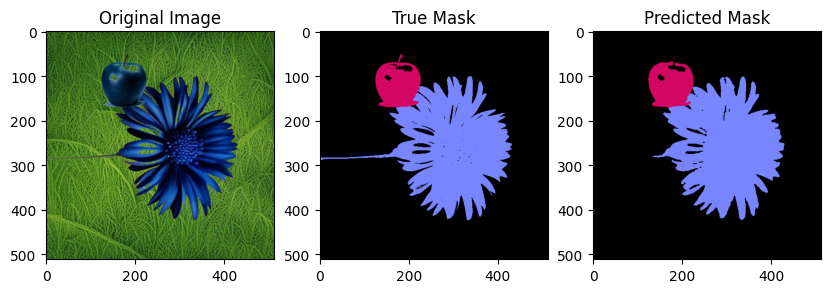

image171 IOU_apple: 0.9444378487474772
image171 IOU_flower: 0.9513595276279341
image171 IOU_back: 0.9853046790258592


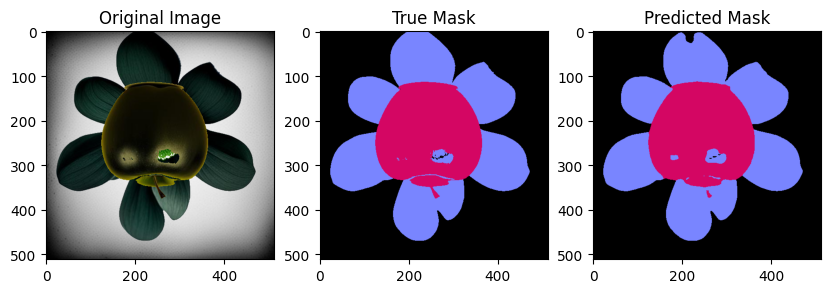

image172 IOU_apple: 0.9779658346649862
image172 IOU_flower: 0.9755683388839891
image172 IOU_back: 0.993406991234849


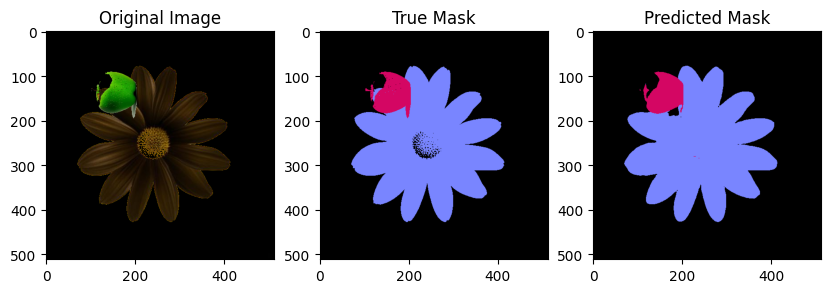

image173 IOU_apple: 0.9116145500957243
image173 IOU_flower: 0.9690333095650402
image173 IOU_back: 0.9891728752031405


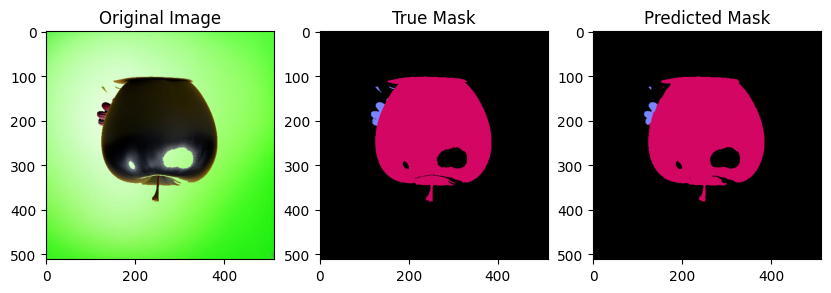

image174 IOU_apple: 0.9909999609542774
image174 IOU_flower: 0.8456221198156681
image174 IOU_back: 0.9976495614888959


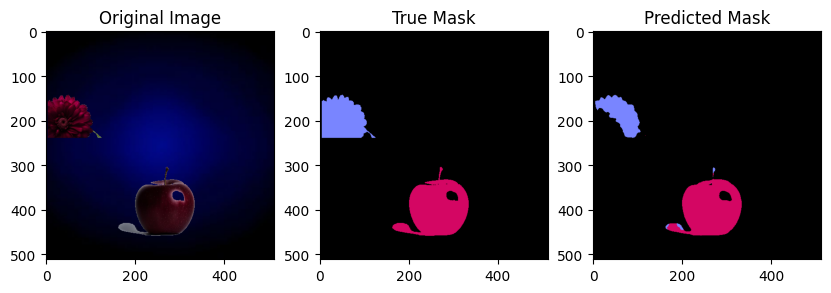

image175 IOU_apple: 0.9618194348725018
image175 IOU_flower: 0.5710922787193974
image175 IOU_back: 0.9843791129244538


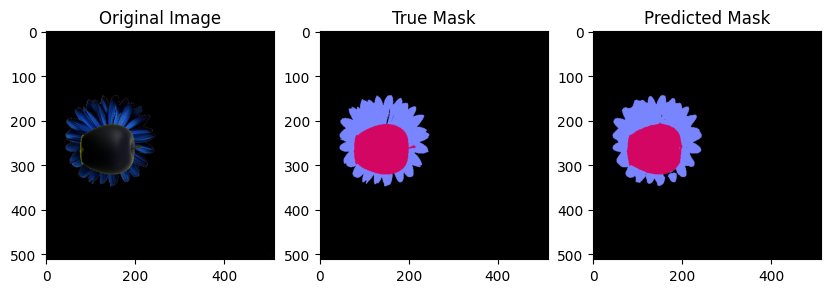

image176 IOU_apple: 0.9772315653298835
image176 IOU_flower: 0.9474708171206225
image176 IOU_back: 0.9970407992839676


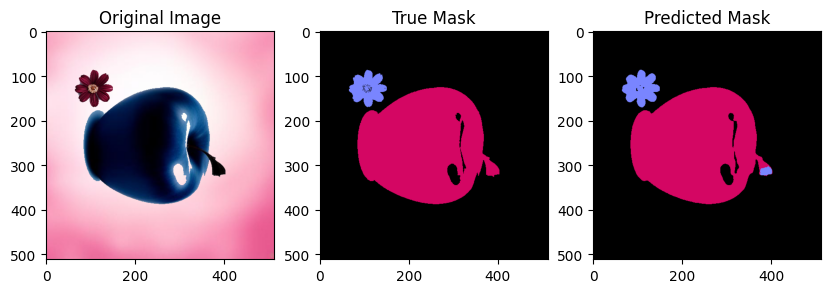

image177 IOU_apple: 0.9855427465355693
image177 IOU_flower: 0.8738041929574598
image177 IOU_back: 0.9969483063100021


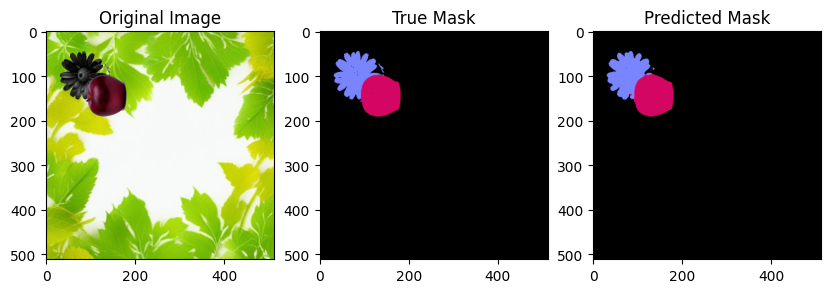

image178 IOU_apple: 0.9812490985143516
image178 IOU_flower: 0.9421672380384558
image178 IOU_back: 0.9984735952054822


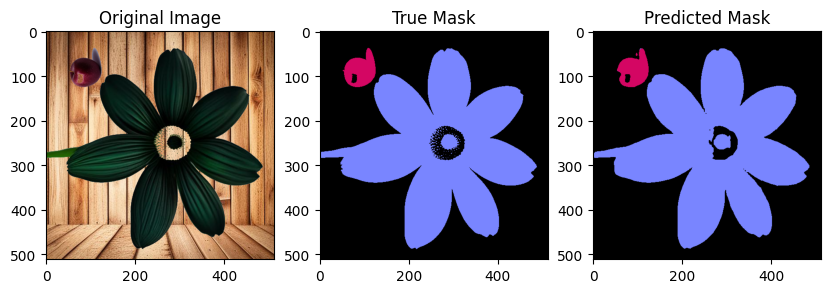

image179 IOU_apple: 0.9393418467583498
image179 IOU_flower: 0.9837923507072157
image179 IOU_back: 0.9883407678428228


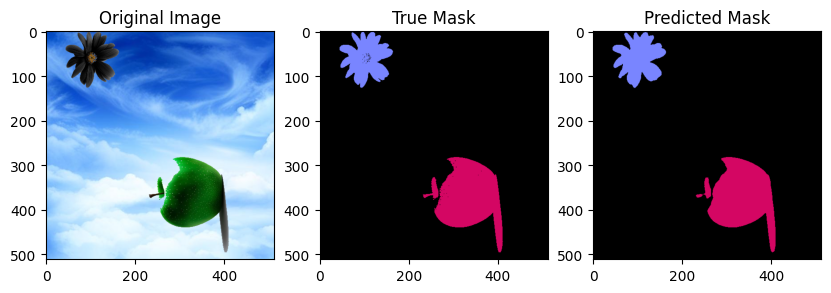

image180 IOU_apple: 0.9862526788981235
image180 IOU_flower: 0.9674651810584958
image180 IOU_back: 0.9976342005089666


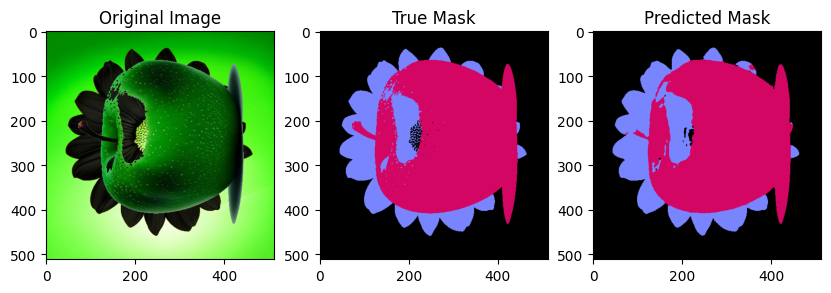

image181 IOU_apple: 0.9670960767532994
image181 IOU_flower: 0.9073669225685088
image181 IOU_back: 0.9912104488327738


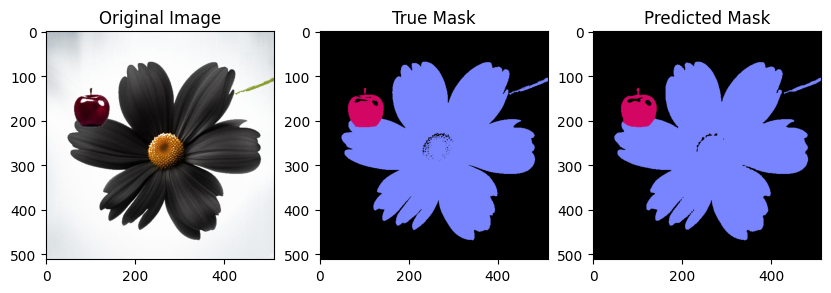

image182 IOU_apple: 0.9485903814262023
image182 IOU_flower: 0.9901774061004496
image182 IOU_back: 0.9928548858264924


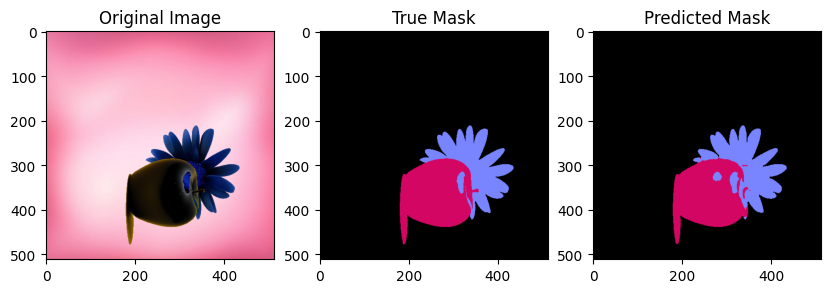

image183 IOU_apple: 0.931780211620568
image183 IOU_flower: 0.905573656039097
image183 IOU_back: 0.9986894829899334


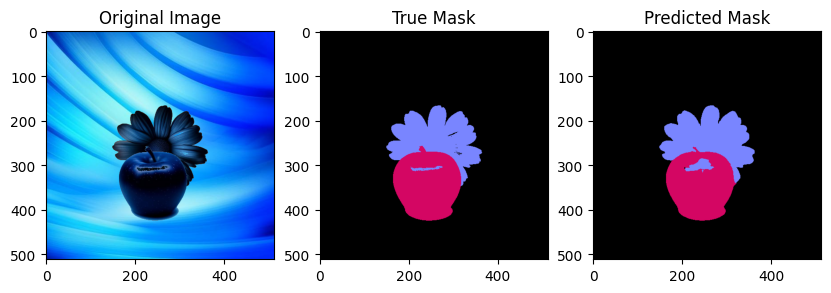

image184 IOU_apple: 0.9462805581785751
image184 IOU_flower: 0.9349781547160113
image184 IOU_back: 0.9985195920653691


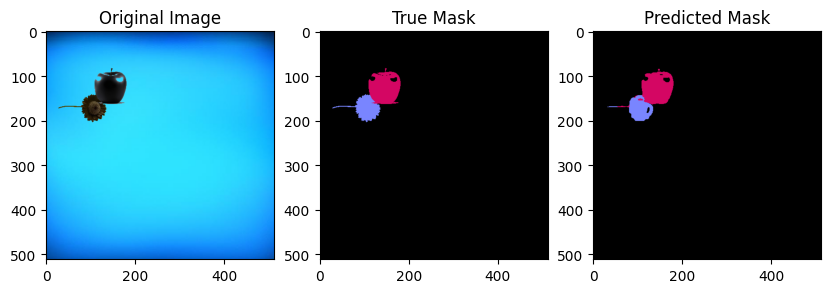

image185 IOU_apple: 0.9166481440320071
image185 IOU_flower: 0.8405458089668616
image185 IOU_back: 0.9983651503240366


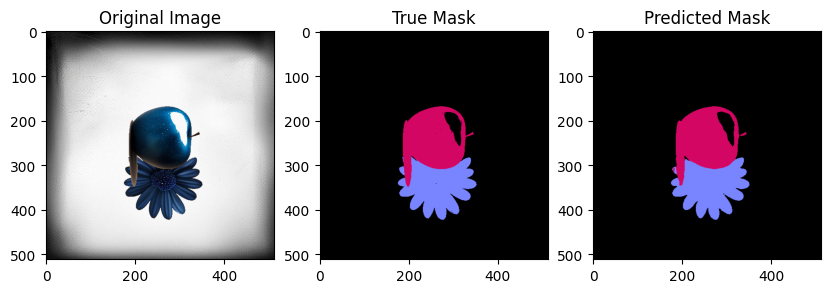

image186 IOU_apple: 0.9766612438993868
image186 IOU_flower: 0.9742526583294322
image186 IOU_back: 0.998498459626686


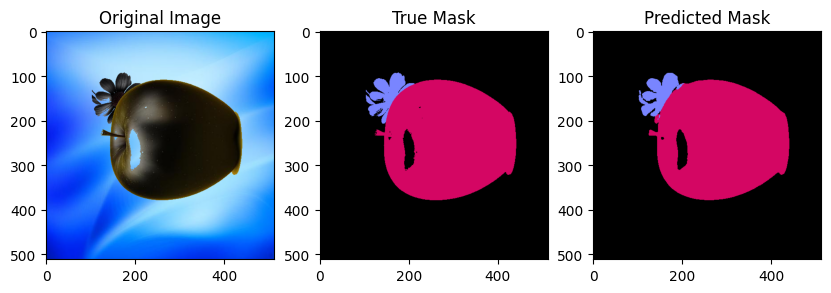

image187 IOU_apple: 0.9912001000343869
image187 IOU_flower: 0.8627037392138063
image187 IOU_back: 0.9964987366575568


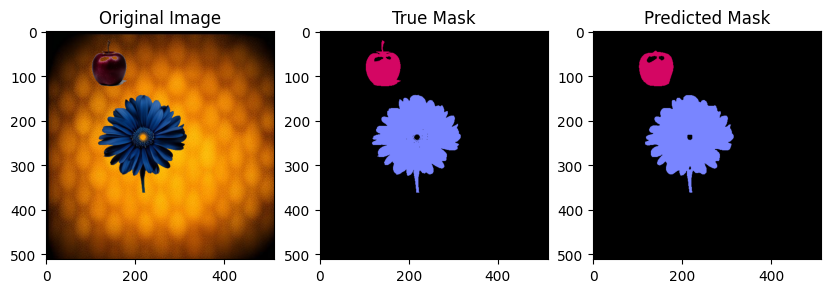

image188 IOU_apple: 0.9234582589728336
image188 IOU_flower: 0.9860282702835199
image188 IOU_back: 0.9968802362106869


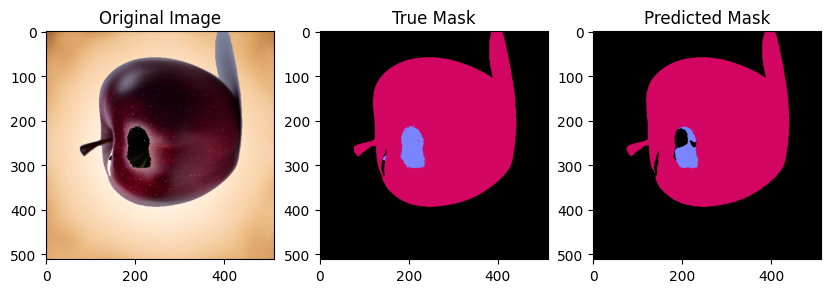

image189 IOU_apple: 0.993940660259089
image189 IOU_flower: 0.6505338078291815
image189 IOU_back: 0.9902269711902957


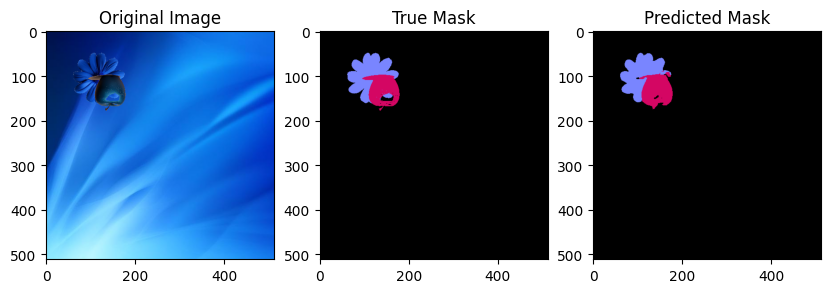

image190 IOU_apple: 0.812098382450698
image190 IOU_flower: 0.8861102261866837
image190 IOU_back: 0.9972235974414322


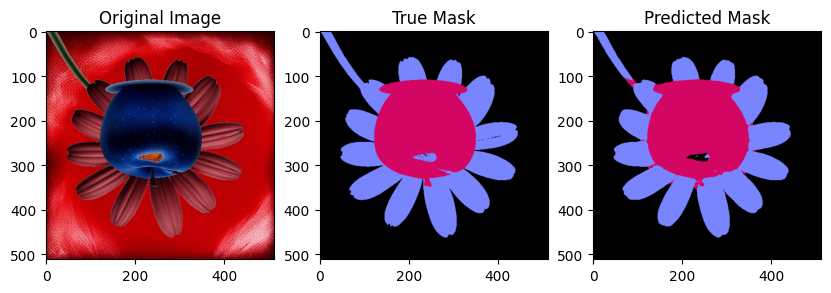

image191 IOU_apple: 0.967776004506196
image191 IOU_flower: 0.9591501590885764
image191 IOU_back: 0.9893730658186279


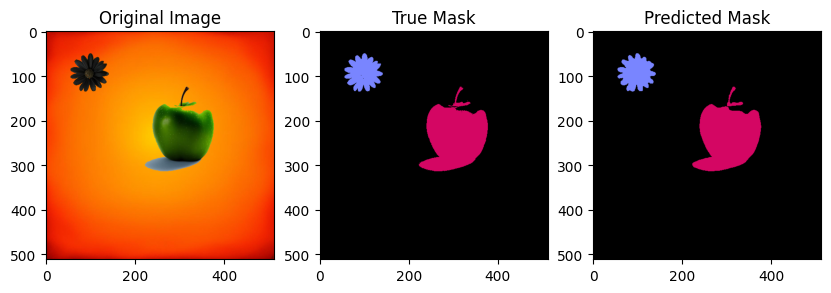

image192 IOU_apple: 0.9843970796043335
image192 IOU_flower: 0.9657661373479068
image192 IOU_back: 0.9982097016723297


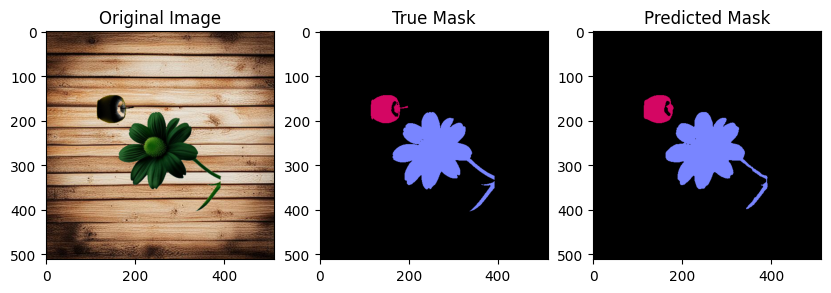

image193 IOU_apple: 0.9378161261529306
image193 IOU_flower: 0.9748773896506856
image193 IOU_back: 0.9970314639767527


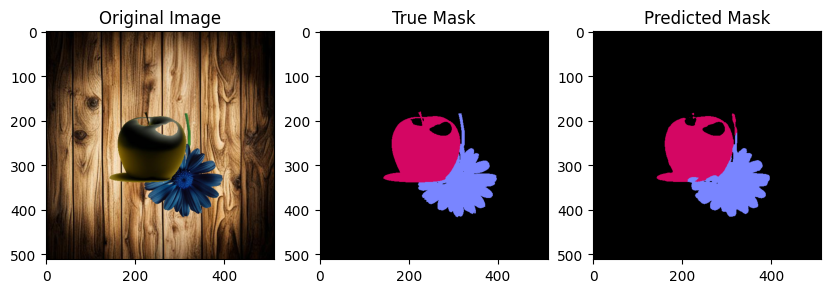

image194 IOU_apple: 0.9384942803937217
image194 IOU_flower: 0.9178934010152284
image194 IOU_back: 0.9966143401890036


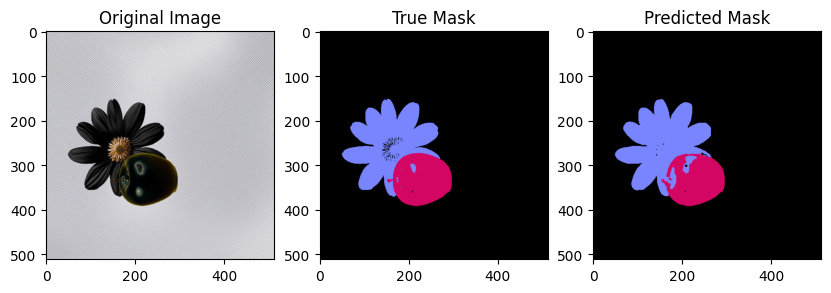

image195 IOU_apple: 0.8999840357598978
image195 IOU_flower: 0.9239278012938263
image195 IOU_back: 0.9967596680204839


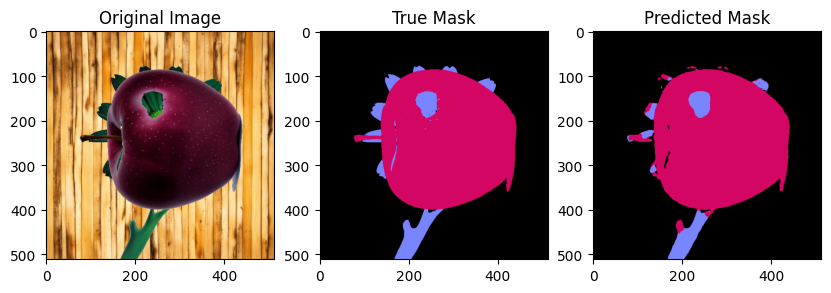

image196 IOU_apple: 0.9678016520484635
image196 IOU_flower: 0.6890210924824229
image196 IOU_back: 0.9902136793280966


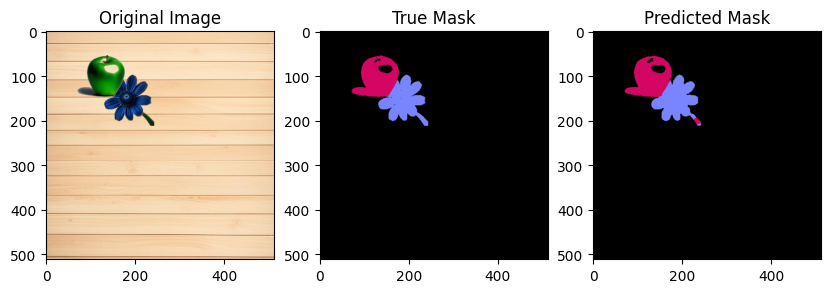

image197 IOU_apple: 0.9478776529338327
image197 IOU_flower: 0.9418849744052996
image197 IOU_back: 0.9985979193122594


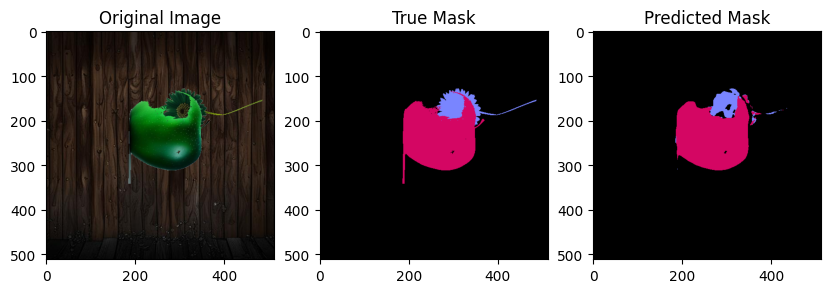

image198 IOU_apple: 0.9452365215749221
image198 IOU_flower: 0.5494962768287341
image198 IOU_back: 0.990653306680272


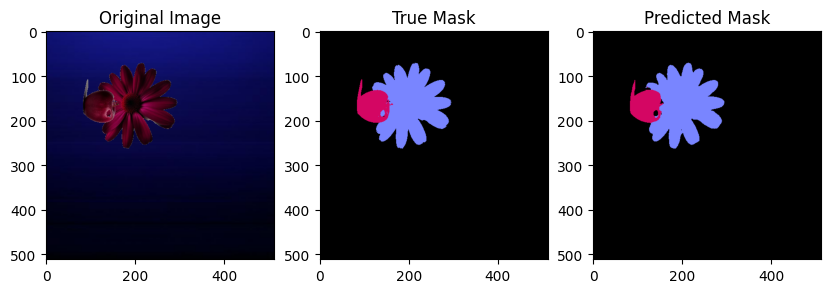

image199 IOU_apple: 0.927087840761575
image199 IOU_flower: 0.9649801587301587
image199 IOU_back: 0.9975773810523487


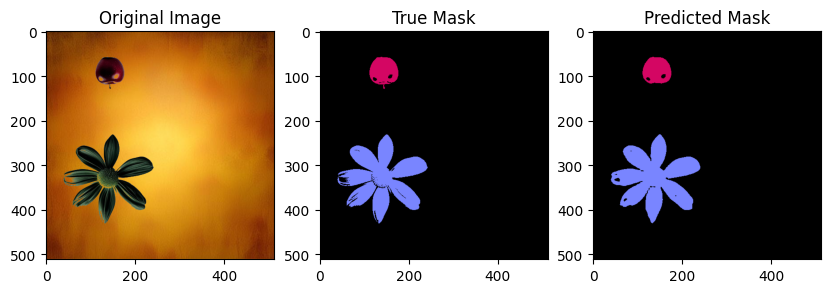

image200 IOU_apple: 0.9367206982543641
image200 IOU_flower: 0.9370065967340759
image200 IOU_back: 0.9943426657292916


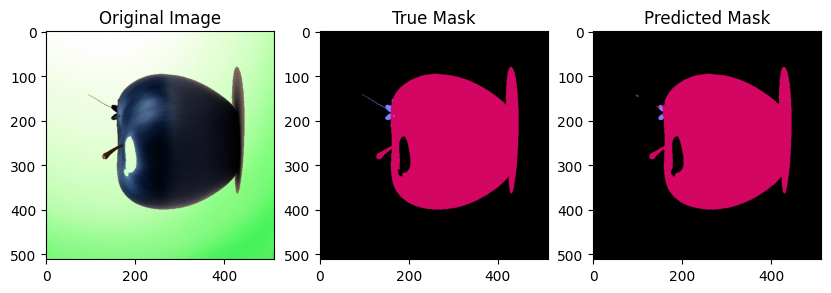

image201 IOU_apple: 0.9951596501932073
image201 IOU_flower: 0.5012853470437018
image201 IOU_back: 0.9983813445984673


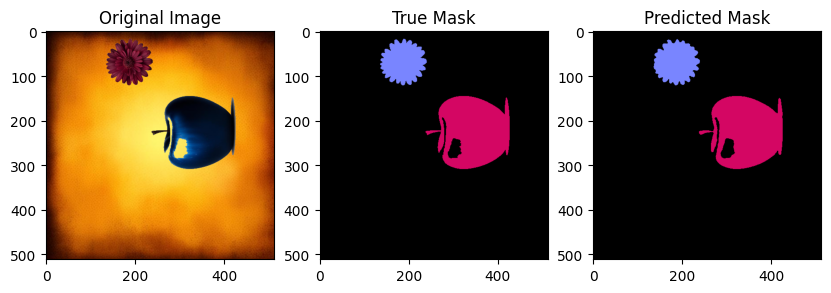

image202 IOU_apple: 0.9862582307472088
image202 IOU_flower: 0.9733041011091049
image202 IOU_back: 0.9978839552509972


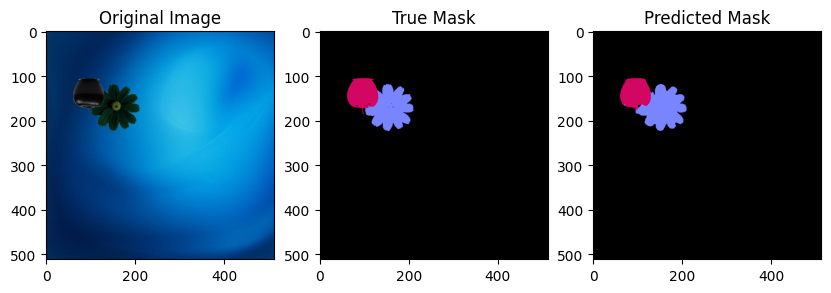

image203 IOU_apple: 0.9422545819733869
image203 IOU_flower: 0.9552795031055901
image203 IOU_back: 0.9986314721619955


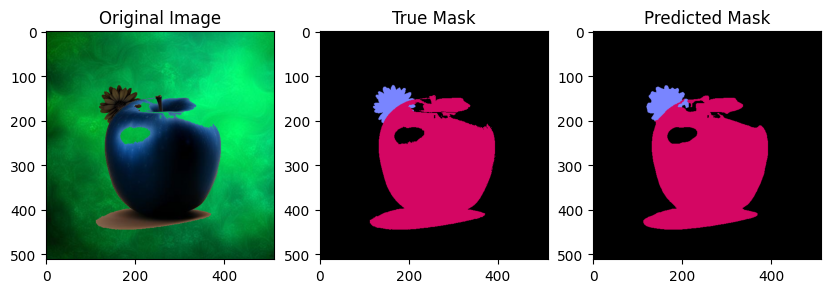

image204 IOU_apple: 0.9778766241367202
image204 IOU_flower: 0.8685029940119761
image204 IOU_back: 0.9938912645082468


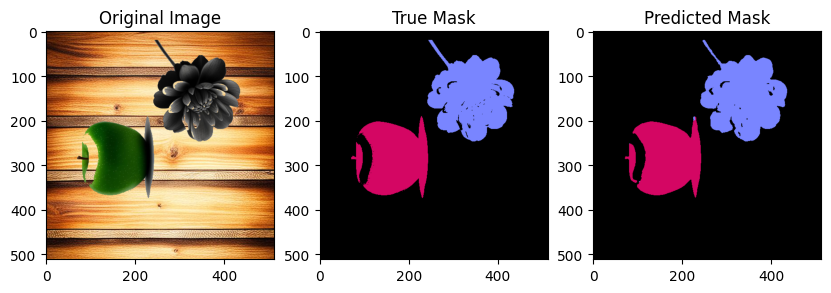

image205 IOU_apple: 0.9811803310331516
image205 IOU_flower: 0.9717307692307692
image205 IOU_back: 0.9951088387302379


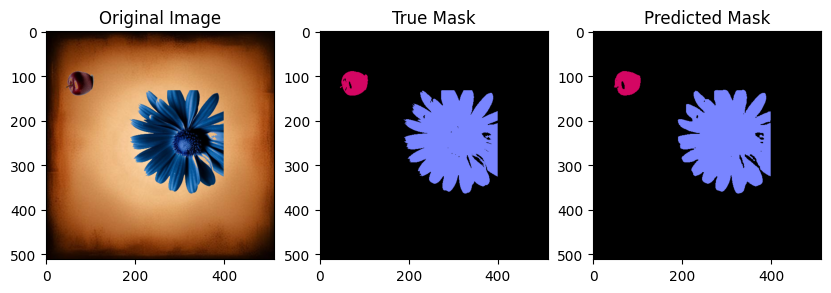

image206 IOU_apple: 0.9299883313885647
image206 IOU_flower: 0.979219178849493
image206 IOU_back: 0.9958983758102042


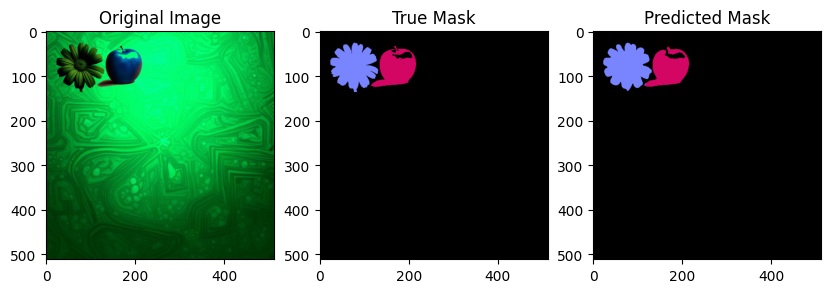

image207 IOU_apple: 0.951223902087833
image207 IOU_flower: 0.9596124811273277
image207 IOU_back: 0.9976968417842655


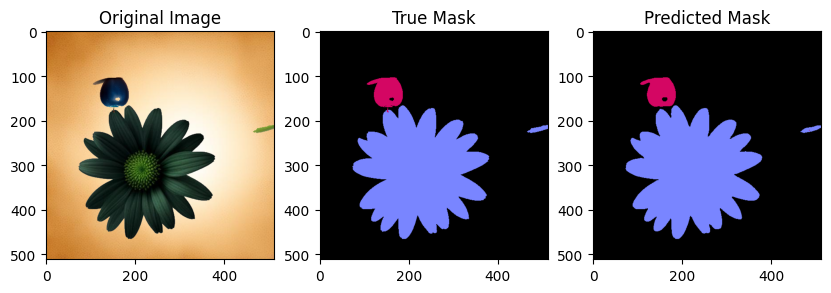

image208 IOU_apple: 0.9561266874350987
image208 IOU_flower: 0.9935591644135223
image208 IOU_back: 0.9975341728768979


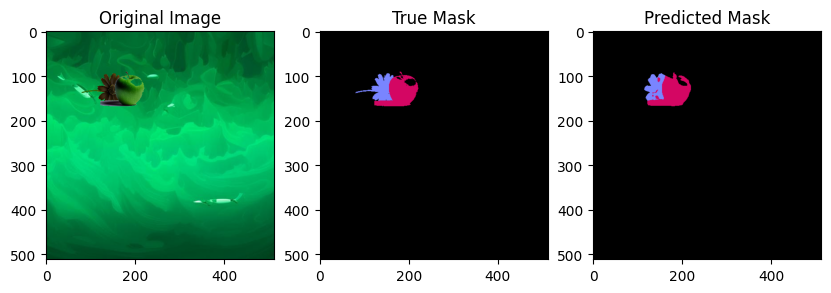

image209 IOU_apple: 0.8425069380203515
image209 IOU_flower: 0.781005071461503
image209 IOU_back: 0.9974197068911755


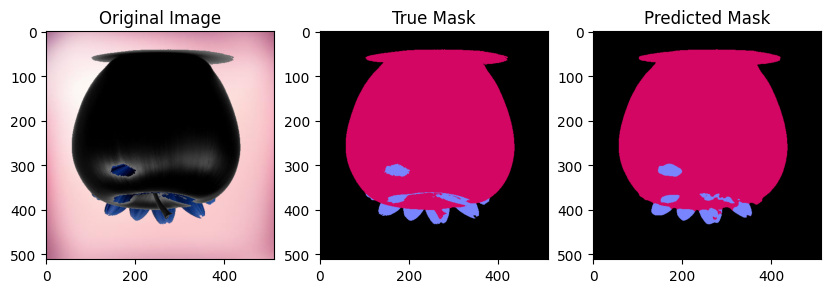

image210 IOU_apple: 0.9815222679226925
image210 IOU_flower: 0.7304234527687297
image210 IOU_back: 0.9979114888995635


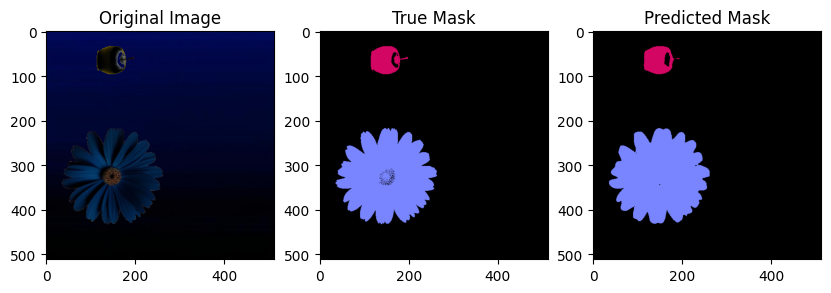

image211 IOU_apple: 0.9177718832891246
image211 IOU_flower: 0.9732694639108194
image211 IOU_back: 0.9947681489507552


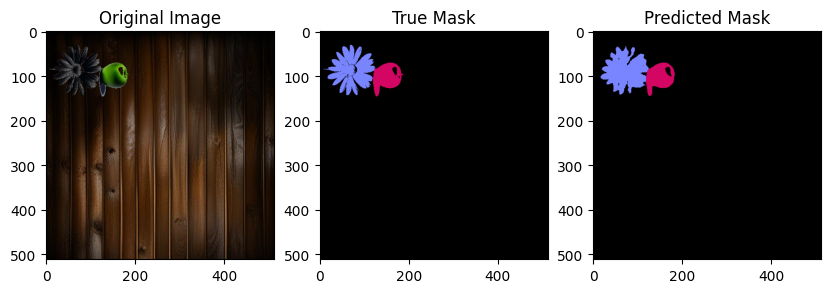

image212 IOU_apple: 0.9551713096381684
image212 IOU_flower: 0.8273832875637505
image212 IOU_back: 0.9942806741368604


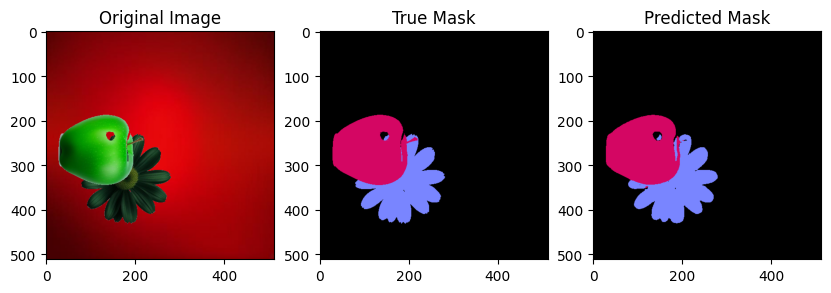

image213 IOU_apple: 0.960793598181732
image213 IOU_flower: 0.951452030638673
image213 IOU_back: 0.9975135149613189


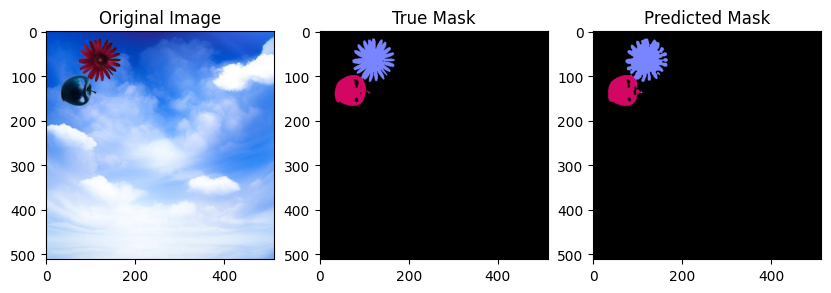

image214 IOU_apple: 0.9042414780119699
image214 IOU_flower: 0.9039746158984636
image214 IOU_back: 0.9964656915397738


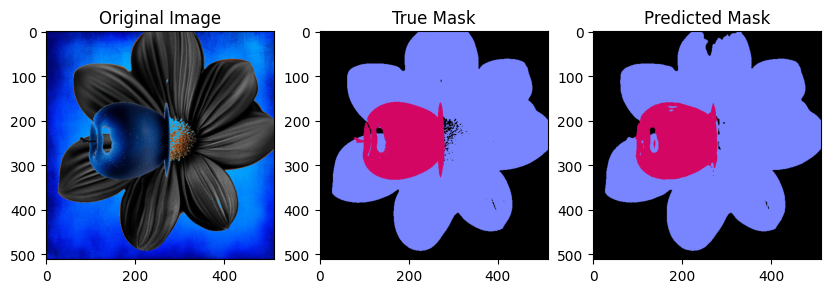

image215 IOU_apple: 0.9550026270359528
image215 IOU_flower: 0.9702974807525853
image215 IOU_back: 0.9723749733393918


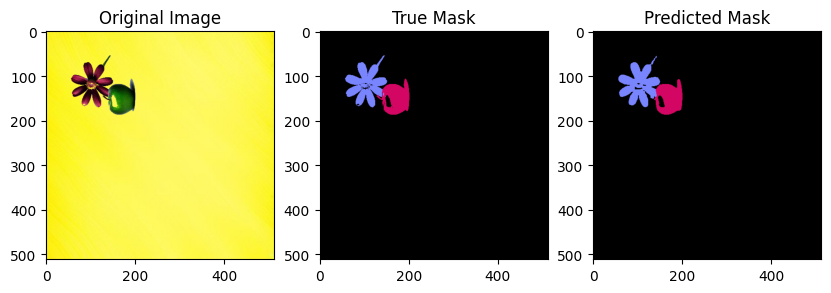

image216 IOU_apple: 0.9435954431786607
image216 IOU_flower: 0.9233333333333333
image216 IOU_back: 0.9982457938472697


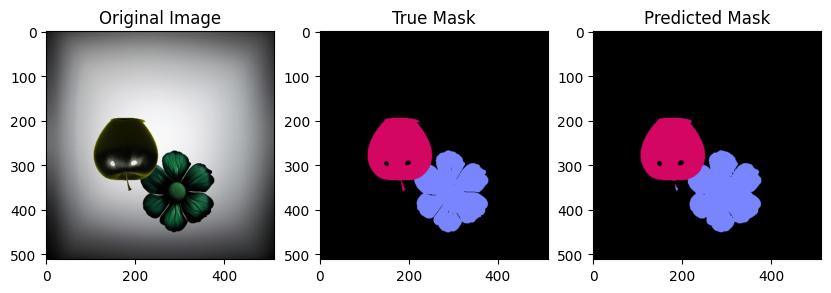

image217 IOU_apple: 0.9889656844913302
image217 IOU_flower: 0.983982683982684
image217 IOU_back: 0.9981936881160656


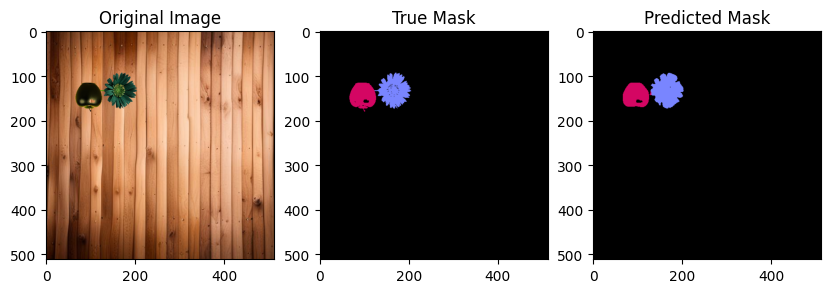

image218 IOU_apple: 0.9286733238231099
image218 IOU_flower: 0.9158946855192589
image218 IOU_back: 0.9978927203065134


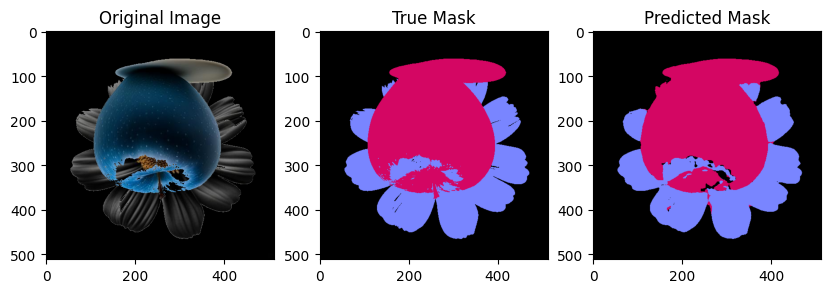

image219 IOU_apple: 0.9559439528023599
image219 IOU_flower: 0.9175075234554788
image219 IOU_back: 0.9846657221884909


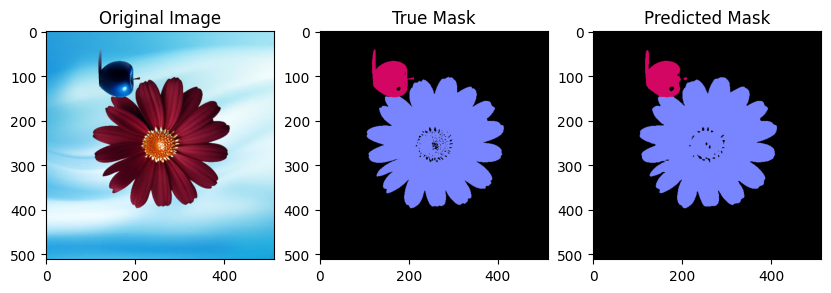

image220 IOU_apple: 0.9588824459673169
image220 IOU_flower: 0.9843262237476506
image220 IOU_back: 0.9940391957241028


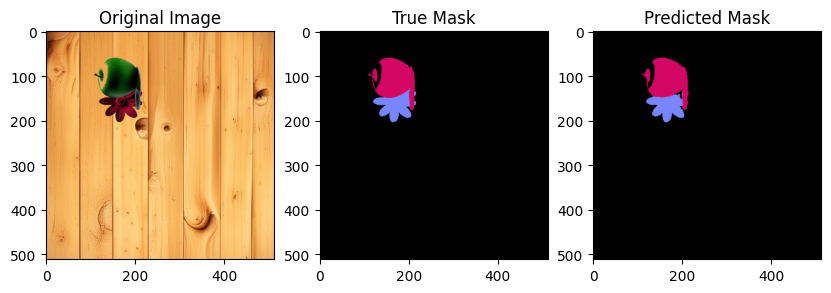

image221 IOU_apple: 0.9491599073001159
image221 IOU_flower: 0.9034346846846847
image221 IOU_back: 0.9981606789631621


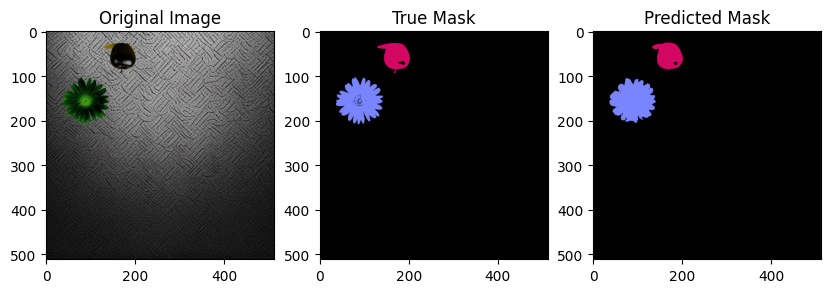

image222 IOU_apple: 0.9363099146421536
image222 IOU_flower: 0.9138233310856372
image222 IOU_back: 0.9967091063897194


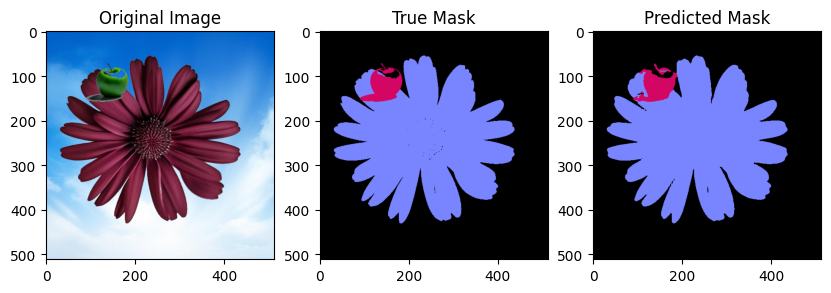

image223 IOU_apple: 0.8425568425568426
image223 IOU_flower: 0.9878680583462762
image223 IOU_back: 0.9932116259144533


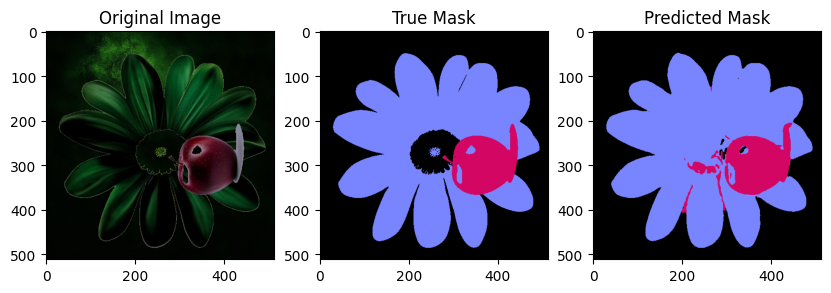

image224 IOU_apple: 0.8375027551245317
image224 IOU_flower: 0.9319534150434827
image224 IOU_back: 0.9341466643134486


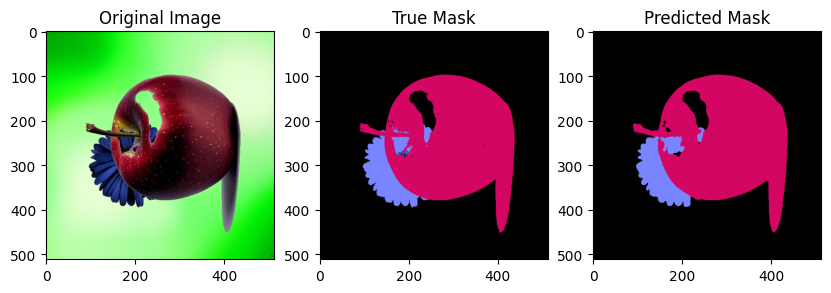

image225 IOU_apple: 0.9810777149202443
image225 IOU_flower: 0.8978115391571713
image225 IOU_back: 0.9962202675383888


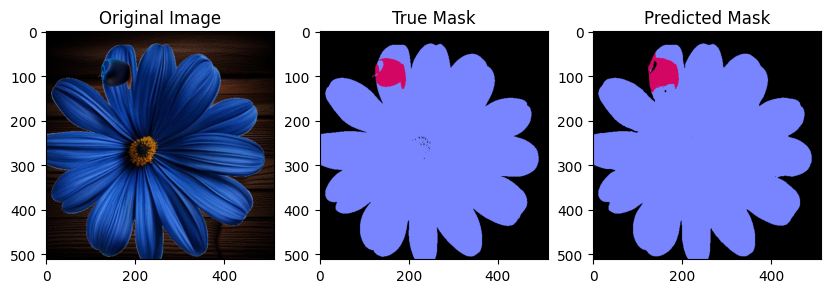

image226 IOU_apple: 0.8609422492401215
image226 IOU_flower: 0.9920190329374208
image226 IOU_back: 0.9904234562041871


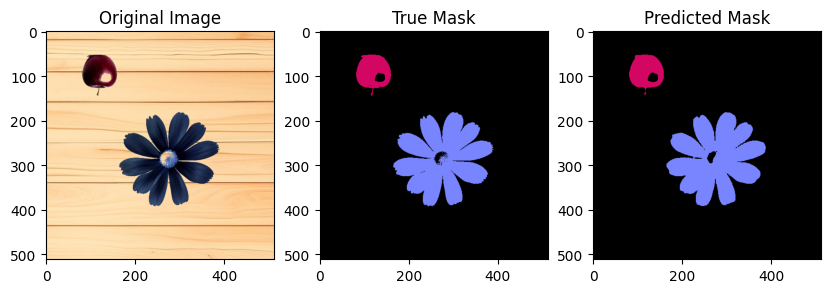

image227 IOU_apple: 0.9709480122324159
image227 IOU_flower: 0.9758890898131405
image227 IOU_back: 0.9964679202001946


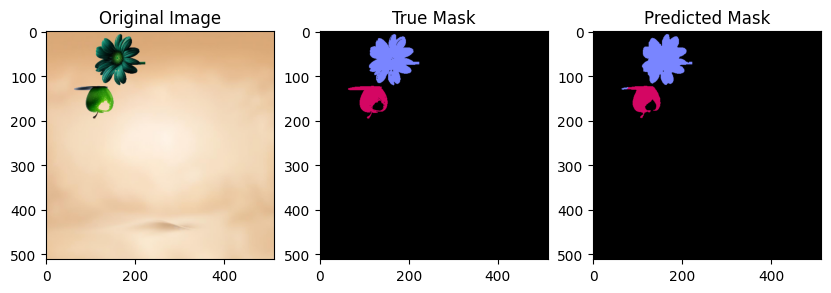

image228 IOU_apple: 0.9016763378465507
image228 IOU_flower: 0.9623484365028717
image228 IOU_back: 0.9980377670265418


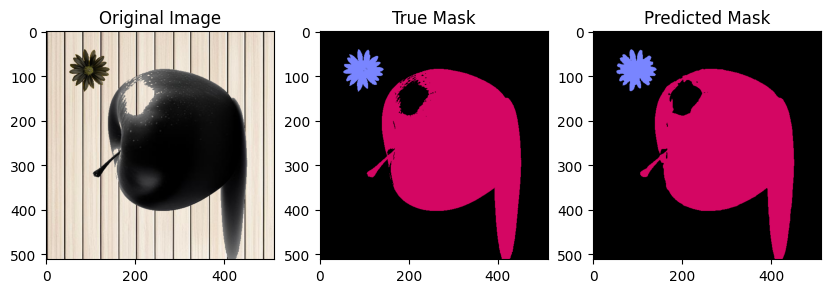

image229 IOU_apple: 0.9880803159662276
image229 IOU_flower: 0.9432314410480349
image229 IOU_back: 0.9925561167550652


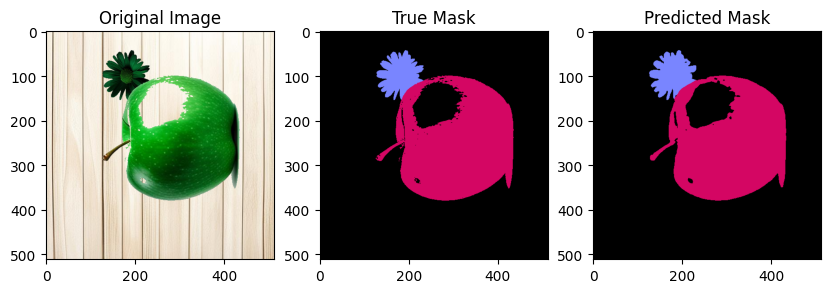

image230 IOU_apple: 0.97810838747785
image230 IOU_flower: 0.959476396045119
image230 IOU_back: 0.9930228303276946


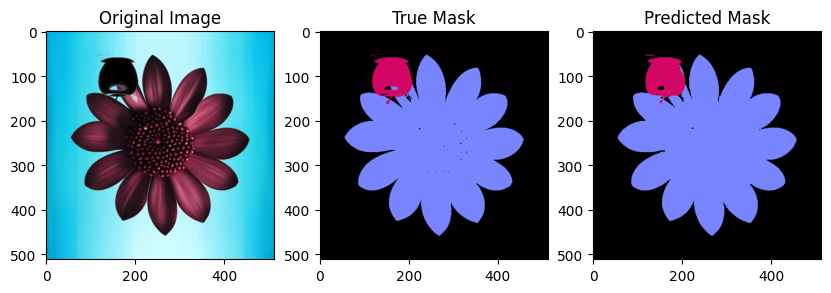

image231 IOU_apple: 0.9300465386852821
image231 IOU_flower: 0.9910721016638846
image231 IOU_back: 0.9959974295419076


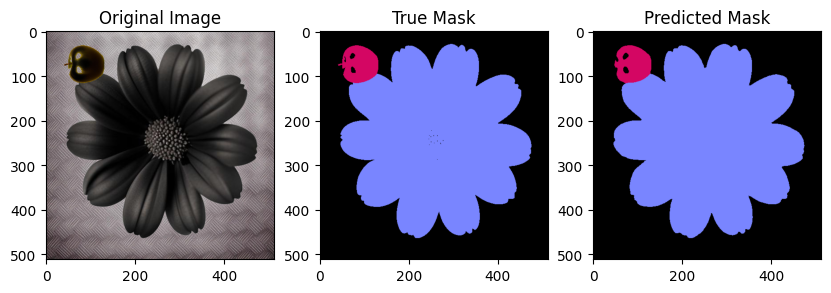

image232 IOU_apple: 0.9546877878062259
image232 IOU_flower: 0.9955610531342722
image232 IOU_back: 0.9940281716187893


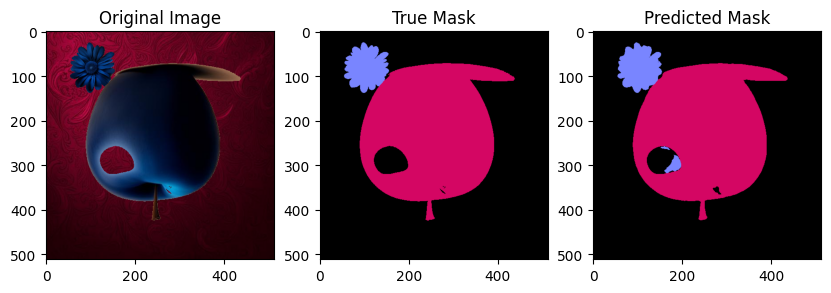

image233 IOU_apple: 0.9914286467811272
image233 IOU_flower: 0.8682926829268293
image233 IOU_back: 0.9900220307314761


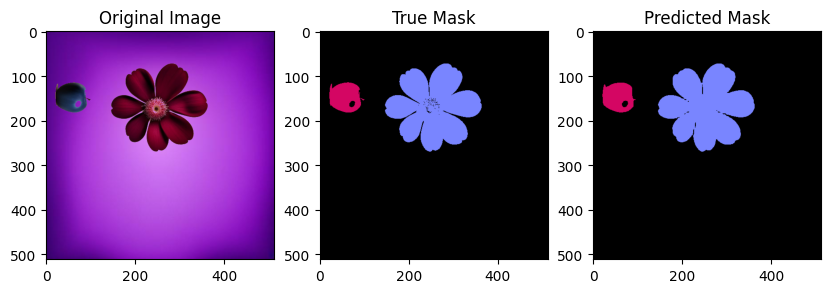

image234 IOU_apple: 0.9643502970808576
image234 IOU_flower: 0.9814814814814815
image234 IOU_back: 0.9972785483294506


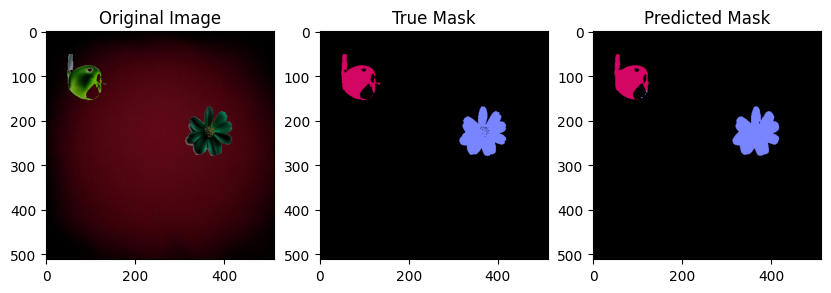

image235 IOU_apple: 0.9224080267558529
image235 IOU_flower: 0.970442061208475
image235 IOU_back: 0.997805048388706


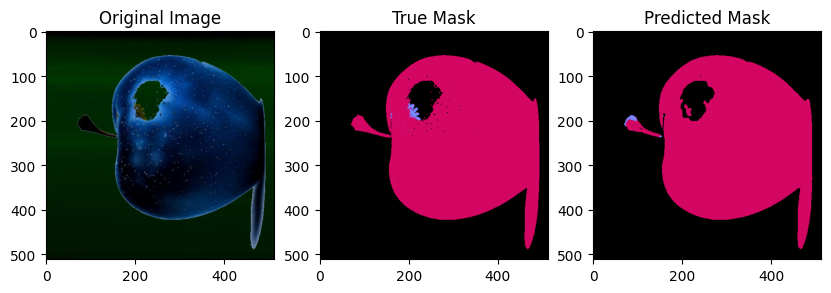

image236 IOU_apple: 0.9847265732867386
image236 IOU_flower: 1
image236 IOU_back: 0.9908550265754066


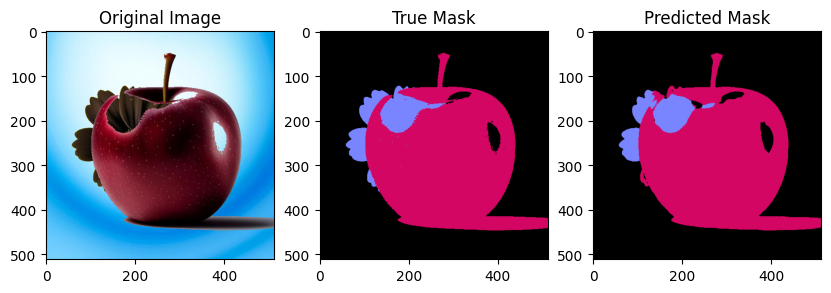

image237 IOU_apple: 0.9781139215976837
image237 IOU_flower: 0.8496694214876033
image237 IOU_back: 0.9945152394951348


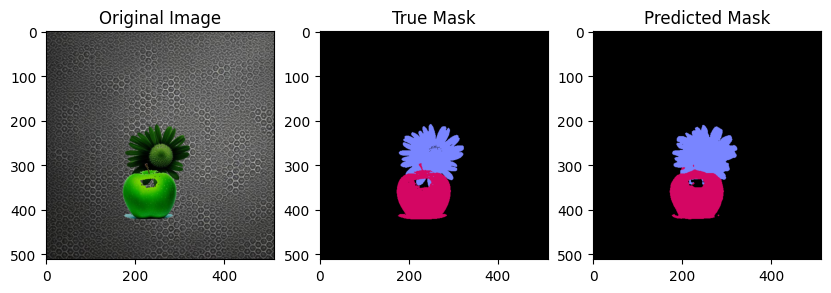

image238 IOU_apple: 0.9496527777777778
image238 IOU_flower: 0.9206916618172749
image238 IOU_back: 0.9954879276072293


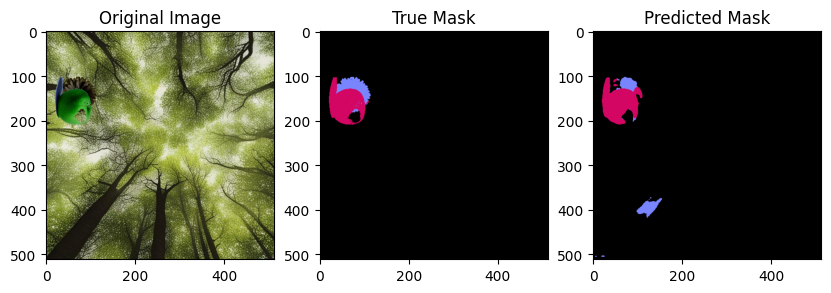

image239 IOU_apple: 0.880055067974531
image239 IOU_flower: 0.2740311260299054
image239 IOU_back: 0.991878950992051


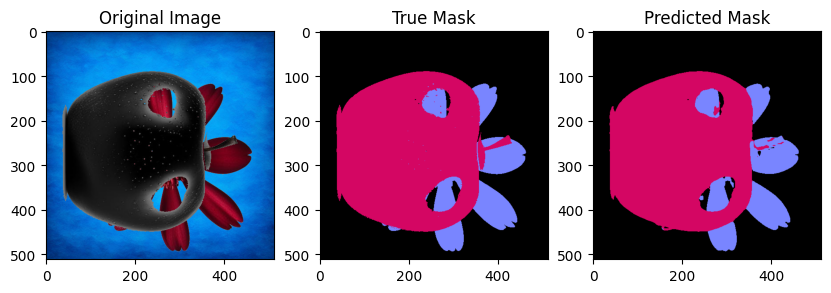

image240 IOU_apple: 0.9716865739903636
image240 IOU_flower: 0.893378829122417
image240 IOU_back: 0.9917516837159387


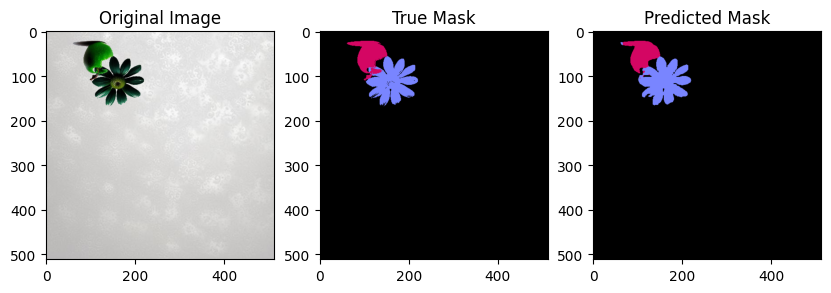

image241 IOU_apple: 0.8629677419354839
image241 IOU_flower: 0.8965952080706179
image241 IOU_back: 0.9976801190580408


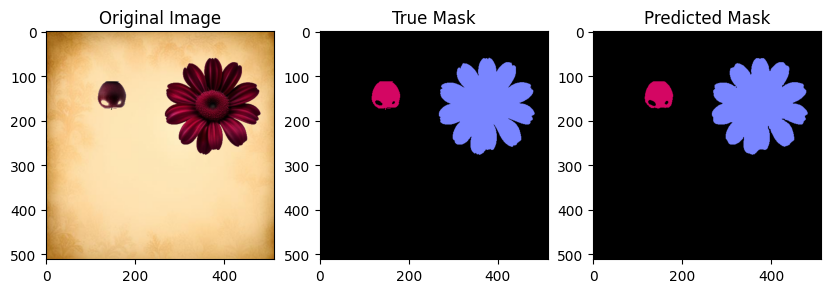

image242 IOU_apple: 0.9605769230769231
image242 IOU_flower: 0.9918157409504093
image242 IOU_back: 0.9983543921536018


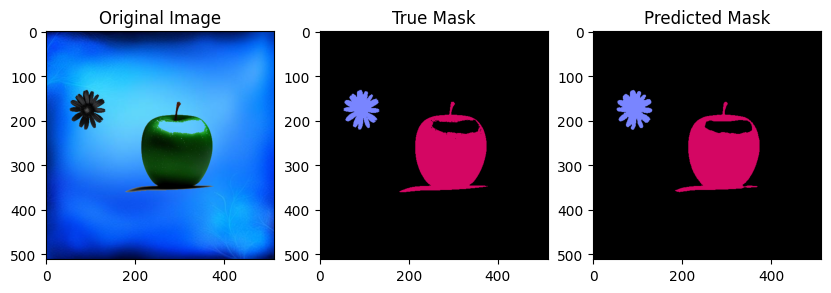

image243 IOU_apple: 0.9780389586064806
image243 IOU_flower: 0.9538252602987777
image243 IOU_back: 0.9971608526722999


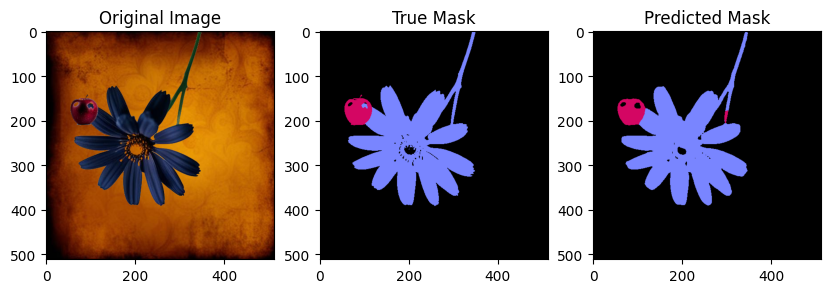

image244 IOU_apple: 0.8883167042162858
image244 IOU_flower: 0.9687168235543917
image244 IOU_back: 0.9939901532029596


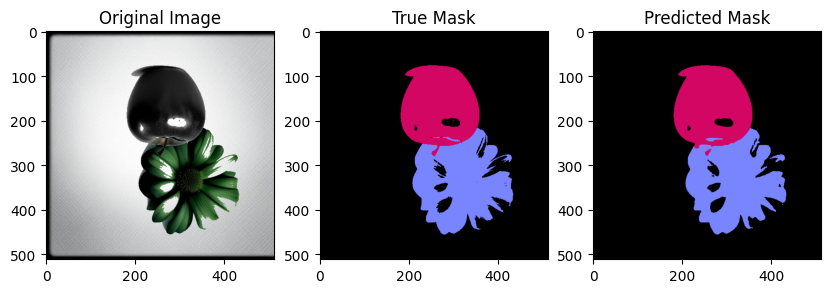

image245 IOU_apple: 0.9745195839616441
image245 IOU_flower: 0.9545302675940832
image245 IOU_back: 0.9946532412285837


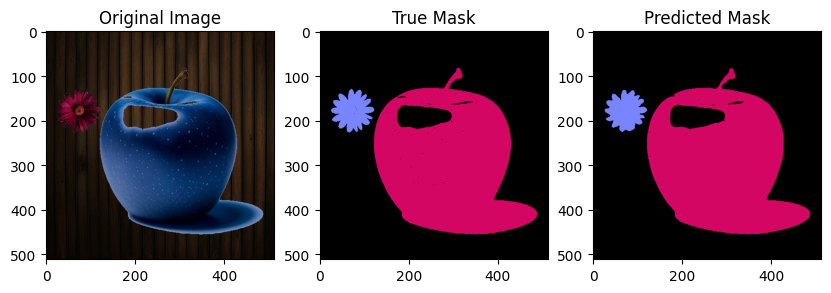

image246 IOU_apple: 0.992021726010863
image246 IOU_flower: 0.9287360105332455
image246 IOU_back: 0.9937238973794116


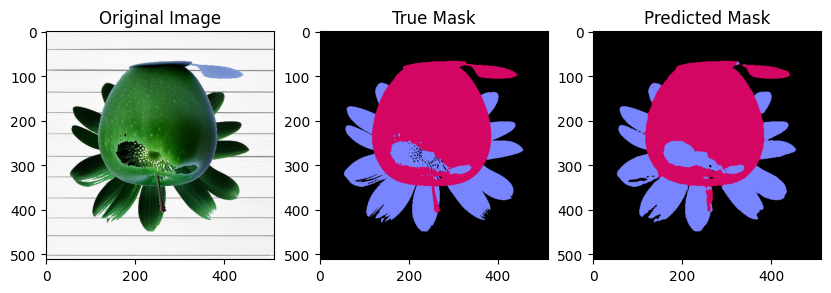

image247 IOU_apple: 0.9718071227677815
image247 IOU_flower: 0.9319724639066832
image247 IOU_back: 0.9898524714828897


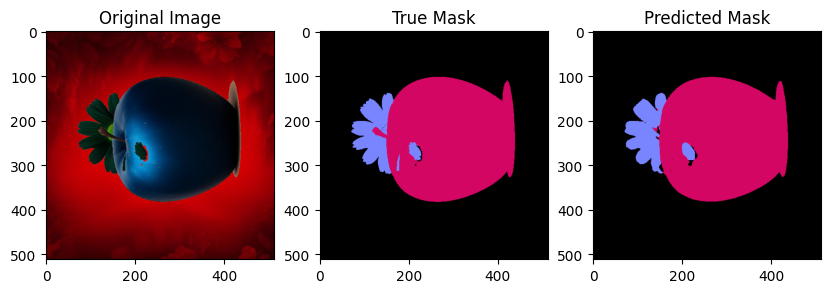

image248 IOU_apple: 0.9814619509514119
image248 IOU_flower: 0.8793955787706371
image248 IOU_back: 0.9945931405514459


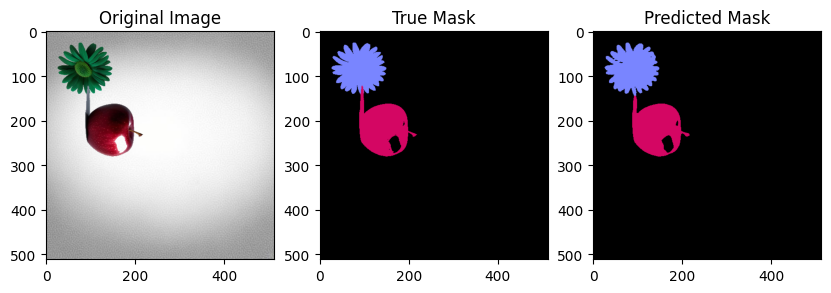

image249 IOU_apple: 0.9723368342085521
image249 IOU_flower: 0.9591134500556624
image249 IOU_back: 0.9979562007630184


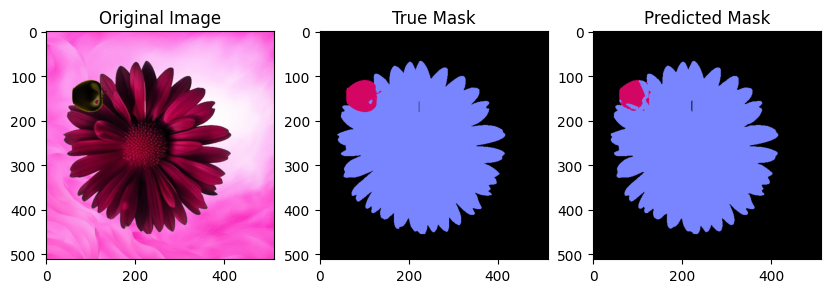

image250 IOU_apple: 0.6867469879518072
image250 IOU_flower: 0.982265631319259
image250 IOU_back: 0.9967691227546956


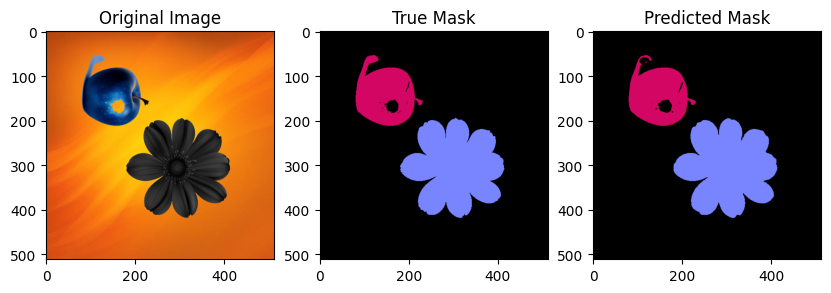

image251 IOU_apple: 0.9646266913936397
image251 IOU_flower: 0.9935369480668039
image251 IOU_back: 0.9965363217518056


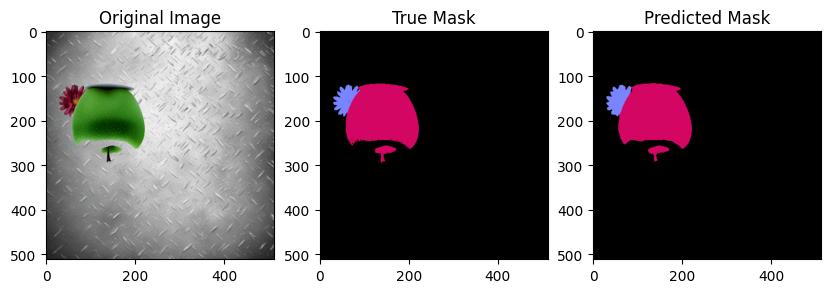

image252 IOU_apple: 0.9792631470618504
image252 IOU_flower: 0.9249146757679181
image252 IOU_back: 0.997845713218355


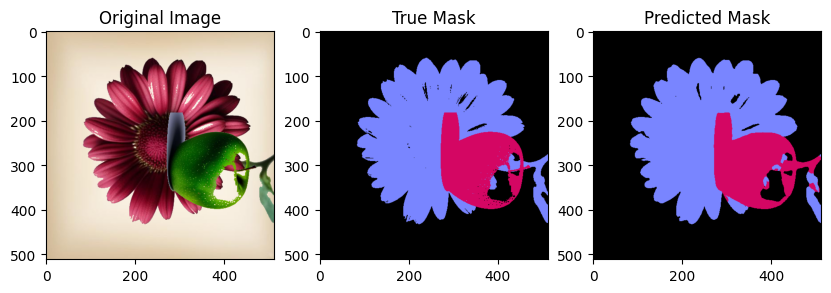

image253 IOU_apple: 0.9044243189072824
image253 IOU_flower: 0.9552304562476513
image253 IOU_back: 0.9905813134247184


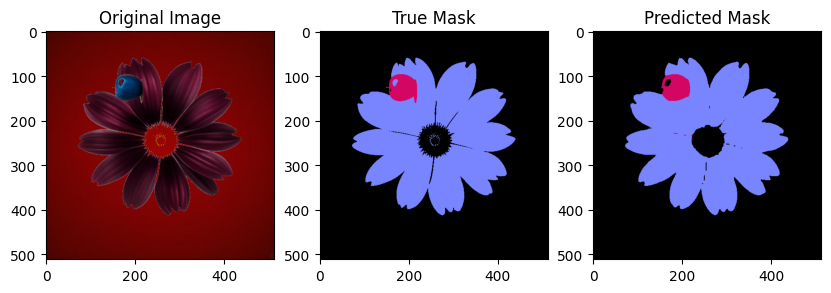

image254 IOU_apple: 0.9098461538461539
image254 IOU_flower: 0.9744048240576381
image254 IOU_back: 0.9897477624084622


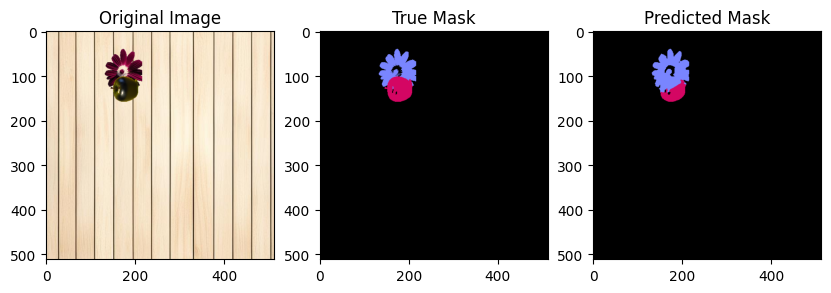

image255 IOU_apple: 0.5550131430717237
image255 IOU_flower: 0.7388597003308036
image255 IOU_back: 0.9987996512341697


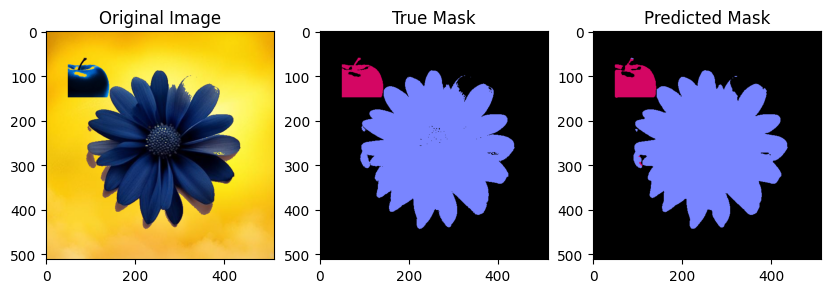

image256 IOU_apple: 0.9488462159109247
image256 IOU_flower: 0.9902064185626036
image256 IOU_back: 0.9944345766725873


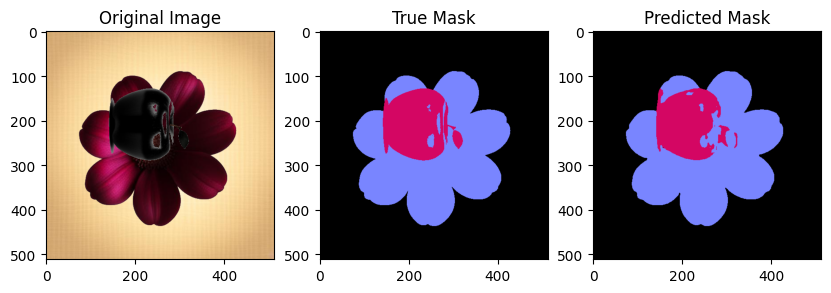

image257 IOU_apple: 0.8234473468995045
image257 IOU_flower: 0.9415800763718793
image257 IOU_back: 0.9990193292434906


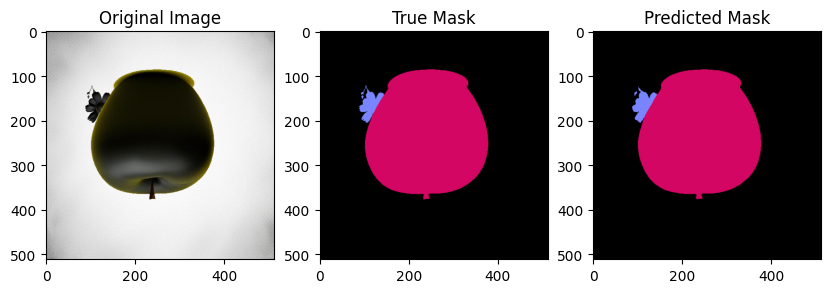

image258 IOU_apple: 0.9975589131579368
image258 IOU_flower: 0.9151205936920223
image258 IOU_back: 0.9985123414935282


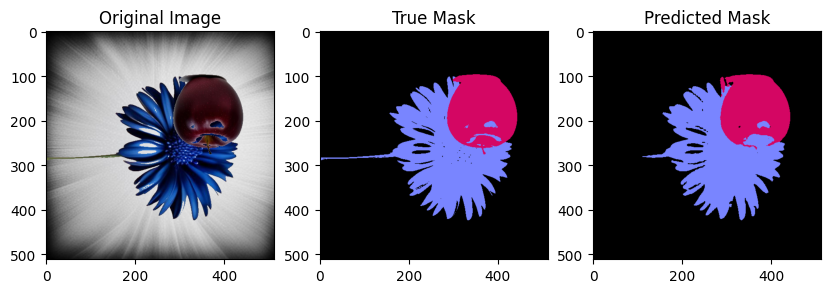

image259 IOU_apple: 0.9035221323179439
image259 IOU_flower: 0.9211188363370232
image259 IOU_back: 0.9924145139614753


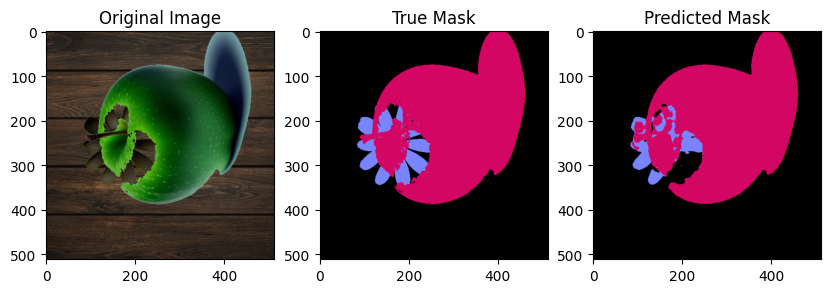

image260 IOU_apple: 0.9609537376520866
image260 IOU_flower: 0.46992380098610487
image260 IOU_back: 0.9727317568547802


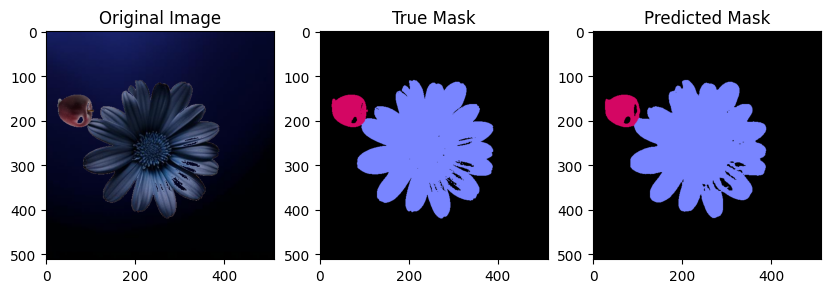

image261 IOU_apple: 0.9428068631764188
image261 IOU_flower: 0.9770732724734874
image261 IOU_back: 0.9915459059843815


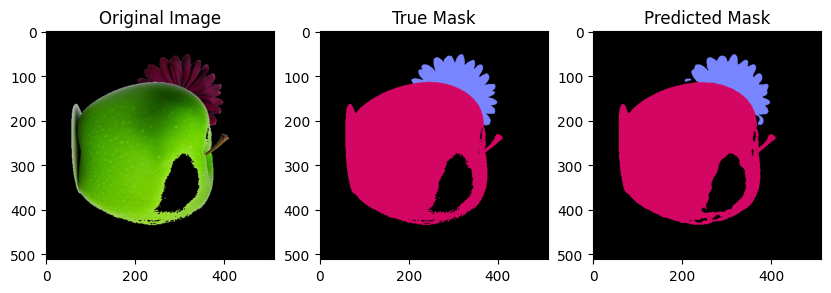

image262 IOU_apple: 0.9805660304508423
image262 IOU_flower: 0.9486779367143476
image262 IOU_back: 0.9887507502357884


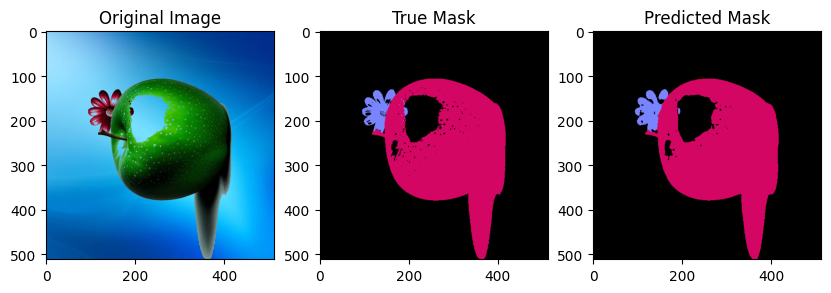

image263 IOU_apple: 0.9808398992249306
image263 IOU_flower: 0.8526960784313725
image263 IOU_back: 0.9922748433439543


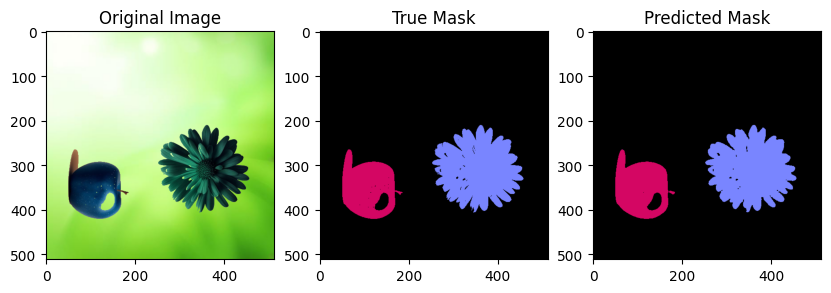

image264 IOU_apple: 0.9910734898037706
image264 IOU_flower: 0.9796393030083502
image264 IOU_back: 0.9971015918880356


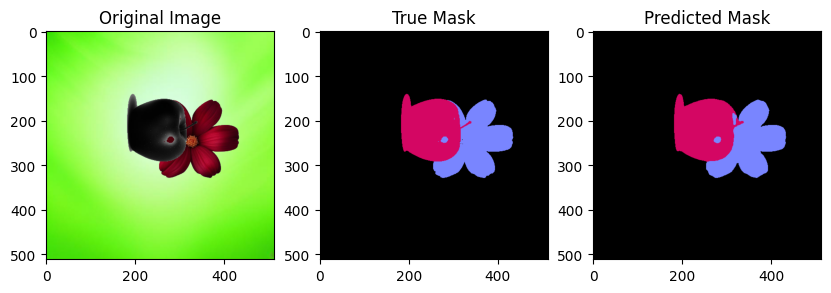

image265 IOU_apple: 0.970413144421955
image265 IOU_flower: 0.9645494830132939
image265 IOU_back: 0.9993078349599938


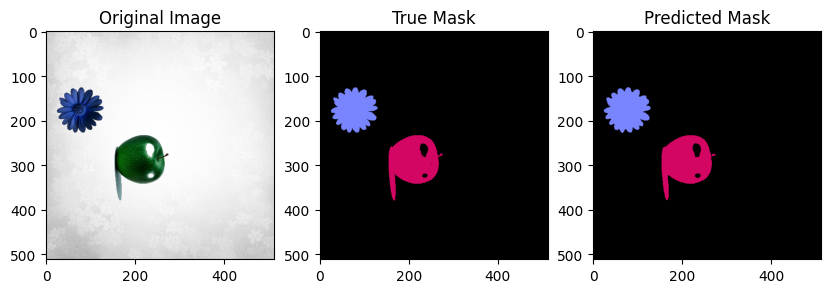

image266 IOU_apple: 0.985081951123761
image266 IOU_flower: 0.9816625916870416
image266 IOU_back: 0.998827997386475


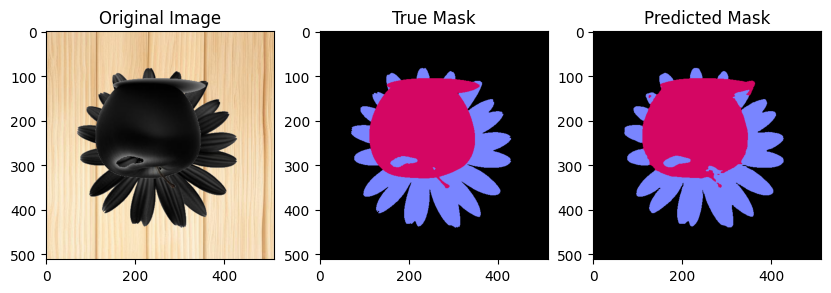

image267 IOU_apple: 0.9699829423362354
image267 IOU_flower: 0.9548007088127387
image267 IOU_back: 0.9968791597221446


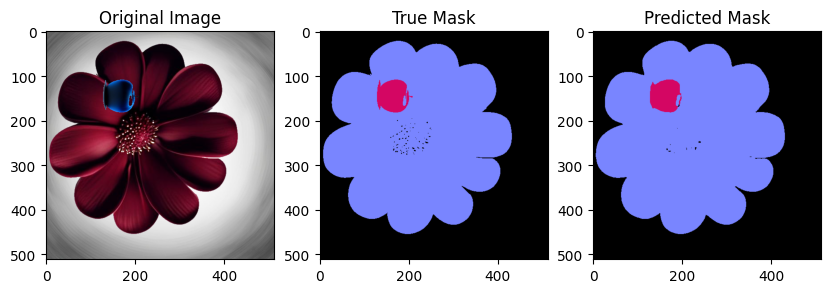

image268 IOU_apple: 0.9343015214384509
image268 IOU_flower: 0.9938178267101387
image268 IOU_back: 0.9960341579043336


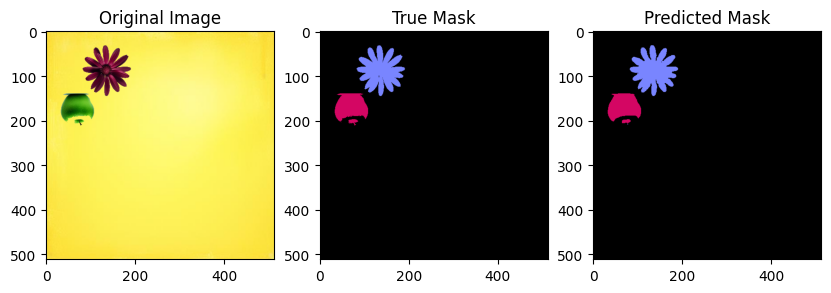

image269 IOU_apple: 0.9575904916261481
image269 IOU_flower: 0.9651440618411806
image269 IOU_back: 0.9984070233980853


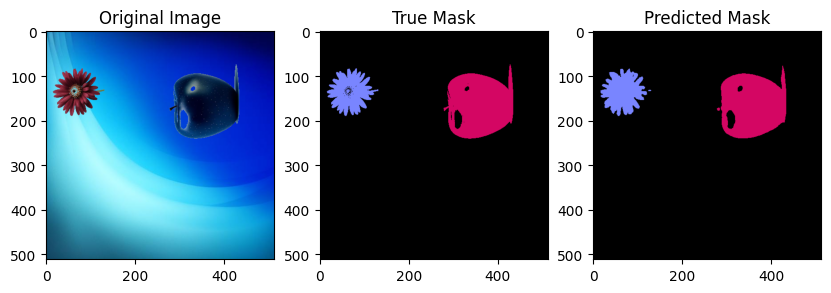

image270 IOU_apple: 0.9771707426520081
image270 IOU_flower: 0.9307401707009935
image270 IOU_back: 0.9962112143016159


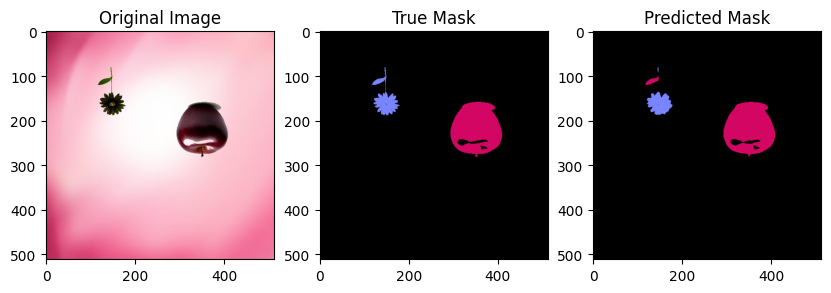

image271 IOU_apple: 0.9594276569707239
image271 IOU_flower: 0.7802746566791511
image271 IOU_back: 0.998274709482693


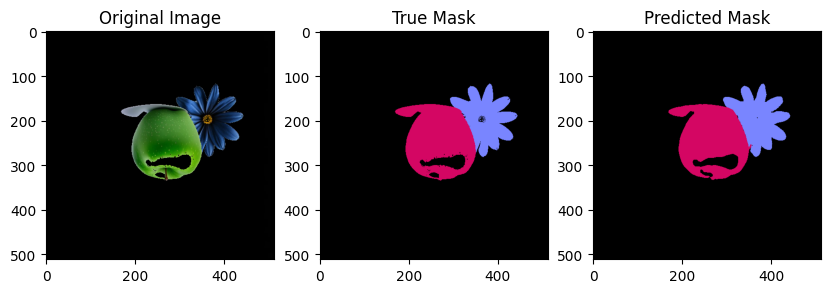

image272 IOU_apple: 0.9687143636273489
image272 IOU_flower: 0.9601694224973528
image272 IOU_back: 0.9957788901167955


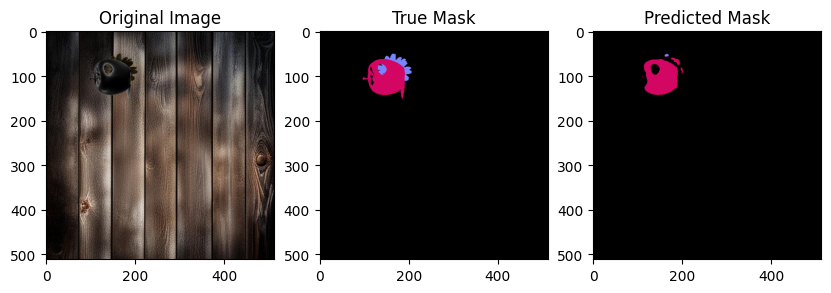

image273 IOU_apple: 0.8388311222660452
image273 IOU_flower: 0.03147128245476003
image273 IOU_back: 0.9933518651711604


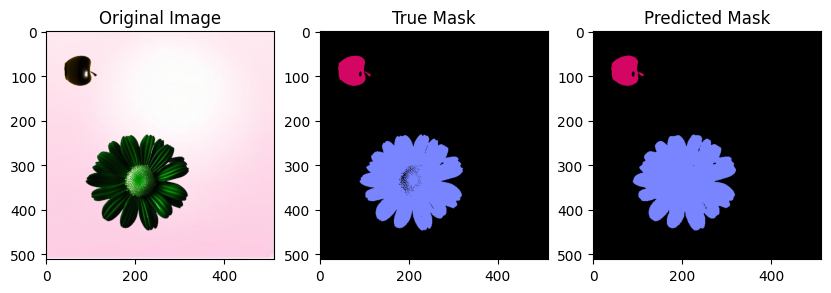

image274 IOU_apple: 0.9794023788801857
image274 IOU_flower: 0.9756773489784487
image274 IOU_back: 0.996029671118516


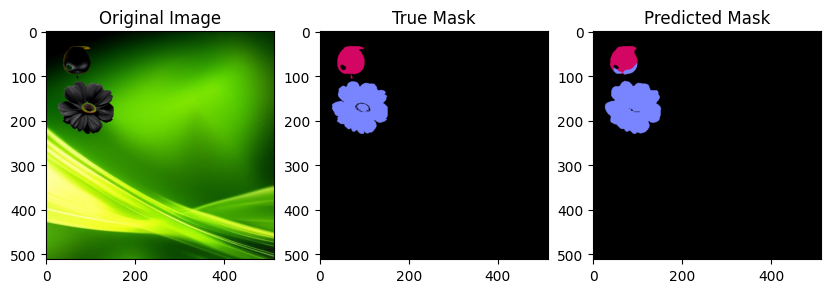

image275 IOU_apple: 0.8368883312421581
image275 IOU_flower: 0.9328942684229263
image275 IOU_back: 0.9980932765875282


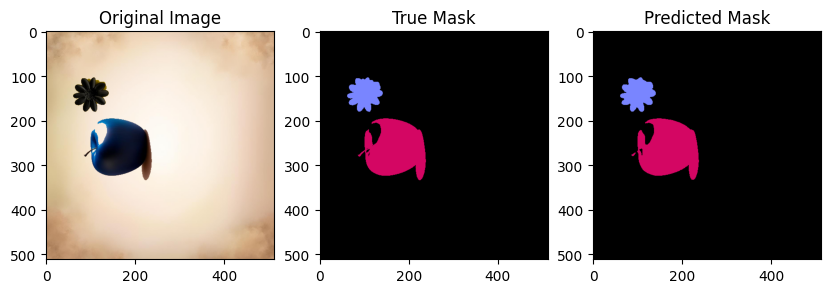

image276 IOU_apple: 0.9874302662241368
image276 IOU_flower: 0.9743896601244615
image276 IOU_back: 0.9988405868351298


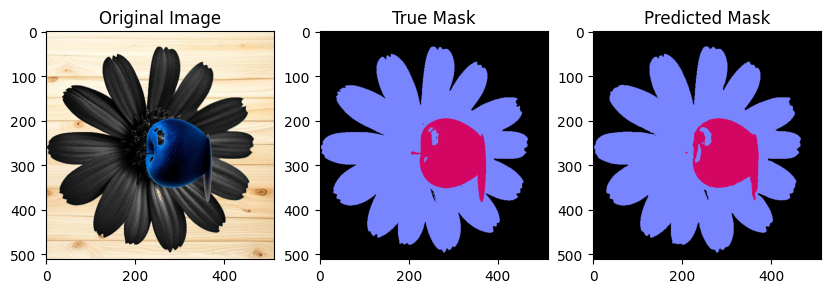

image277 IOU_apple: 0.9510601070399342
image277 IOU_flower: 0.985943191340185
image277 IOU_back: 0.9945292141534018


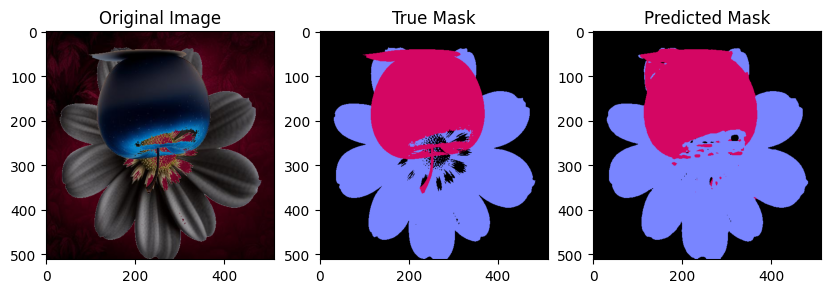

image278 IOU_apple: 0.8834692952639928
image278 IOU_flower: 0.9032287412559137
image278 IOU_back: 0.963631528207174


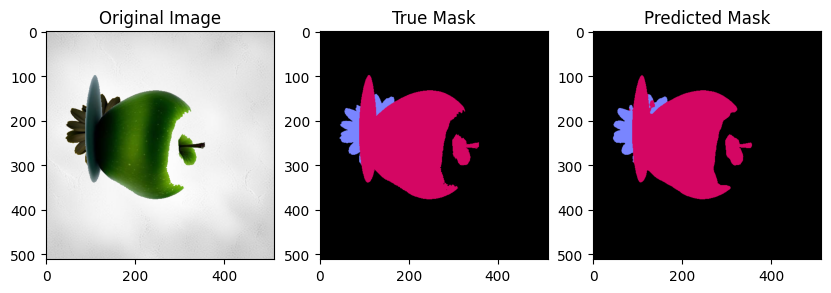

image279 IOU_apple: 0.9863171182543619
image279 IOU_flower: 0.8993923024983119
image279 IOU_back: 0.9979167542470655


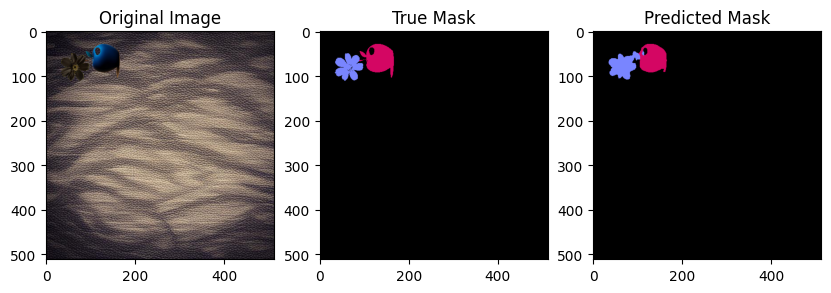

image280 IOU_apple: 0.8934520390580126
image280 IOU_flower: 0.7601626016260162
image280 IOU_back: 0.9969957332398153


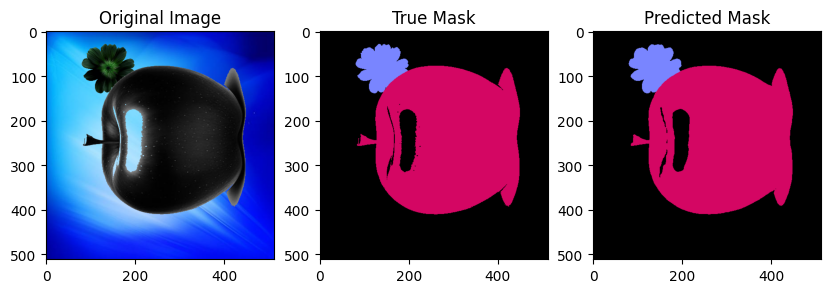

image281 IOU_apple: 0.9918804952449309
image281 IOU_flower: 0.9830871843735112
image281 IOU_back: 0.9949827115119568


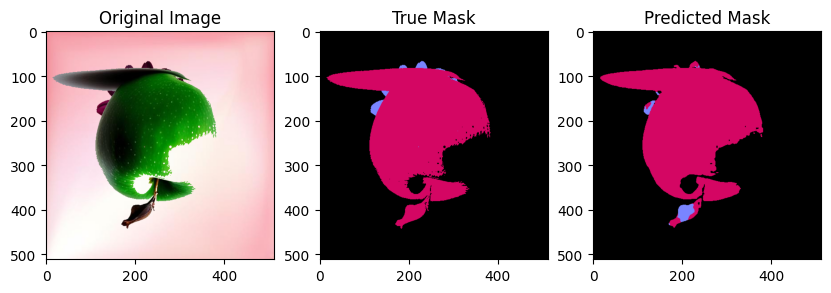

image282 IOU_apple: 0.9532710280373832
image282 IOU_flower: 0.16764044943820225
image282 IOU_back: 0.9927870485678705


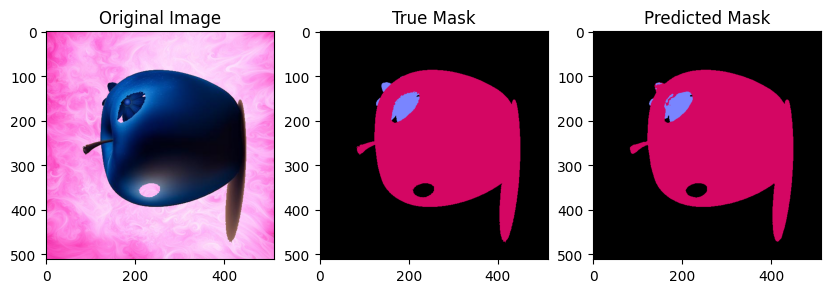

image283 IOU_apple: 0.9912340565726926
image283 IOU_flower: 0.8298555377207063
image283 IOU_back: 0.9983240383240384


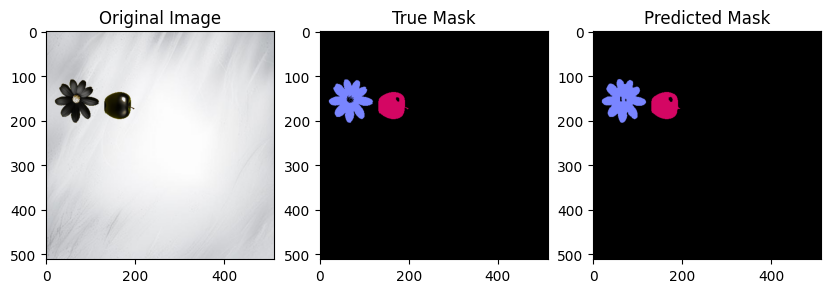

image284 IOU_apple: 0.9814385150812065
image284 IOU_flower: 0.9543346414555833
image284 IOU_back: 0.9987708453983525


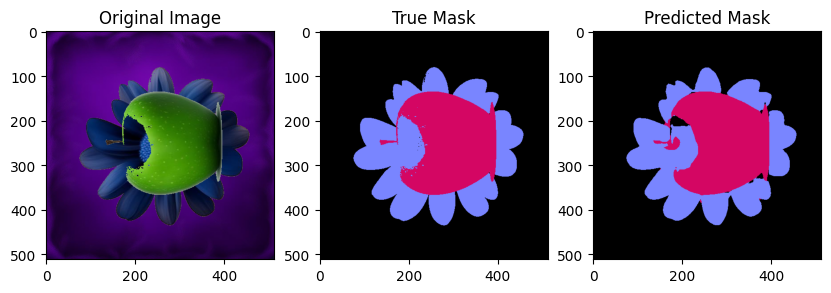

image285 IOU_apple: 0.9595635919737545
image285 IOU_flower: 0.9379205645823075
image285 IOU_back: 0.9897459615558163


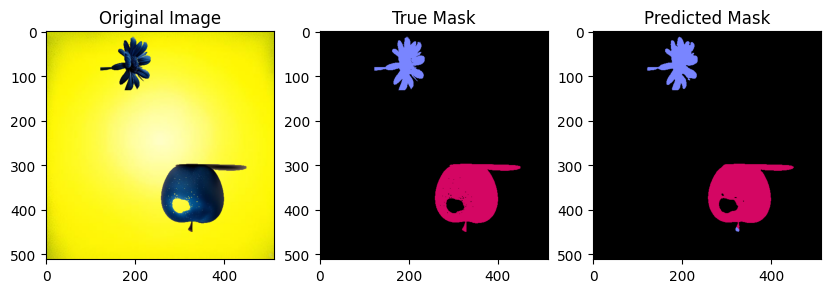

image286 IOU_apple: 0.9815740162398501
image286 IOU_flower: 0.946524064171123
image286 IOU_back: 0.99793524050086


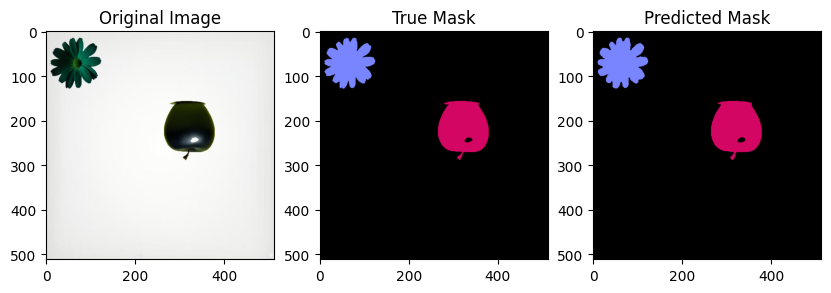

image287 IOU_apple: 0.9913886874546773
image287 IOU_flower: 0.9806107047486358
image287 IOU_back: 0.9989207492142478


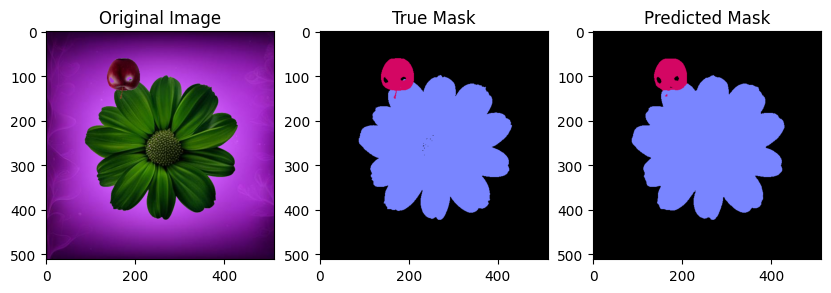

image288 IOU_apple: 0.9512030582415111
image288 IOU_flower: 0.9938816776465984
image288 IOU_back: 0.9974561712624438


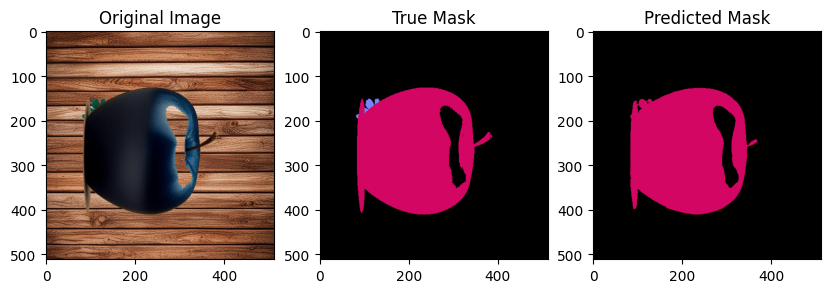

image289 IOU_apple: 0.9755922109207709
image289 IOU_flower: 0.002012072434607646
image289 IOU_back: 0.9943810834726182


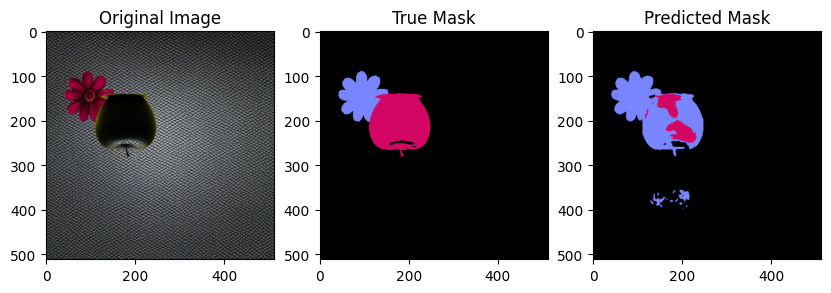

image290 IOU_apple: 0.267670201847417
image290 IOU_flower: 0.39147837994417234
image290 IOU_back: 0.9929112808338496


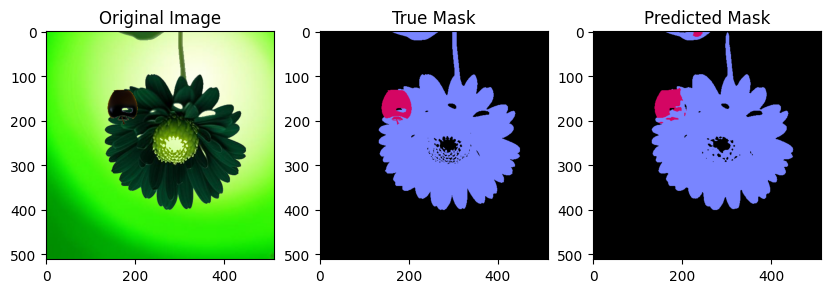

image291 IOU_apple: 0.6968072142334877
image291 IOU_flower: 0.9607825844100484
image291 IOU_back: 0.9922578770393126


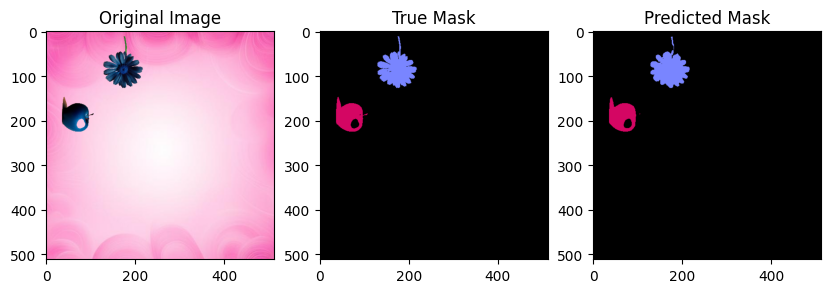

image292 IOU_apple: 0.9712298450837812
image292 IOU_flower: 0.949166004765687
image292 IOU_back: 0.9986354269894452


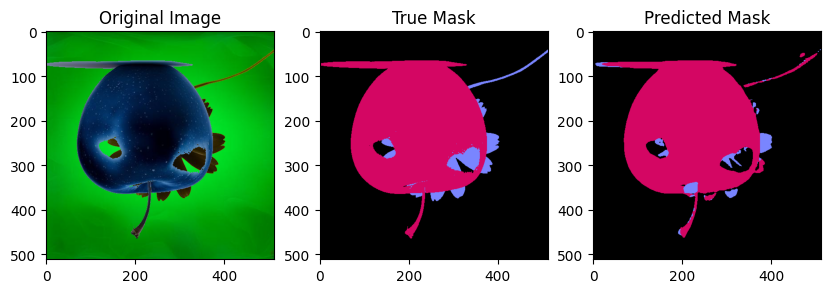

image293 IOU_apple: 0.9511211294340965
image293 IOU_flower: 0.32660290471130005
image293 IOU_back: 0.9792928444008263


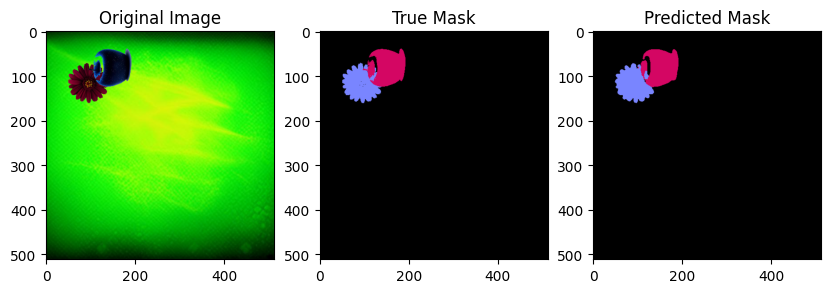

image294 IOU_apple: 0.9336244541484716
image294 IOU_flower: 0.9175257731958762
image294 IOU_back: 0.9984119421946959


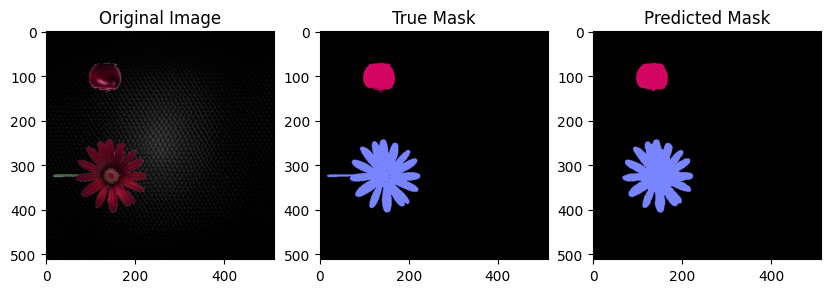

image295 IOU_apple: 0.9661472326706072
image295 IOU_flower: 0.9437945232337756
image295 IOU_back: 0.9959607876873666


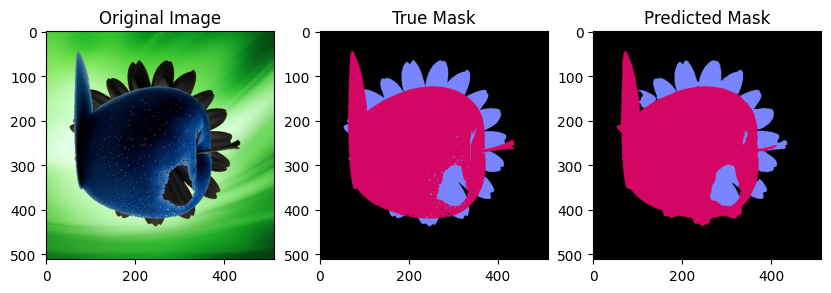

image296 IOU_apple: 0.9649772319758517
image296 IOU_flower: 0.8653330495850181
image296 IOU_back: 0.9943415606595637


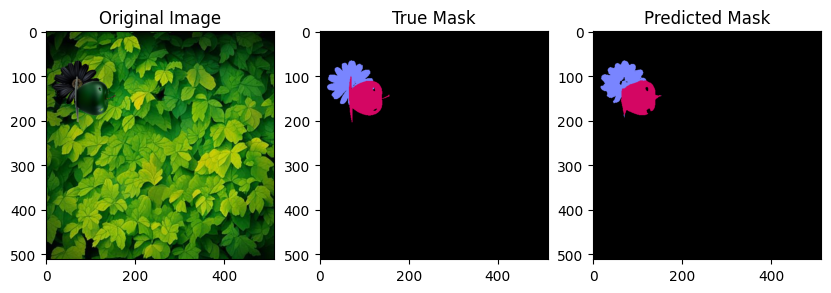

image297 IOU_apple: 0.904243119266055
image297 IOU_flower: 0.8837164004674718
image297 IOU_back: 0.9972059521924964


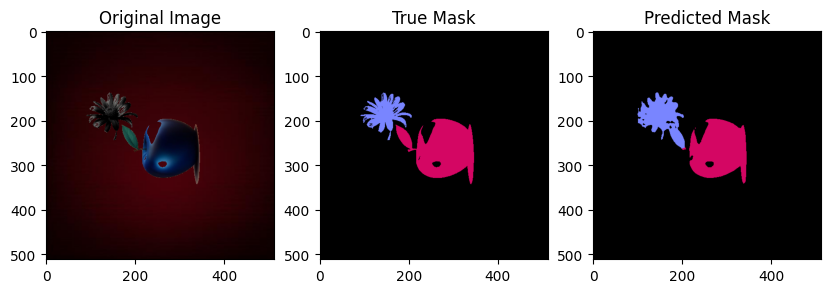

image298 IOU_apple: 0.9025409449349598
image298 IOU_flower: 0.6581184267396629
image298 IOU_back: 0.9925692596811402


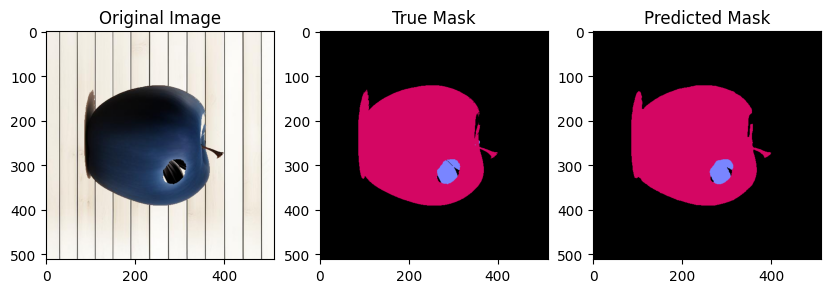

image299 IOU_apple: 0.9918370001788706
image299 IOU_flower: 0.9381682938168294
image299 IOU_back: 0.9978244485755916


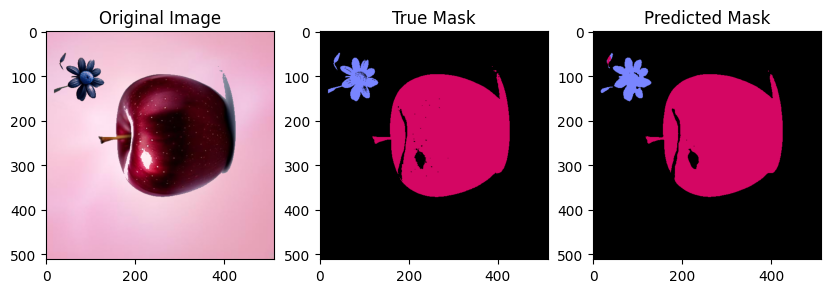

image300 IOU_apple: 0.9903144509051376
image300 IOU_flower: 0.9005082095387021
image300 IOU_back: 0.9953730919705662


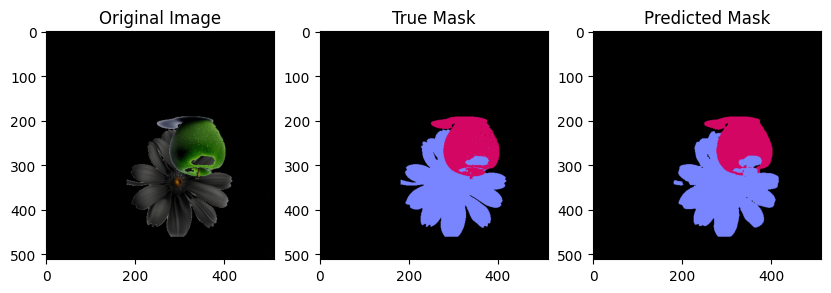

image301 IOU_apple: 0.909576440916846
image301 IOU_flower: 0.9432392373509398
image301 IOU_back: 0.9959705533471572


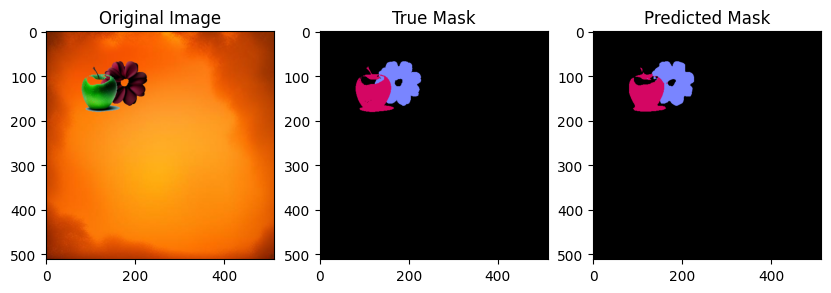

image302 IOU_apple: 0.9323467230443975
image302 IOU_flower: 0.9447450401705197
image302 IOU_back: 0.9979518302285996


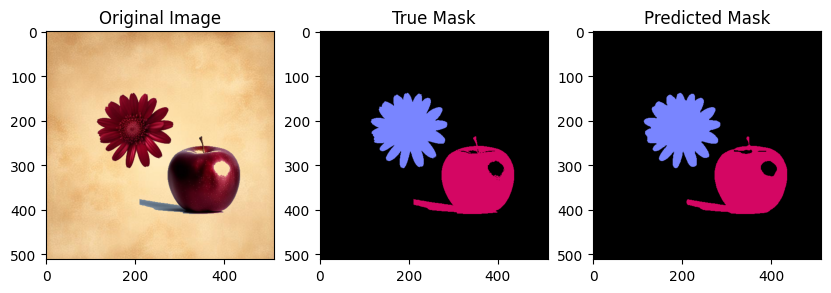

image303 IOU_apple: 0.9825874158783943
image303 IOU_flower: 0.9886627436160449
image303 IOU_back: 0.9973985431841832


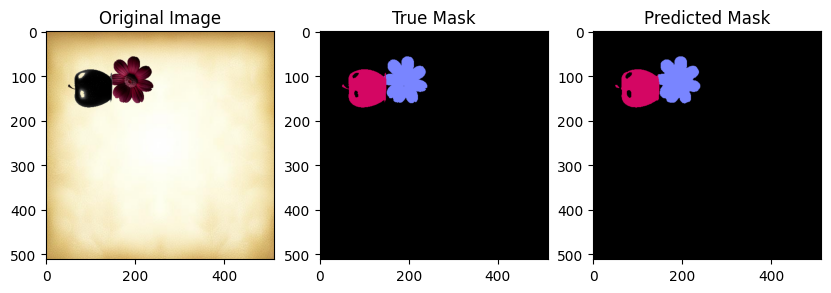

image304 IOU_apple: 0.9725292587776333
image304 IOU_flower: 0.9822774211554564
image304 IOU_back: 0.9990044079037166


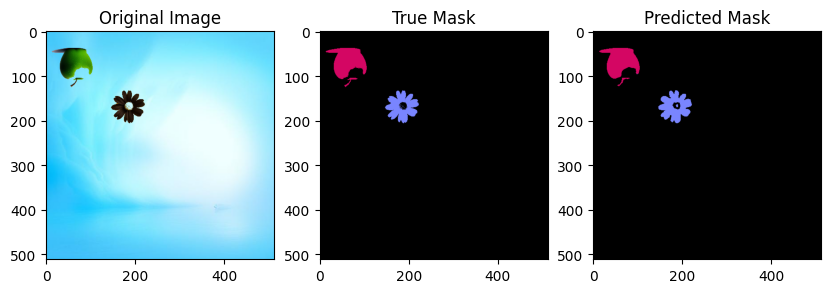

image305 IOU_apple: 0.9608335425558624
image305 IOU_flower: 0.9331526648599819
image305 IOU_back: 0.9985345746348191


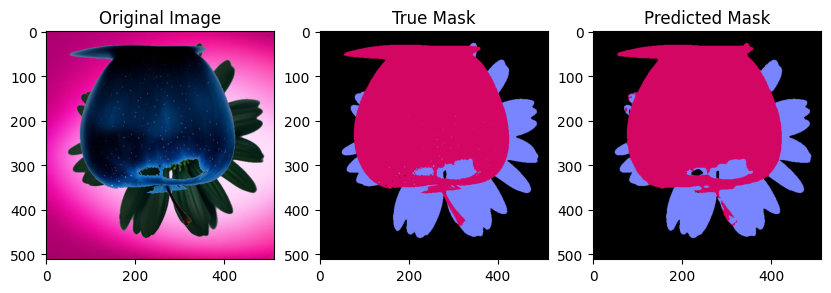

image306 IOU_apple: 0.9789061593170618
image306 IOU_flower: 0.9392727451172833
image306 IOU_back: 0.9932710974298686


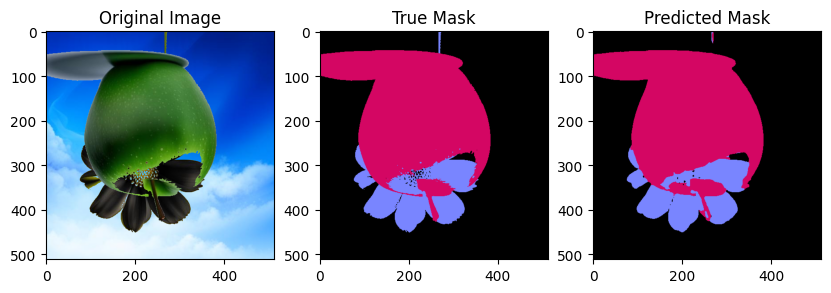

image307 IOU_apple: 0.9648944576137262
image307 IOU_flower: 0.8709982328525049
image307 IOU_back: 0.992909381148606


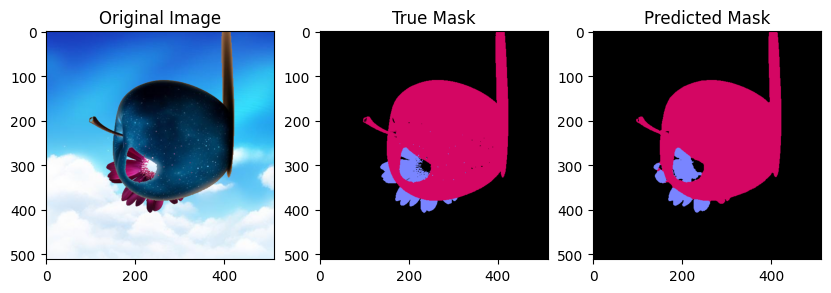

image308 IOU_apple: 0.9874424646769201
image308 IOU_flower: 0.8479192166462668
image308 IOU_back: 0.9956775148537242


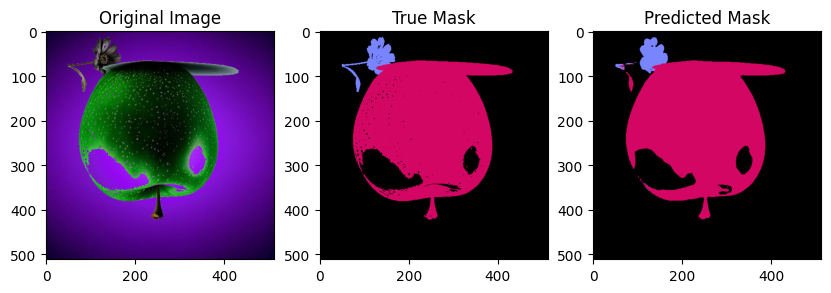

image309 IOU_apple: 0.9685613021790496
image309 IOU_flower: 0.7766164316966456
image309 IOU_back: 0.9866622640590238


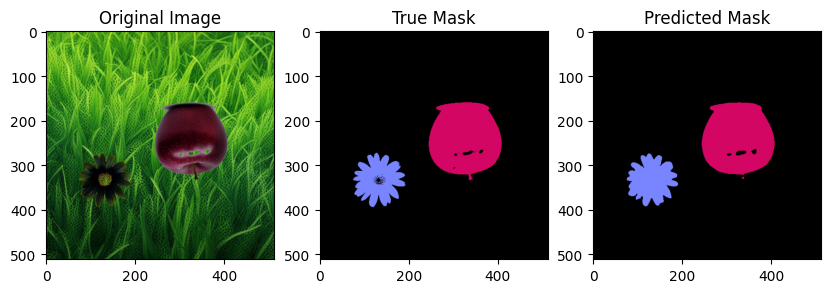

image310 IOU_apple: 0.9828224835632929
image310 IOU_flower: 0.9280456992200373
image310 IOU_back: 0.9955865083086347


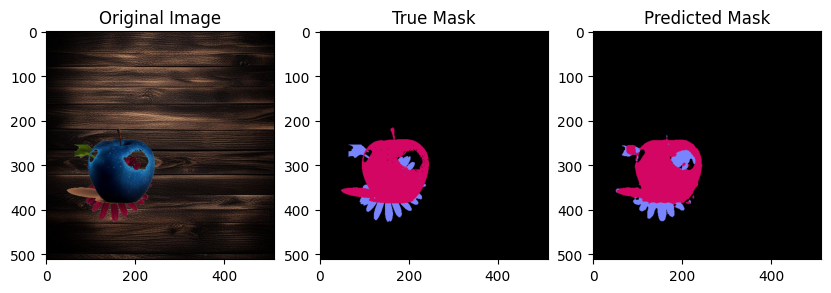

image311 IOU_apple: 0.9221507953802571
image311 IOU_flower: 0.5623570800351803
image311 IOU_back: 0.9910632456798776


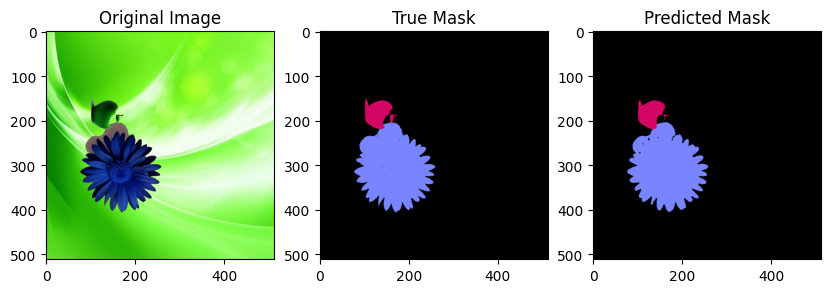

image312 IOU_apple: 0.9217046580773043
image312 IOU_flower: 0.9813274486504838
image312 IOU_back: 0.9973201585043691


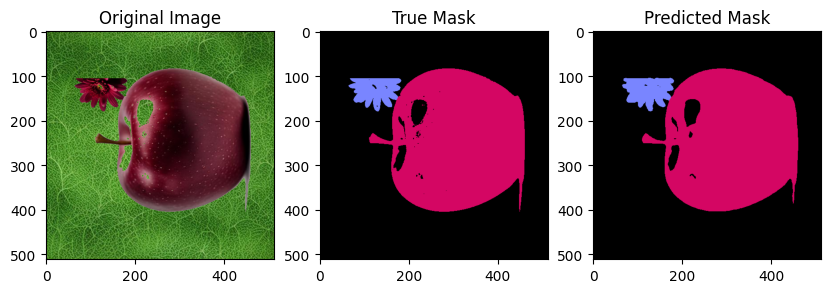

image313 IOU_apple: 0.9871687904530745
image313 IOU_flower: 0.9508928571428571
image313 IOU_back: 0.992652955923344


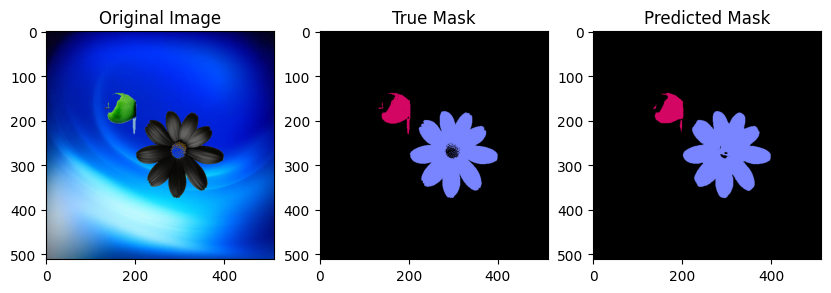

image314 IOU_apple: 0.9125230202578268
image314 IOU_flower: 0.9660612070131158
image314 IOU_back: 0.9956338306616135


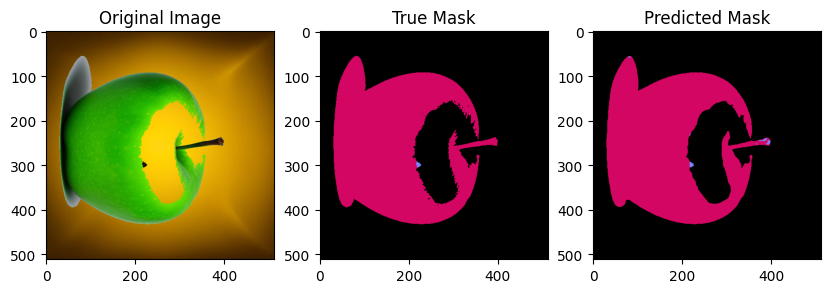

image315 IOU_apple: 0.9847018460199196
image315 IOU_flower: 0.32270916334661354
image315 IOU_back: 0.9943293005957208


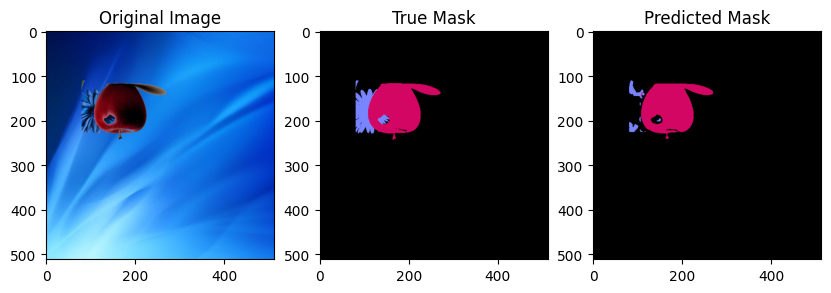

image316 IOU_apple: 0.9751615339431065
image316 IOU_flower: 0.1701599558742416
image316 IOU_back: 0.9872203321993196


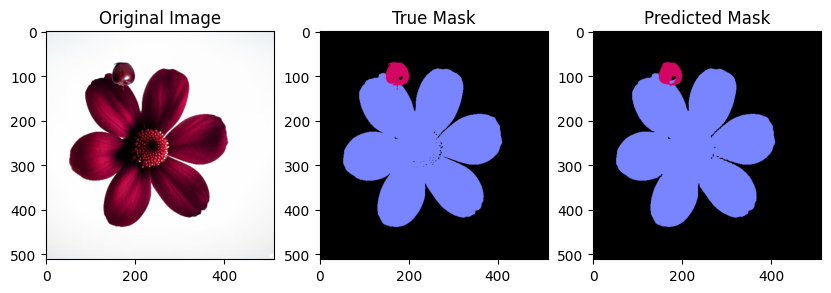

image317 IOU_apple: 0.9227990970654627
image317 IOU_flower: 0.9935524414001131
image317 IOU_back: 0.9975459851432614


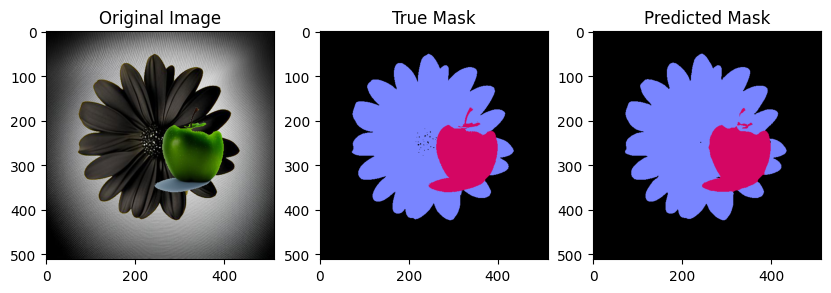

image318 IOU_apple: 0.9696187683284457
image318 IOU_flower: 0.9859120487983807
image318 IOU_back: 0.9967833545844442


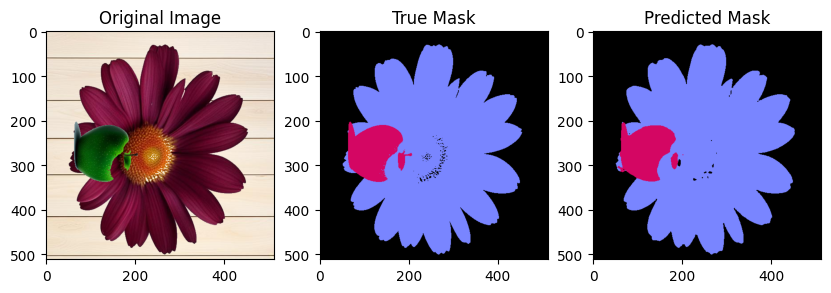

image319 IOU_apple: 0.9552815454171805
image319 IOU_flower: 0.9855047244505543
image319 IOU_back: 0.9914578670996241


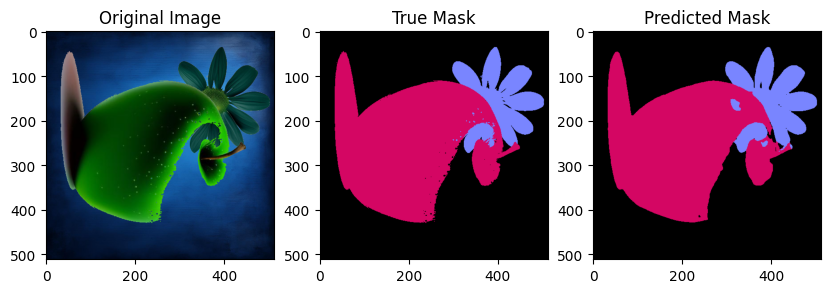

image320 IOU_apple: 0.9724710252250981
image320 IOU_flower: 0.9285938833251
image320 IOU_back: 0.9885080069763754


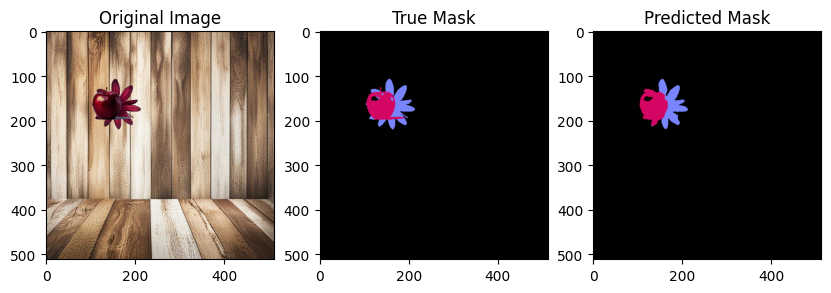

image321 IOU_apple: 0.8107822410147991
image321 IOU_flower: 0.7658417187924939
image321 IOU_back: 0.9987208324368729


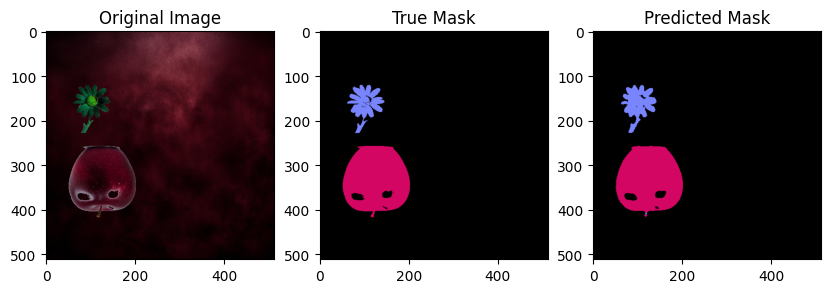

image322 IOU_apple: 0.9819128681823273
image322 IOU_flower: 0.879247015610652
image322 IOU_back: 0.9965983286537855


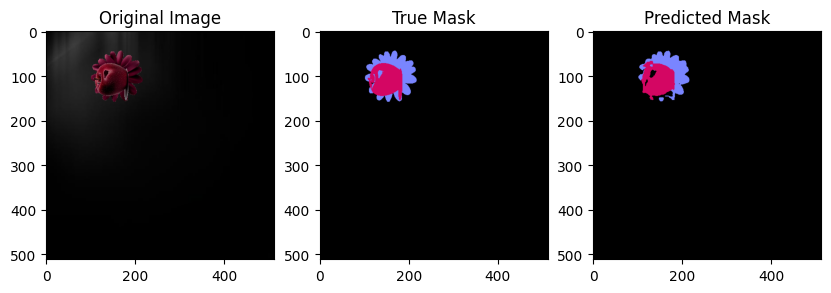

image323 IOU_apple: 0.8340871710526315
image323 IOU_flower: 0.7279647435897436
image323 IOU_back: 0.9967255876998731


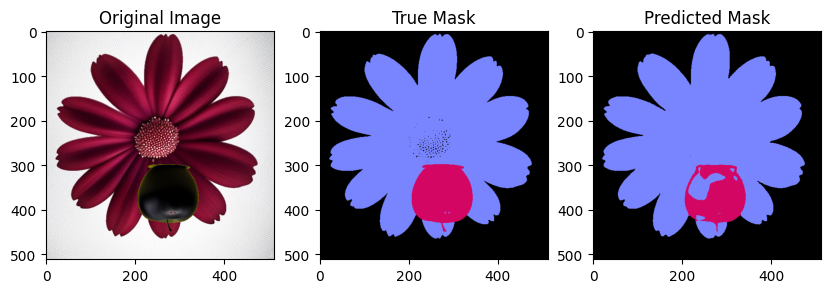

image324 IOU_apple: 0.7812540653050605
image324 IOU_flower: 0.9662312889980925
image324 IOU_back: 0.9934686242454729


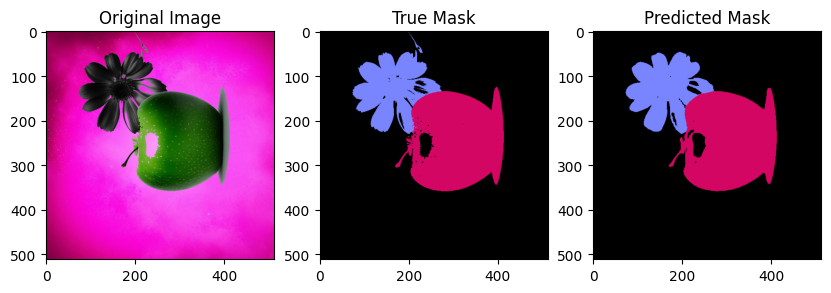

image325 IOU_apple: 0.9812737832966153
image325 IOU_flower: 0.9484635391580772
image325 IOU_back: 0.9920847054653927


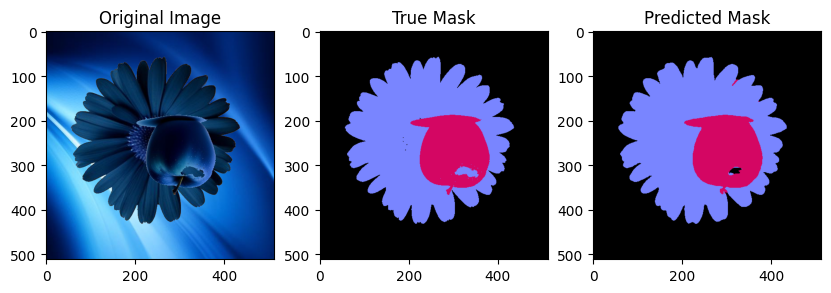

image326 IOU_apple: 0.9606317235065233
image326 IOU_flower: 0.9774338795505262
image326 IOU_back: 0.9939586301419271


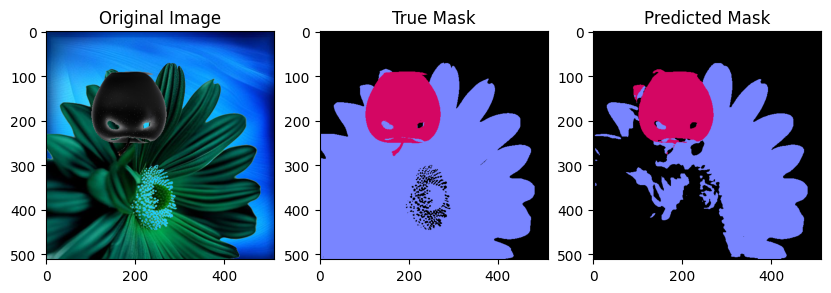

image327 IOU_apple: 0.9345235515881614
image327 IOU_flower: 0.5656710057870211
image327 IOU_back: 0.6027480080441922


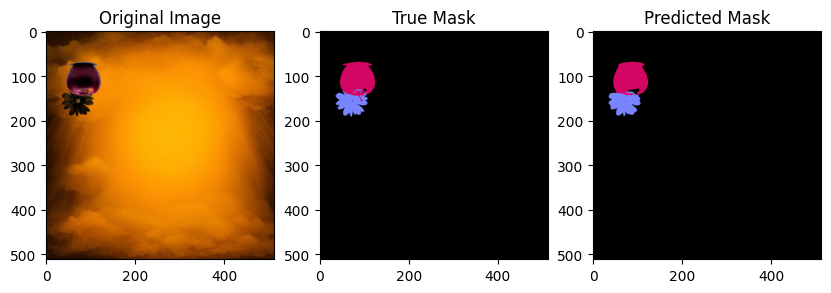

image328 IOU_apple: 0.920502940580004
image328 IOU_flower: 0.8650519031141869
image328 IOU_back: 0.9985014024832781


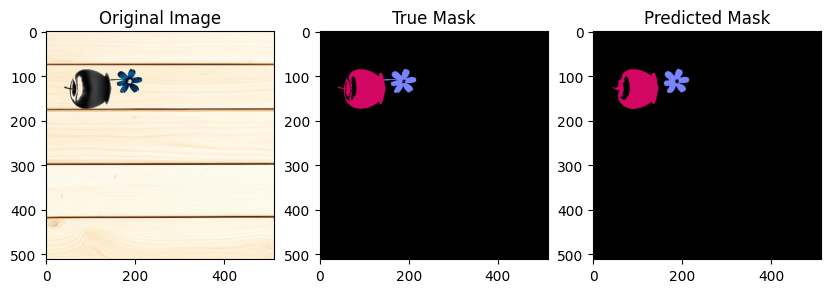

image329 IOU_apple: 0.9271533781620237
image329 IOU_flower: 0.9105820105820106
image329 IOU_back: 0.9975729394530867


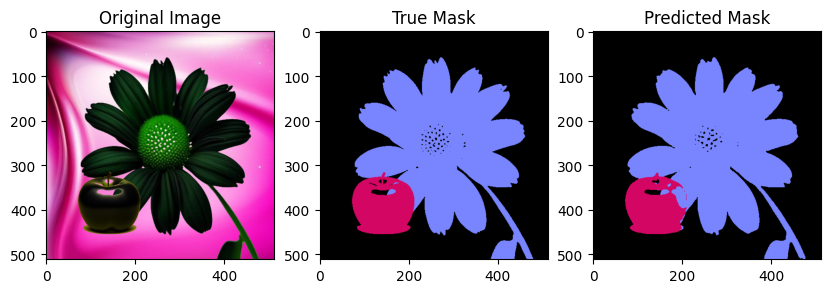

image330 IOU_apple: 0.8976750473100839
image330 IOU_flower: 0.9753475811725986
image330 IOU_back: 0.9921141036966348


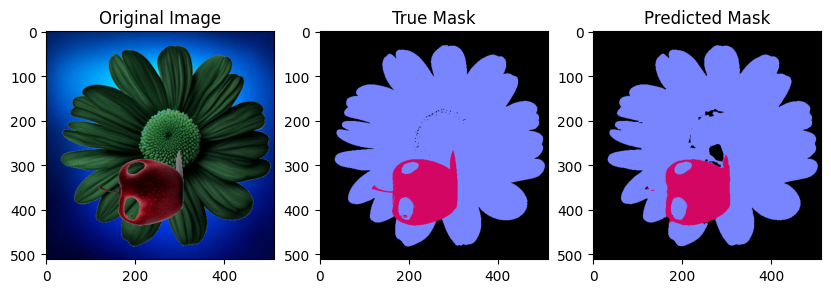

image331 IOU_apple: 0.9499942455978824
image331 IOU_flower: 0.9779434630583346
image331 IOU_back: 0.9818834638057673


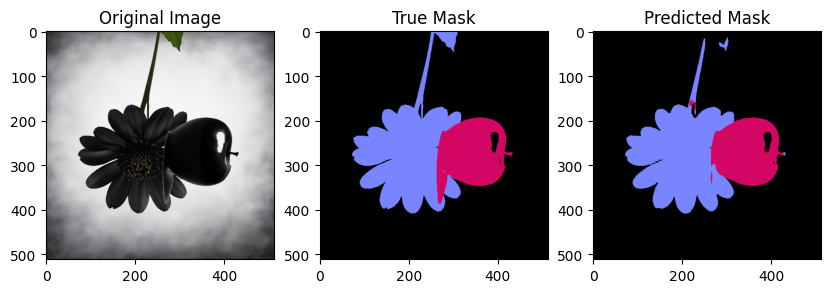

image332 IOU_apple: 0.9088591459528362
image332 IOU_flower: 0.9200415613856944
image332 IOU_back: 0.99115414941849

 MIOU_apple: 0.9370755266944885

 MIOU_flower: 0.8966785768669878

 MIOU_back: 0.9924720633148475

 MIOU for all classes: 0.9420753889587745


In [20]:
arr_apple, arr_flower, arr_back = [], [], []

IOU_sum_apple = 0
IOU_sum_flower = 0
IOU_sum_back = 0

def claculate_IOU(true_mask, pred_mask, color):
    TP = 0 
    FP = 0
    FN = 0
    for k in range(true_mask.shape[0]):
        for l in range(true_mask.shape[1]):
            if (list(true_mask[k, l]) == color) and (list(pred_mask[k, l]) == color): 
                TP+=1
            elif (list(true_mask[k, l]) != color) and (list(pred_mask[k, l]) == color): 
                FP+=1
            elif (list(true_mask[k, l]) == color) and (list(pred_mask[k, l]) != color): 
                FN+=1

    if TP+FP+FN == 0: IOU = 1
    else: IOU = TP/(TP+FP+FN) 
    if IOU == 0: IOU = 1
    return IOU
    
for i in range(NUM_TEST_IMAGES):
    img = cv2.imread(test_images[i])
    true_mask = cv2.imread(mask_color[i])
    pred_mask = cv2.imread(test_pred[i])

    IOU_apple = claculate_IOU(true_mask, pred_mask, [99, 6, 212])
    IOU_flower = claculate_IOU(true_mask, pred_mask, [255, 133, 121])
    IOU_back = claculate_IOU(true_mask, pred_mask, [0, 0, 0])
    
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    true_mask = cv2.cvtColor(true_mask, cv2.COLOR_BGR2RGB)
    pred_mask = cv2.cvtColor(pred_mask, cv2.COLOR_BGR2RGB)
    fig, axs = plt.subplots(1, 3, figsize=(10, 5))
    axs[0].imshow(img)
    axs[0].set_title('Original Image')
    axs[1].imshow(true_mask)
    axs[1].set_title('True Mask')
    axs[2].imshow(pred_mask)
    axs[2].set_title('Predicted Mask')
    plt.show()
    
    print(f"image{i} IOU_apple: {IOU_apple}")
    print(f"image{i} IOU_flower: {IOU_flower}")
    print(f"image{i} IOU_back: {IOU_back}")

    arr_apple.append(IOU_apple)
    arr_flower.append(IOU_flower)
    arr_back.append(IOU_back)
    IOU_sum_apple += IOU_apple
    IOU_sum_flower += IOU_flower
    IOU_sum_back += IOU_back

MIOU_apple_train = IOU_sum_apple / NUM_TEST_IMAGES
MIOU_flower_train = IOU_sum_flower / NUM_TEST_IMAGES
MIOU_back_train = IOU_sum_back / NUM_TEST_IMAGES
print(f"\n MIOU_apple: {MIOU_apple_train}")
print(f"\n MIOU_flower: {MIOU_flower_train}")
print(f"\n MIOU_back: {MIOU_back_train}")
print(f"\n MIOU for all classes: {(MIOU_apple_train+MIOU_flower_train+MIOU_back_train)/3}")

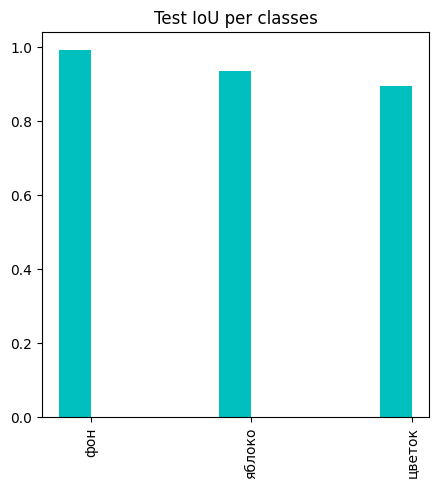

IOU фон: 0.9924720633148475, IOU яблоко: 0.9370755266944885, IOU цветок: 0.8966785768669878


In [21]:
suma = 0
sumf = 0
sumb = 0
for i in range(NUM_TEST_IMAGES):
    suma += arr_apple[i]
    sumf += arr_flower[i]
    sumb += arr_back[i]


values = [sumb/NUM_TEST_IMAGES, suma/NUM_TEST_IMAGES, sumf/NUM_TEST_IMAGES]
x_axis = np.arange(len(CLASSES))
plt.figure(figsize = (5, 5))
plt.title('Test IoU per classes')
plt.bar(x_axis-0.1, values, width=0.2, color='c')
plt.xticks(x_axis, CLASSES, rotation=90)
plt.show()

print(f"IOU фон: {sumb/NUM_TEST_IMAGES}, IOU яблоко: {suma/NUM_TEST_IMAGES}, IOU цветок: {sumf/NUM_TEST_IMAGES}")

In [ ]:
oimg = sorted(glob(os.path.join(DATA_DIR, "img_test/*")))
mtrue = sorted(glob(os.path.join(DATA_DIR, "mask_true/*")))
mpred = sorted(glob(os.path.join(DATA_DIR, "mask_predict/*")))

In [ ]:
arr_apple, arr_flower, arr_back = [], [], []

IOU_sum_apple = 0
IOU_sum_flower = 0
IOU_sum_back = 0

def claculate_IOU(true_mask, pred_mask, color):
    TP = 0 
    FP = 0
    FN = 0
    for k in range(true_mask.shape[0]):
        for l in range(true_mask.shape[1]):
            if (list(true_mask[k, l]) == color) and (list(pred_mask[k, l]) == color): 
                TP+=1
            elif (list(true_mask[k, l]) != color) and (list(pred_mask[k, l]) == color): 
                FP+=1
            elif (list(true_mask[k, l]) == color) and (list(pred_mask[k, l]) != color): 
                FN+=1

    if TP+FP+FN == 0: IOU = 1
    else: IOU = TP/(TP+FP+FN) 
    if IOU == 0: IOU = 1
    return IOU
    
for i in range(len(oimg)):
    img = cv2.imread(oimg[i])
    true_mask = cv2.imread(mtrue[i])
    pred_mask = cv2.imread(mpred[i])

    IOU_apple = claculate_IOU(true_mask, pred_mask, [99, 6, 212])
    IOU_flower = claculate_IOU(true_mask, pred_mask, [255, 133, 121])
    IOU_back = claculate_IOU(true_mask, pred_mask, [0, 0, 0])
    
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    true_mask = cv2.cvtColor(true_mask, cv2.COLOR_BGR2RGB)
    pred_mask = cv2.cvtColor(pred_mask, cv2.COLOR_BGR2RGB)
    fig, axs = plt.subplots(1, 3, figsize=(10, 5))
    axs[0].imshow(img)
    axs[0].set_title('Original Image')
    axs[1].imshow(true_mask)
    axs[1].set_title('True Mask')
    axs[2].imshow(pred_mask)
    axs[2].set_title('Predicted Mask')
    plt.show()
    
    print(f"image{i} IOU_apple: {IOU_apple}")
    print(f"image{i} IOU_flower: {IOU_flower}")
    print(f"image{i} IOU_back: {IOU_back}")

    arr_apple.append(IOU_apple)
    arr_flower.append(IOU_flower)
    arr_back.append(IOU_back)
    IOU_sum_apple += IOU_apple
    IOU_sum_flower += IOU_flower
    IOU_sum_back += IOU_back

MIOU_apple_train = IOU_sum_apple / NUM_TEST_IMAGES
MIOU_flower_train = IOU_sum_flower / NUM_TEST_IMAGES
MIOU_back_train = IOU_sum_back / NUM_TEST_IMAGES
print(f"\n MIOU_apple: {MIOU_apple_train}")
print(f"\n MIOU_flower: {MIOU_flower_train}")
print(f"\n MIOU_back: {MIOU_back_train}")
print(f"\n MIOU for all classes: {(MIOU_apple_train+MIOU_flower_train+MIOU_back_train)/3}")

In [ ]:
suma = 0
sumf = 0
sumb = 0
for i in range(9):
    suma += arr_apple[i]
    sumf += arr_flower[i]
    sumb += arr_back[i]


values = [sumb/9, suma/9, sumf/9]
x_axis = np.arange(len(CLASSES))
plt.figure(figsize = (5, 5))
plt.title('Test IoU per classes')
plt.bar(x_axis-0.1, values, width=0.2, color='c')
plt.xticks(x_axis, CLASSES, rotation=90)
plt.show()

print(f"IOU фон: {sumb/9}, IOU яблоко: {suma/9}, IOU цветок: {sumf/9}")